In [484]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random
from collections import defaultdict
import nltk
from sklearn.preprocessing import StandardScaler
from nltk.stem import WordNetLemmatizer
from nltk.stem.snowball import SnowballStemmer
from wordcloud import WordCloud
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import confusion_matrix, precision_score, recall_score, accuracy_score
sns.set()
sns.set_style(style='whitegrid')

# Préparation des données

In [485]:
text = pd.read_csv('flipkart_com-ecommerce_sample_1050.csv')

In [486]:
text.describe()

,retail_price,discounted_price
count,1049.000000,1049.000000
mean,2186.197331,1584.527169
std,7639.229411,7475.099680
min,35.000000,35.000000
25%,555.000000,340.000000
50%,999.000000,600.000000
75%,1999.000000,1199.000000
max,201000.000000,201000.000000


## Valeurs nulles

In [487]:
text.isna().sum()

uniq_id                      0
crawl_timestamp              0
product_url                  0
product_name                 0
product_category_tree        0
pid                          0
retail_price                 1
discounted_price             1
image                        0
is_FK_Advantage_product      0
description                  0
product_rating               0
overall_rating               0
brand                      338
product_specifications       1
dtype: int64

## Doublons

In [488]:
text.duplicated().sum()

0

In [489]:
text.duplicated(subset='product_category_tree').sum()

408

In [490]:
text.duplicated(subset='product_name').sum()

0

In [491]:
text.columns

Index(['uniq_id', 'crawl_timestamp', 'product_url', 'product_name',
       'product_category_tree', 'pid', 'retail_price', 'discounted_price',
       'image', 'is_FK_Advantage_product', 'description', 'product_rating',
       'overall_rating', 'brand', 'product_specifications'],
      dtype='object')

In [492]:
text.describe(include=object)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,image,description,product_rating,overall_rating,brand,product_specifications
count,1050,1050,1050,1050,1050,1050,1050,1050,1050,1050,712,1049
unique,1050,149,1050,1050,642,1050,1050,1050,27,27,490,984
top,55b85ea15a1536d46b7190ad6fff8ce7,2015-12-01 12:40:44 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Bed Linen >> Blankets, Qu...",CRNEG7BKMFFYHQ8Z,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,PRINT SHAPES,"{""product_specification""=>[{""key""=>""Type"", ""va..."
freq,1,150,1,1,56,1,1,1,889,889,11,22


## Analyse univariée

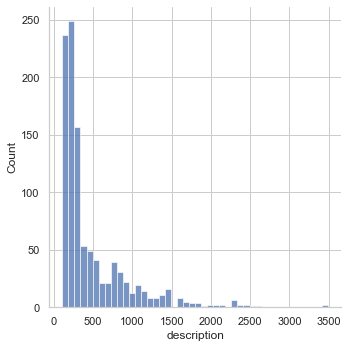

In [493]:
length_descrition = text['description'].apply(lambda x: len(x))
sns.displot(length_descrition)

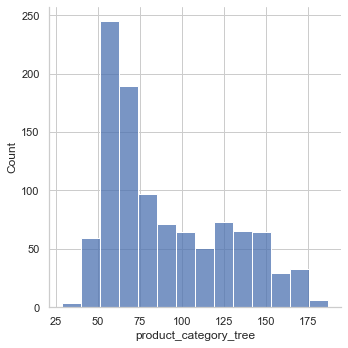

In [494]:
length_descrition = text['product_category_tree'].apply(lambda x: len(x))
sns.displot(length_descrition)

In [495]:
def sample(data, nb, col):
    """
    Return 
    number = nb random value 
    of column = col 
    from dataframe = data 
    
    """
    idx = [random.randint(0, len(data)) for i in range(nb)]
    for i in range(len(idx)):
        column = data.iloc[idx[i], :][col]
        print(f"{idx[i]} :\n {column} \n\n")

In [497]:
sample(text, 3, 'description')

399 :
 Buy D-Link DSL-2520U only for Rs. 1449 from Flipkart.com. Only Genuine Products. 30 Day Replacement Guarantee. Free Shipping. Cash On Delivery! 


785 :
 Flipkart.com is offering Small Funcart Frolic Birthday  - Food Grade Plastic for only for Rs 154 | Flipkart.com. Only Genuine Products. Free Shipping. Cash On Delivery! 


1004 :
 Specifications of Doraemon Gift Family Ceramic Coffee Mug Multicolour Mug - 325 ml In The Box Sales Package Ceramic Coffee Mug General Type Mug Size in Number 9 inch Size Small 




In [498]:
sample(text, 3, 'product_category_tree')

227 :
 ["Home Decor & Festive Needs >> Showpieces >> Ethnic >> Rajo Raja Ethnic"] 


123 :
 ["Home Decor & Festive Needs >> Wall Decor & Clocks >> Key Holders >> Craftcart Key Holders >> Craftcart Parrot Antique Brass Key Holder (5 Hoo..."] 


956 :
 ["Kitchen & Dining >> Tableware & Cutlery >> Cutlery >> Forks >> Bhalaria Forks >> Bhalaria Dessert Fork Stainless Steel Dessert Fo..."] 




## Category
### Fonctions
#### Stopwords

In [499]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /Users/aleth/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [500]:
def stop_words_lemmatzed(liste):
    wnl = WordNetLemmatizer()
    stopwords = [lemmatizer.lemmatize(w) for w in liste]
    return stopwords   

In [501]:
def stop_words_language(liste, language):
    stopwords = liste
    stopwords += list(nltk.corpus.stopwords.words(language))
    return stopwords 

In [502]:
stopwords_description = stop_words_language([], 'english')
len(stopwords_description)

179

#### Wordscloud

In [510]:
def makeImage(dictionnary, height, width):
    """
    Représentation des keys de text de taille proportionnelle à values de dictionnary
    """

    wc = WordCloud(background_color="white", max_words=10000)
    # generate word cloud
    wc.generate_from_frequencies(dictionnary)

    # show
    fig, ax = plt.subplots(figsize=(height, width))
    ax.imshow(wc, interpolation="bilinear")
    ax.axis("off")
    

#### Transform category

In [504]:
# fonction pour récupérer les différents niveaux de catégorie
def transform_category(dictionnary, separation):
    """
    Lower, replace separation by a punkt, tokenize
    
    Positionnal argument:
    ---------------------------
    dictionnary : dict: keys=identity, values=texts to process
    separation : str or value to be replaced by a punkt
    
    Return:
    ---------------------------
    categories : DataFrame with 3 columns = keys, category1, category2
    """
    
    tokenizer_sent = nltk.PunktSentenceTokenizer()
    tokenizer_word = nltk.RegexpTokenizer(r'\w+')
    corpora = defaultdict(list)
    for identity,text in dictionnary.items():
        text = text.replace(separation, '.')
        tokens  = tokenizer_sent.tokenize(text.lower())
        corpora[identity] += [s for s in tokens]
    category1 = []
    category2 = []
    for i in corpora.keys():
        category1 += [corpora[i][0]]
    categories = pd.DataFrame(index=corpora.keys(), data=category1).rename(columns={0: 'category1'})
    categories['category1'] = categories['category1'].apply(lambda x: ' '.join(tokenizer_word.tokenize(x)))
    categories = categories.reset_index().rename(columns={'index': 'uniq_id'})
    for i in corpora.keys():
        category2 += [corpora[i][1]]
    categories['category2'] = category2
    categories['category2'] = categories['category2'].apply(lambda x: ' '.join(tokenizer_word.tokenize(x)))
        
    return categories

### Categories

In [505]:
categories = transform_category(category_dict, '>>')

In [506]:
categories

,uniq_id,category1,category2
0,55b85ea15a1536d46b7190ad6fff8ce7,home furnishing,curtains accessories
1,7b72c92c2f6c40268628ec5f14c6d590,baby care,baby bath skin
2,64d5d4a258243731dc7bbb1eef49ad74,baby care,baby bath skin
3,d4684dcdc759dd9cdf41504698d737d8,home furnishing,bed linen
4,6325b6870c54cd47be6ebfbffa620ec7,home furnishing,bed linen
...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc,baby care,baby kids gifts
1046,fd6cbcc22efb6b761bd564c28928483c,baby care,baby kids gifts
1047,5912e037d12774bb73a2048f35a00009,baby care,baby kids gifts
1048,c3edc504d1b4f0ba6224fa53a43a7ad6,baby care,baby kids gifts


In [507]:
categories['category1'].unique().shape

(7,)

In [508]:
categories['category2'].unique().shape

(62,)

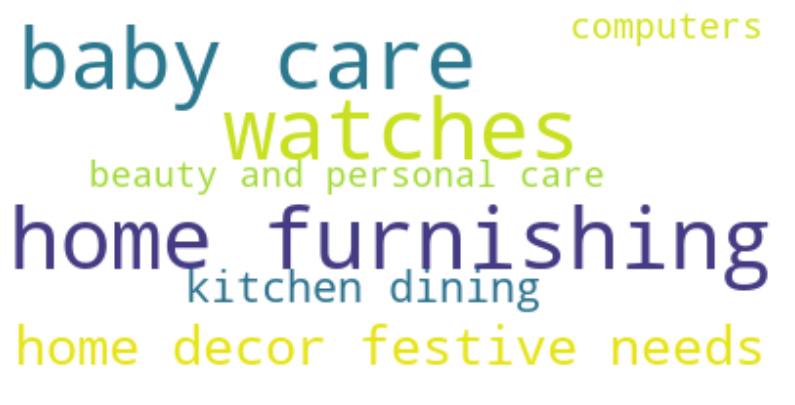

In [512]:
makeImage(categories['category1'].value_counts().to_dict(), 14, 14)

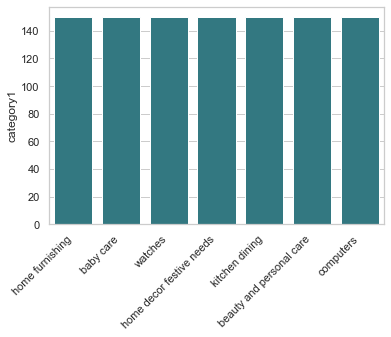

In [39]:
palette = sns.color_palette("viridis", 8)
fig, ax = plt.subplots(figsize=(6,  4))
sns.barplot(ax= ax, x=categories['category1'].unique(), y=categories['category1'].value_counts(), color=palette[3])
ax.set_xticklabels(labels=categories['category1'].unique(), rotation=45, ha='right', va='top');

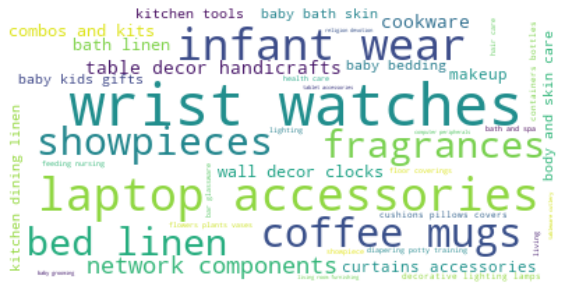

In [515]:
makeImage(categories['category2'].value_counts().to_dict(), 10, 10)

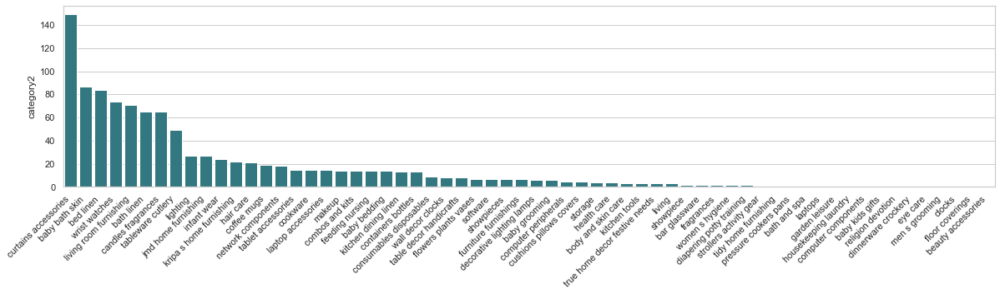

In [41]:
fig, ax = plt.subplots(figsize=(20, 4))
sns.barplot(ax= ax, x=categories['category2'].unique(), y=categories['category2'].value_counts(), color=palette[3])
ax.set_xticklabels(labels=categories['category2'].unique(), rotation=45, ha='right', va='top');

In [42]:
categories['category2'].value_counts()

wrist watches                    149
laptop accessories                87
infant wear                       84
coffee mugs                       74
showpieces                        71
                                ... 
consumables disposables            1
true home decor festive needs      1
jmd home furnishing                1
kripa s home furnishing            1
beauty accessories                 1
Name: category2, Length: 62, dtype: int64

# Bags of words
## Fonctions
### Fonction transformation du texte

In [67]:
def transform_text(text, stopwords=None, len_words=2, lemm_or_stemm ='lemm', not_a_number=True, stopwords_complement=None):
    """
    Transform document
    Lower, exclude stopwords, exclude words smaller than len_words letters, lemmanize or stemmatize, 
    exclude number if not_a_number=True, exclude stopwords_complement
    
    Positionnal argument:
    ---------------------------
    text : str: text to process
    
    Opt args :
    ---------------------------
    stopwords : list : list of words to exclude
    len_words : int : length mini of a word to be kept
    not_a_number : bool : if True, exclude numbers
    stopwords_complement : list : list of complement words to exclude
    
    Return:
    ---------------------------
    text_alpha : list = text transformed
    """
    tokenizer = nltk.RegexpTokenizer(r'\w+')
    lemmatizer = WordNetLemmatizer()
    stemmer = SnowballStemmer('english')
    if stopwords==None:
        stopwords = []
    text_tokenized  = tokenizer.tokenize(text.lower())
    text_stopped = [w for w in text_tokenized if not w in stopwords]
    if lemm_or_stemm == 'lemm':
        text_transformed = [lemmatizer.lemmatize(w) for w in text_stopped]
    elif lemm_or_stemm == 'stemm':
        text_transformed = [stemmer.stem(w) for w in text_stopped]
    else:
        text_transformed = [w for w in text_stopped]
    text_filtered = [w for w in text_transformed if len(w)>len_words]
    text_filtered = [w for w in text_filtered if not w in stopwords_complement]
    if not_a_number:
        text_filtered = [w for w in text_filtered if w.isalpha()]
        
    return text_filtered

In [559]:
test1 = "I'd like to check if my function is OK. If not, I will try, try, try and try again with 200 or 300 other sentences and strange words like hnuaiog§§77 to understand the problem."
transform_text(test1, stopwords=None, lemm_or_stemm ='lemm', not_a_number=True, stopwords_complement=['check','again'])

['like',
 'function',
 'not',
 'will',
 'try',
 'try',
 'try',
 'and',
 'try',
 'with',
 'other',
 'sentence',
 'and',
 'strange',
 'word',
 'like',
 'hnuaiog',
 'understand',
 'the',
 'problem']

### Fonction Countvectorizer

In [69]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

In [70]:
def ordered_list(dict):
    columns = [0 for i in range(len(dict))]
    for w, i in dict.items():
        columns[i] = w
    return columns  

In [71]:
def countvectorise_text(document, stopwords, len_words, lemm_or_stemm, not_a_number, stopwords_complement):
    """
     1 - Transform document
    Lower, exclude stopwords, exclude words smaller than len_words letters, lemmanize or stemmatize, 
    exclude number if not_a_number=True, exclude stopwords_complement
    
    2 - CountVectorize document transformed
    
    Positionnal argument:
    ---------------------------
    document : list or serie of texts : list of texts to process
    stopwords : list : list of words to exclude
    len_words : int : length mini of a word to be kept
    lemm_or_stemm : 'stemm' or 'lemm'
    not_a_number : bool : if True, exclude numbers
    stopwords_complement : list : list of complement words to exclude
    
    Return:
    ---------------------------
    df : dataframe : columns = words
                   rows = texts in document
                   values = number of words in text
    frequence : Serie : index = words
                        values = number of words in document
    """
    
    def transform(text):
        text_transformed = transform_text(text, 
                                          stopwords=stopwords, 
                                          len_words=len_words, 
                                          lemm_or_stemm =lemm_or_stemm, 
                                          not_a_number=not_a_number, 
                                          stopwords_complement=stopwords_complement)
        return text_transformed
    cvect = CountVectorizer(tokenizer=transform)
    cv_fit = cvect.fit(document)
    cv_transform = cvect.transform(document)
    columns_cv = ordered_list(cvect.vocabulary_)
    df = pd.DataFrame(columns=columns_cv, data=cv_transform.toarray())
    frequence = df.sum(axis=0)
    return df, frequence

In [72]:
def countvectorise_text_fmin(document, stopwords, len_words, lemm_or_stemm, not_a_number, stopwords_complement, freq_min):
    """
     1 - Transform document
    Lower, exclude stopwords, exclude words smaller than len_words letters, lemmanize or stemmatize, 
    exclude number if not_a_number=True, exclude stopwords_complement, exclude words if frequence lower than freq_min
    
    2 - CountVectorize document transformed
    
    Positionnal argument:
    ---------------------------
    document : list or serie of texts : list of texts to process
    stopwords : list : list of words to exclude
    len_words : int : length mini of a word to be kept
    lemm_or_stemm : 'stemm' or 'lemm'
    not_a_number : bool : if True, exclude numbers
    stopwords_complement : list : list of complement words to exclude
    freq_min : int : exclude word if freq < freq_min
    
    Return:
    ---------------------------
    df : dataframe : columns = words
                   rows = texts in document
                   values = number of words in text
    frequence : Serie : index = words
                        values = number of words in document
    """
        

    def transform(text):
        text_transformed = transform_text(text, 
                                          stopwords=stopwords, 
                                          len_words=len_words, 
                                          lemm_or_stemm =lemm_or_stemm, 
                                          not_a_number=not_a_number, 
                                          stopwords_complement=stopwords_complement)
        return text_transformed
    
    cvect = CountVectorizer(tokenizer=transform)
    cv_fit = cvect.fit(document)
    cv_transform = cvect.transform(document)
    columns_cv = ordered_list(cvect.vocabulary_)
    df = pd.DataFrame(columns=columns_cv, data=cv_transform.toarray())
    frequence = df.sum(axis=0)
    mask = frequence<freq_min
    rare_words = list(frequence[mask].index)
    other_words = list(frequence[~mask].index)
    df1 = df.loc[:, other_words]
    frequence1 = df1.sum(axis=0)
    return df1, frequence1

In [73]:
# Test de la fonction countvectorise_text sur une phrase
test2 = ["I'd like to check if my function is OK. If not, I will try, try, try and try again with 2 or 3 other sentences and strange words like hnuaiog§§77 to understand the problem.",
        "Another sentence because I'd like to test again.",
        "And here I'de like to try a completely different topic to give more vocabulary and see again."]

In [74]:
stopwords_base = stop_words_language([], 'english')
stopwords_complement0 = ['check', 'the']
CountVect_test2, frequence_test2 = countvectorise_text(test2, stopwords_base, 2, 'stemm', True, stopwords_complement0)
CountVect_test2

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


,anoth,complet,differ,function,give,hnuaiog,like,problem,see,sentenc,strang,test,topic,tri,understand,vocabulari,word
0,0,0,0,1,0,1,2,1,0,1,1,0,0,4,1,0,1
1,1,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0
2,0,1,1,0,1,0,1,0,1,0,0,0,1,1,0,1,0


In [75]:
frequence_test2

anoth         1
complet       1
differ        1
function      1
give          1
hnuaiog       1
like          4
problem       1
see           1
sentenc       2
strang        1
test          1
topic         1
tri           5
understand    1
vocabulari    1
word          1
dtype: int64

In [76]:
# Test de la fonction countvectorise_text_fmin sur une phrase
CountVect_test20, frequence_test20 = countvectorise_text_fmin(test2, stopwords_base, 2, 'stemm', True, ['sentenc'], 2)
CountVect_test20

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


,like,tri
0,2,4
1,1,0
2,1,1


In [77]:
frequence_test20

like    4
tri     5
dtype: int64

### Fonction tfidfvectorizer_text

In [78]:
def tfidfvectorizer_text(document, stopwords, len_words, lemm_or_stemm, not_a_number, stopwords_complement):
    """
     1 - Transform document
    Lower, exclude stopwords, exclude words smaller than len_words letters, lemmanize or stemmatize, 
    exclude number if not_a_number=True, exclude stopwords_complement
    
    2 - TfidfVectorize document transformed
    
    Positionnal argument:
    ---------------------------
    document : list or serie of texts : list of texts to process
    stopwords : list : list of words to exclude
    len_words : int : length mini of a word to be kept
    lemm_or_stemm : 'stemm' or 'lemm'
    not_a_number : bool : if True, exclude numbers
    stopwords_complement : list : list of complement words to exclude
    
    Return:
    ---------------------------
    df : dataframe : columns = words
                   rows = texts in document
                   values = number of words in text
    frequence : Serie : index = words
                        values = number of words in document
    """
    def transform(text):
        text_transformed = transform_text(text, 
                                          stopwords=stopwords, 
                                          len_words=len_words, 
                                          lemm_or_stemm =lemm_or_stemm, 
                                          not_a_number=not_a_number, 
                                          stopwords_complement=stopwords_complement)
        return text_transformed
    ctf = TfidfVectorizer(tokenizer=transform)
    ctf_fit = ctf.fit(document)
    ctf_transform = ctf.transform(document) 
    columns_ctf = ordered_list(ctf.vocabulary_)
    df = pd.DataFrame(columns=columns_ctf, data=ctf_transform.toarray())
    frequence_pond = df.sum(axis=0)
    return df, frequence_pond

In [79]:
def tfidfvectorizer_text_fmin(document, stopwords, len_words, lemm_or_stemm, not_a_number, stopwords_complement, freq_min):
    """
    1 - Transform document
    Lower, exclude stopwords, exclude words smaller than len_words letters, lemmanize or stemmatize, 
    exclude number if not_a_number=True, exclude stopwords_complement, exclude words if frequence lower than freq_min
    
    2 - TfidfVectorize document transformed
    
    Positionnal argument:
    ---------------------------
    document : list or serie of texts : list of texts to process
    stopwords : list : list of words to exclude
    len_words : int : length mini of a word to be kept
    lemm_or_stemm : 'stemm' or 'lemm'
    not_a_number : bool : if True, exclude numbers
    stopwords_complement : list : list of complement words to exclude
    freq_min : int : exclude word if freq < freq_min
    
    Return:
    ---------------------------
    df : dataframe : columns = words
                   rows = texts in document
                   values = number of words in text
    frequence : Serie : index = words
                        values = number of words in document
    """
    
    def transform(text):
        text_transformed = transform_text(text, 
                                          stopwords=stopwords, 
                                          len_words=len_words, 
                                          lemm_or_stemm =lemm_or_stemm, 
                                          not_a_number=not_a_number, 
                                          stopwords_complement=stopwords_complement)
        return text_transformed
    ctf = TfidfVectorizer(tokenizer=transform)
    ctf_fit = ctf.fit(document)
    ctf_transform = ctf.transform(document) 
    columns_ctf = ordered_list(ctf.vocabulary_)
    df = pd.DataFrame(columns=columns_ctf, data=ctf_transform.toarray())
    frequence_pond = df.sum(axis=0)
    mask = frequence_pond<freq_min
    rare_words = list(frequence_pond[mask].index)
    other_words = list(frequence_pond[~mask].index)
    df1 = df.loc[:, other_words]
    frequence_pond1 = df1.sum(axis=0)
    return df1, frequence_pond1

In [80]:
#Test fonction tfidfvectorizer_text
TfidfVect_test2, frequence_pond_test2 = tfidfvectorizer_text(test2, stopwords_base, 2, 'stemm', True, stopwords_complement0)
TfidfVect_test2

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


,anoth,complet,differ,function,give,hnuaiog,like,problem,see,sentenc,strang,test,topic,tri,understand,vocabulari,word
0,0.000000,0.000000,0.000000,0.240925,0.000000,0.240925,0.284588,0.240925,0.000000,0.183229,0.240925,0.000000,0.000000,0.732918,0.240925,0.000000,0.240925
1,0.584483,0.000000,0.000000,0.000000,0.000000,0.000000,0.345205,0.000000,0.000000,0.444514,0.000000,0.584483,0.000000,0.000000,0.000000,0.000000,0.000000
2,0.000000,0.379945,0.379945,0.000000,0.379945,0.000000,0.224401,0.000000,0.379945,0.000000,0.000000,0.000000,0.379945,0.288958,0.000000,0.379945,0.000000


In [81]:
frequence_pond_test2

anoth         0.584483
complet       0.379945
differ        0.379945
function      0.240925
give          0.379945
hnuaiog       0.240925
like          0.854194
problem       0.240925
see           0.379945
sentenc       0.627744
strang        0.240925
test          0.584483
topic         0.379945
tri           1.021875
understand    0.240925
vocabulari    0.379945
word          0.240925
dtype: float64

In [563]:
#Test fonction tfidfvectorizer_text_fmin
TfidfVect_test20, frequence_pond_test20 = tfidfvectorizer_text_fmin(test2, stopwords_base, 2, 'stemm', True, ['sentenc'], 0.3)
TfidfVect_test20

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


,anoth,complet,differ,give,like,see,test,topic,tri,vocabulari
0,0.000000,0.000000,0.000000,0.000000,0.281168,0.000000,0.000000,0.000000,0.724111,0.000000
1,0.652491,0.000000,0.000000,0.000000,0.385372,0.000000,0.652491,0.000000,0.000000,0.000000
2,0.000000,0.379945,0.379945,0.379945,0.224401,0.379945,0.000000,0.379945,0.288958,0.379945


In [564]:
frequence_pond_test20

anoth         0.652491
complet       0.379945
differ        0.379945
give          0.379945
like          0.890942
see           0.379945
test          0.652491
topic         0.379945
tri           1.013069
vocabulari    0.379945
dtype: float64

### Fonction numerise categories

In [545]:
def numerize(x):
    if x == 'home furnishing':
        x=0
    if x == 'baby care':
        x=1
    if x == 'watches':
        x=2
    if x == 'home decor festive needs':
        x=3
    if x == 'kitchen dining':
        x=4
    if x == 'beauty and personal care':
        x=5
    if x == 'computers':
        x=6
    return x

## Appliqué aux données description
### Visualisation

In [565]:
CountVect0, frequence0 = countvectorise_text_fmin(text['description'], stopwords_base, 2, 'lemm', True, [], 2)
CountVect0.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 3106)

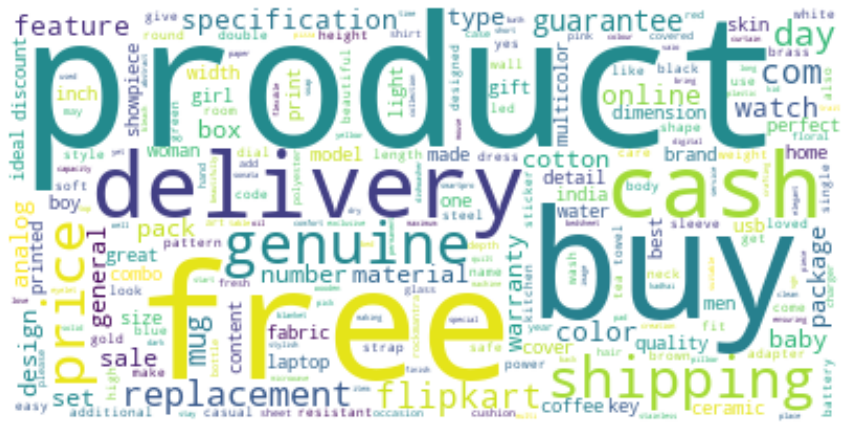

In [566]:
makeImage(frequence0.to_dict(), 15, 15)

In [567]:
frequence0.sort_values(ascending=False).head(10)

product        864
free           618
buy            581
delivery       567
shipping       564
genuine        564
cash           564
price          561
replacement    559
day            553
dtype: int64

In [538]:
tfidfvect0, frequence_pond0 = tfidfvectorizer_text_fmin(text['description'], stopwords_base, 2, 'stemm', True, [], 0.1)

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


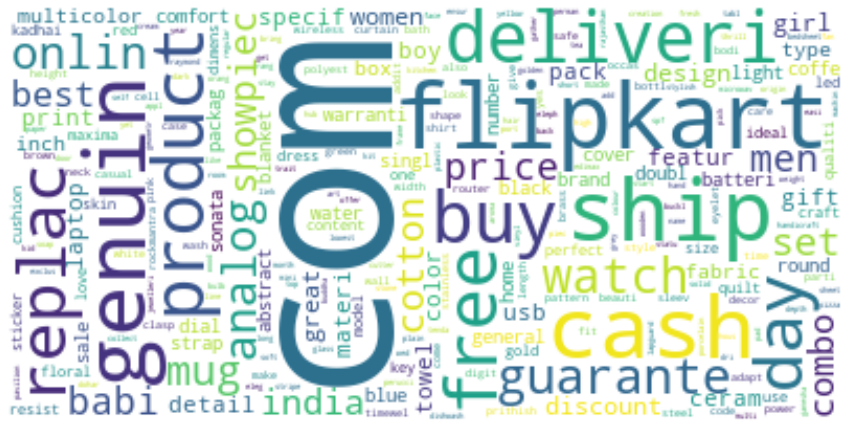

In [539]:
makeImage(frequence_pond0.to_dict(), 15, 15)

In [540]:
frequence_pond0.sort_values(ascending=False).head(10)

com         61.386467
flipkart    61.014703
ship        51.719302
cash        51.692254
genuin      51.692254
deliveri    51.615145
product     51.422184
buy         51.075566
free        51.066267
replac      44.592367
dtype: float64

### countvectorise_text

In [575]:
non_significativ_words = ['product', 'free', 'buy', 'ship', 'deliveri', 'price', 'featur', 'key', 'cash', 'day', 'com']
CountVect, frequence = countvectorise_text_fmin(text['description'], stopwords_base, 2, 'lemm', True, non_significativ_words, 2)
CountVect.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 3097)

In [576]:
CountVect

,aapno,aari,ability,able,abode,abroad,absorbency,absorbent,absorbing,abstract,...,youth,youthful,yuva,zero,zinc,zingalalaa,zipper,zone,zora,zyxel
0,0,0,0,0,0,0,0,0,0,4,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1046,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1047,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1048,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [572]:
# classement de frequence
frequence_ordered = frequence.sort_values(ascending=False)
frequence_ordered.head(10)

delivery         567
shipping         564
genuine          564
replacement      559
flipkart         481
guarantee        471
mug              457
feature          404
online           396
specification    379
dtype: int64

In [577]:
# projection sur 2 dimensions avec TSNE 
X_transformed_cv = TSNE(perplexity=20, n_iter=2000, init='pca').fit_transform(CountVect)
X_transformed_cv.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


(1050, 2)

<AxesSubplot:xlabel='x', ylabel='y'>

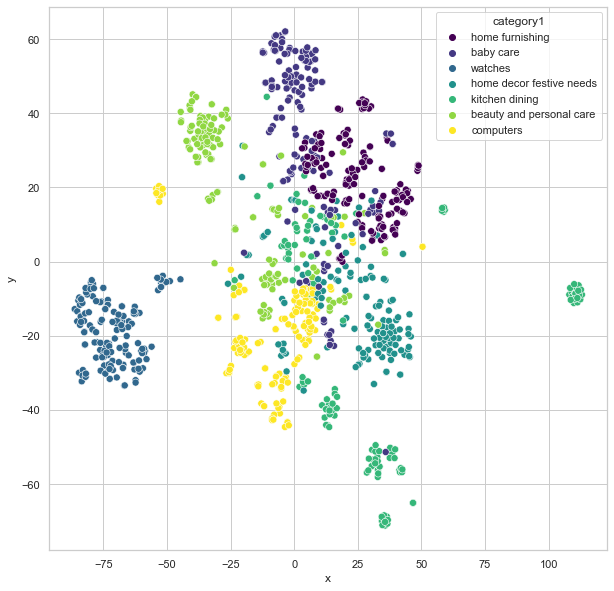

In [578]:
# Scatterplot du bagofwords colorié en fonction de la catégorie 1
data_plot_cv = pd.DataFrame(columns=['x', 'y'], data=X_transformed_cv)

cmap = plt.get_cmap('viridis')
colors = np.linspace(0, 1, 7)
color=[cmap(colors[i]) for i in range(7)]

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
sns.scatterplot(ax=ax, data=data_plot_cv, x='x', y='y', hue=categories['category1'], palette=color, s=50)

### tfidfvectorizer_text

In [579]:
tfidfvect, frequence_pond = tfidfvectorizer_text_fmin(text['description'], stopwords_base, 2, 'lemm', True, non_significativ_words, 0.1)
frequence_pond_ordered = frequence_pond.sort_values( ascending=False)
tfidfvect.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 3531)

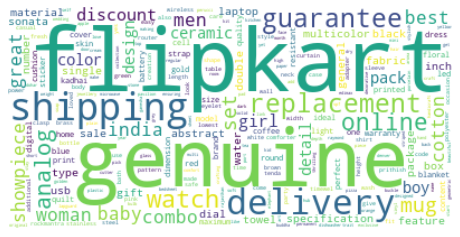

In [580]:
makeImage(frequence_pond.to_dict(), 8, 8)

In [581]:
frequence_pond_ordered = frequence_pond.sort_values(ascending=False)
frequence_pond_ordered.head(10)

flipkart       64.346726
shipping       53.863165
genuine        53.863165
delivery       53.781534
replacement    46.519830
guarantee      46.082477
watch          40.974485
online         36.411342
analog         34.596979
mug            27.968415
dtype: float64

In [582]:
# projection sur 2 dimensions avec TSNE
X_transformed_tfidf = TSNE(perplexity=20, n_iter=3000, init='pca').fit_transform(tfidfvect)
data_plot_tfidf = pd.DataFrame(columns=['x', 'y'], data=X_transformed_tfidf)

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<AxesSubplot:xlabel='x', ylabel='y'>

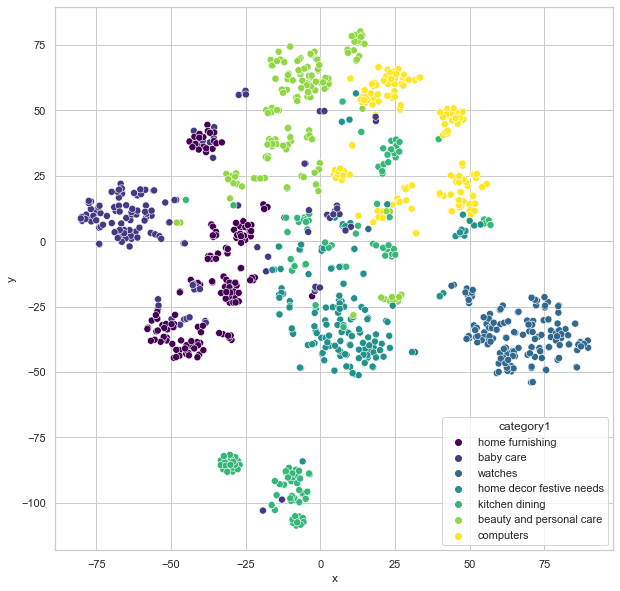

In [583]:
# Scatterplot du bagofwords colorié en fonction de la catégorie 1
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
sns.scatterplot(ax=ax, data=data_plot_tfidf, x='x', y='y', hue=categories['category1'], palette=color, s=50)

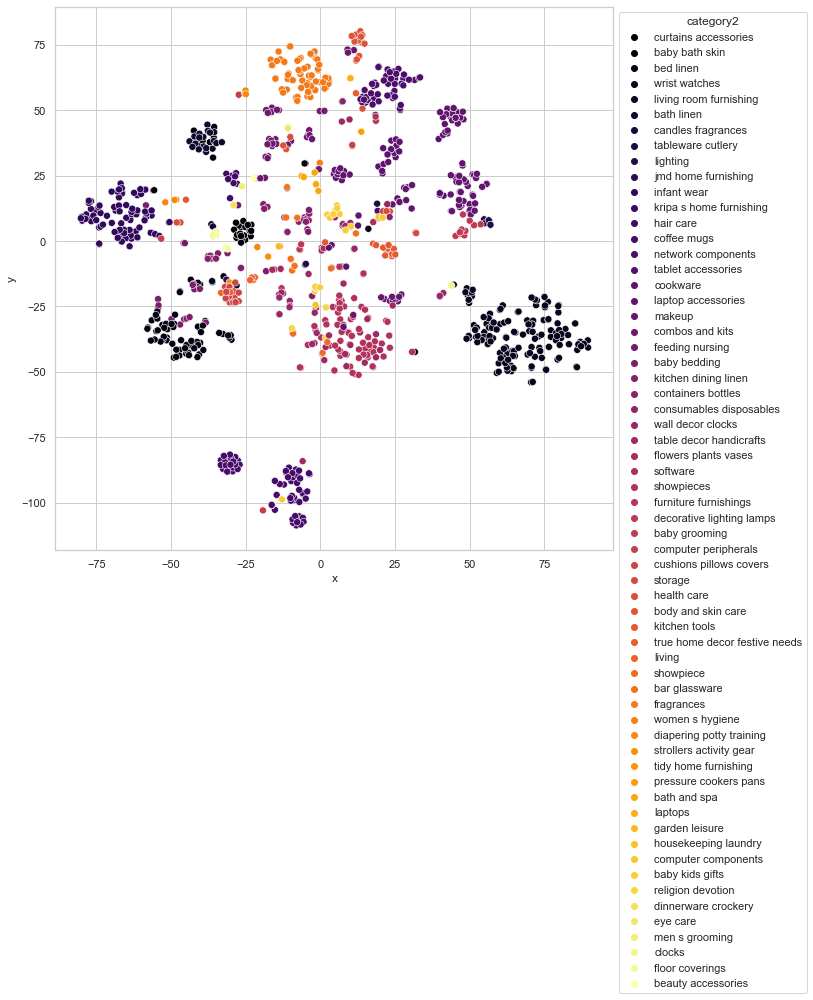

In [584]:
# Scatterplot du bagofwords colorié en fonction de la catégorie 2
cmap = plt.get_cmap('inferno')
colors = np.linspace(0, 1, 62)
color=[cmap(colors[i]) for i in range(62)]

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
sns.scatterplot(ax=ax, data=data_plot_tfidf, x='x', y='y', hue=categories['category2'], palette=color, s=50)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

## Appliqué aux données Name
### Visualisation

In [585]:
CountVect_name0, frequence_name0 = countvectorise_text_fmin(text['product_name'], stopwords_base, 2, 'lemm', True, [], 2)

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


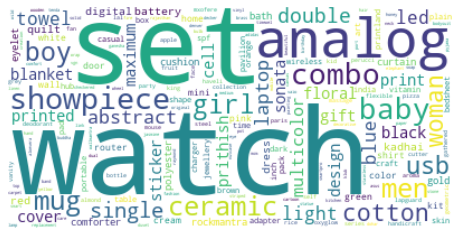

In [586]:
makeImage(frequence_name0.to_dict(), 8, 8)

### countvectorise_text

In [588]:
CountVect_name, frequence_name = countvectorise_text_fmin(text['product_name'], stopwords_base, 2, 'lemm', True, [], 2)
CountVect_name.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 656)

In [589]:
CountVect_name

,aapno,abstract,adapter,adhesive,adidas,adsl,aero,air,akup,alfajr,...,woven,wow,wrap,wrapper,yardley,yellow,york,yuva,zone,zyxel
0,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1046,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1047,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1048,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [592]:
frequence_name_ordered = frequence_name.sort_values(ascending=False)
frequence_name_ordered.head(10)

watch        151
set          135
analog       131
showpiece    105
baby          94
combo         93
men           78
ceramic       78
mug           76
girl          71
dtype: int64

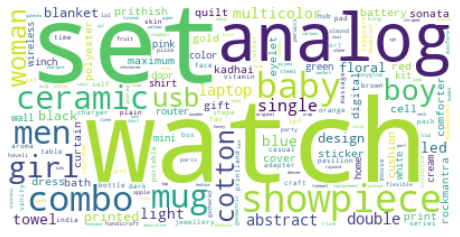

In [593]:
makeImage(frequence_name.to_dict(), 8, 8)

In [594]:
X_transformed_name_cv = TSNE(perplexity=30, n_iter=3000, init='pca').fit_transform(CountVect_name)
X_transformed_name_cv.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


(1050, 2)

In [595]:
data_plot_name_cv = pd.DataFrame(columns=['x', 'y'], data=X_transformed_name_cv)


In [596]:
cmap = plt.get_cmap('viridis')
colors = np.linspace(0, 1, 7)
color=[cmap(colors[i]) for i in range(7)]

<AxesSubplot:xlabel='x', ylabel='y'>

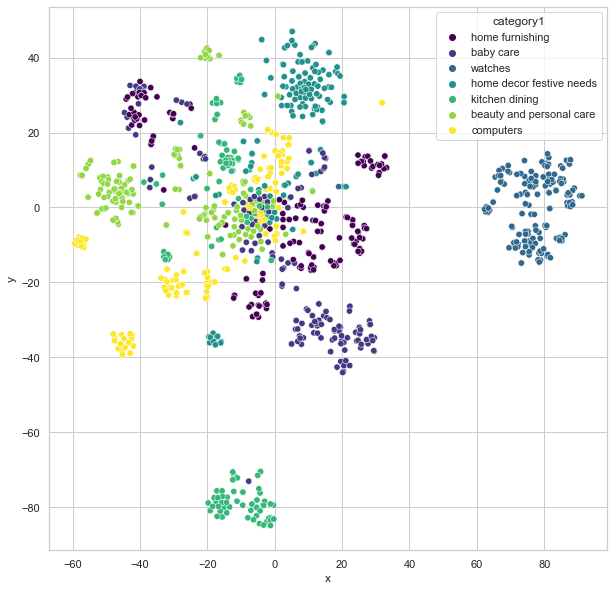

In [597]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
sns.scatterplot(ax=ax, data=data_plot_name_cv, x='x', y='y', hue=categories['category1'], palette=color, s=40)

### tfidfvectorizer_text

In [598]:
tfidfvect_name, frequence_name_pond = tfidfvectorizer_text_fmin(text['product_name'], stopwords_base, 2, 'lemm', True, [], 0.3)
frequence_name_pond_ordered = frequence_name_pond.sort_values( ascending=False)

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


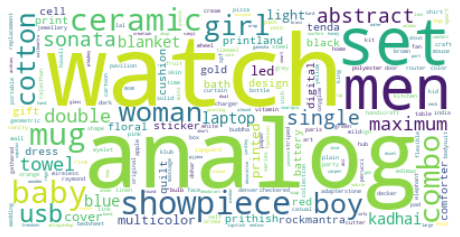

In [601]:
makeImage(frequence_name_pond.to_dict(), 8, 8)

In [107]:
X_transformed_name_tfidf = TSNE(perplexity=30, n_iter=3000, init='pca').fit_transform(tfidfvect_name)
X_transformed_name_tfidf.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


(1050, 2)

In [108]:
data_plot_name_tfidf = pd.DataFrame(columns=['x', 'y'], data=X_transformed_name_tfidf)

In [109]:
cmap = plt.get_cmap('viridis')
colors = np.linspace(0, 1, 7)
color=[cmap(colors[i]) for i in range(7)]

<AxesSubplot:xlabel='x', ylabel='y'>

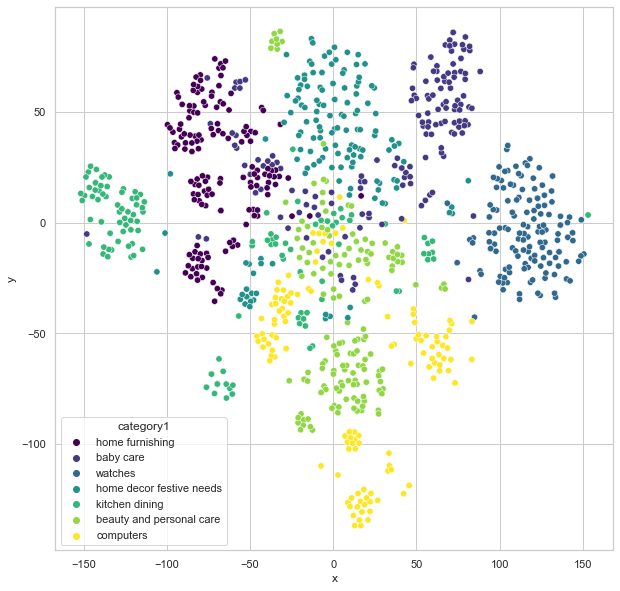

In [110]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
sns.scatterplot(ax=ax, data=data_plot_name_tfidf, x='x', y='y', hue=categories['category1'], palette=color, s=40)

## Details des catégories
### Computers

In [111]:
categories.loc[categories['category1']=='computers']['category2'].value_counts()

laptop accessories      87
network components      49
computer peripherals     4
tablet accessories       3
storage                  2
laptops                  2
computer components      2
software                 1
Name: category2, dtype: int64

In [112]:
index_computer = categories.loc[categories['category1']=='computers'].index
data_computer = tfidfvect_name.iloc[index_computer, :]
categories_computer = categories.iloc[index_computer, :]
data_plot_computer = data_plot_name_tfidf.iloc[index_computer, :]

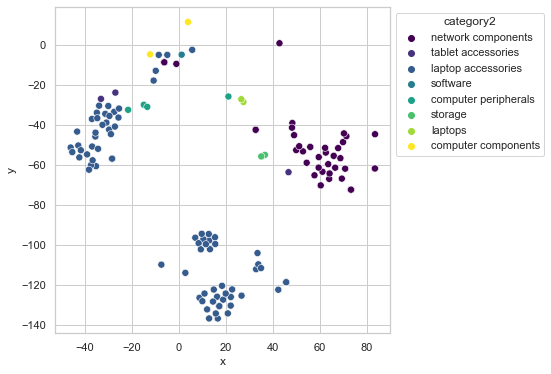

In [113]:
colors2 = np.linspace(0, 1, 8)
color2=[cmap(colors2[i]) for i in range(8)]
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
sns.scatterplot(ax=ax, data=data_plot_computer, x='x', y='y', hue=categories_computer['category2'], palette=color2, s=50)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

In [114]:
cat2_comp = ['network components', 'laptop accessories']

### home furnishing

In [115]:
categories.loc[categories['category1']=='home furnishing']['category2'].value_counts()

bed linen                  65
bath linen                 21
curtains accessories       19
kitchen dining linen       14
cushions pillows covers    13
living                      6
floor coverings             6
living room furnishing      3
jmd home furnishing         1
kripa s home furnishing     1
tidy home furnishing        1
Name: category2, dtype: int64

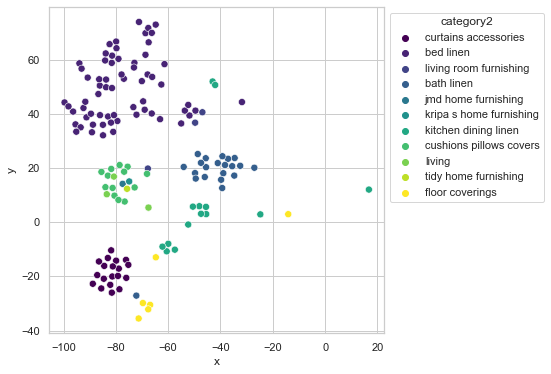

In [116]:
index_furnishing = categories.loc[categories['category1']=='home furnishing'].index
data_index_furnishing = tfidfvect_name.iloc[index_furnishing, :]
categories_furnishing = categories.iloc[index_furnishing, :]
data_plot_furnishing = data_plot_name_tfidf.iloc[index_furnishing, :]

colors2 = np.linspace(0, 1, 11)
color2=[cmap(colors2[i]) for i in range(11)]
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
sns.scatterplot(ax=ax, data=data_plot_furnishing, x='x', y='y', hue=categories_furnishing['category2'], palette=color2, s=50)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

In [117]:
cat2_furnish = ['curtains accessories', 'bed linen', 'bath linen', 'cushions pillows covers']

### Baby Care

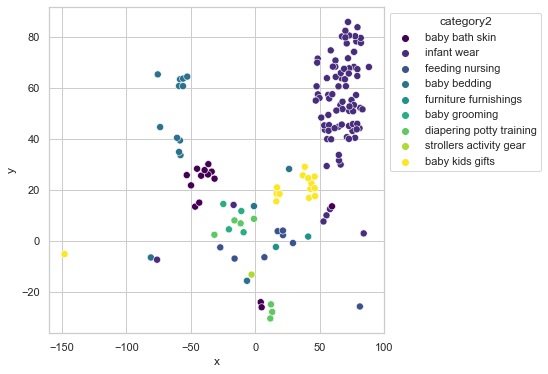

In [118]:
categories.loc[categories['category1']=='baby care']['category2'].value_counts()

index_baby = categories.loc[categories['category1']=='baby care'].index
data_baby = tfidfvect_name.iloc[index_baby, :]
categories_baby = categories.iloc[index_baby, :]
data_plot_baby = data_plot_name_tfidf.iloc[index_baby, :]

colors2 = np.linspace(0, 1, 9)
color2=[cmap(colors2[i]) for i in range(9)]
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
sns.scatterplot(ax=ax, data=data_plot_baby, x='x', y='y', hue=categories_baby['category2'], palette=color2, s=50)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

### Watches

In [119]:
categories.loc[categories['category1']=='watches']['category2'].value_counts()


wrist watches    149
clocks             1
Name: category2, dtype: int64

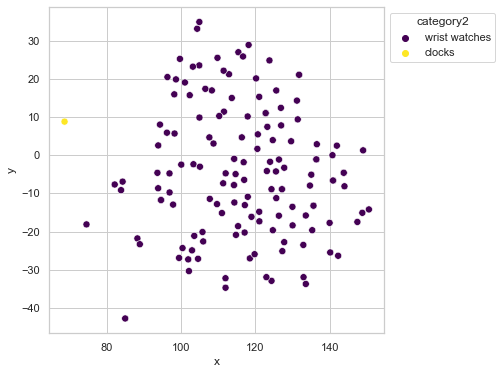

In [120]:
index_watches = categories.loc[categories['category1']=='watches'].index
data_watches = tfidfvect_name.iloc[index_watches, :]
categories_watches = categories.iloc[index_watches, :]
data_plot_watches = data_plot_name_tfidf.iloc[index_watches, :]

colors2 = np.linspace(0, 1, 2)
color2=[cmap(colors2[i]) for i in range(2)]
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
sns.scatterplot(ax=ax, data=data_plot_watches, x='x', y='y', hue=categories_watches['category2'], palette=color2, s=50)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

### home decor festive needs

In [121]:
categories.loc[categories['category1']=='home decor festive needs']['category2'].value_counts()


showpieces                       71
table decor handicrafts          27
wall decor clocks                22
decorative lighting lamps        14
flowers plants vases              5
showpiece                         5
religion devotion                 3
candles fragrances                1
true home decor festive needs     1
garden leisure                    1
Name: category2, dtype: int64

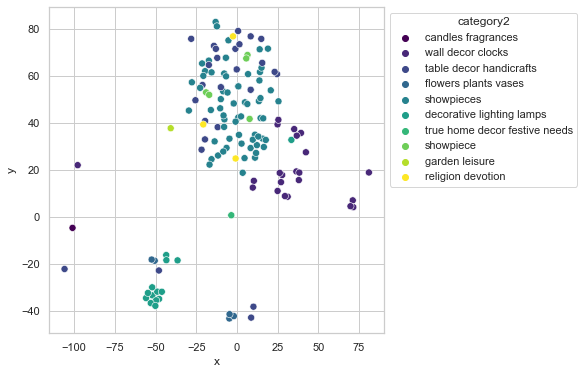

In [122]:
index_decor = categories.loc[categories['category1']=='home decor festive needs'].index
data_decor = tfidfvect_name.iloc[index_decor, :]
categories_decor = categories.iloc[index_decor, :]
data_plot_decor = data_plot_name_tfidf.iloc[index_decor, :]

colors2 = np.linspace(0, 1, 10)
color2=[cmap(colors2[i]) for i in range(10)]
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
sns.scatterplot(ax=ax, data=data_plot_decor, x='x', y='y', hue=categories_decor['category2'], palette=color2, s=50)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

### kitchen dining

In [123]:
categories['category1'].unique()

array(['home furnishing', 'baby care', 'watches',
       'home decor festive needs', 'kitchen dining',
       'beauty and personal care', 'computers'], dtype=object)

In [124]:
categories.loc[categories['category1']=='kitchen dining']['category2'].value_counts()

coffee mugs                74
cookware                   27
kitchen tools              14
containers bottles         13
bar glassware               8
lighting                    7
tableware cutlery           3
consumables disposables     1
pressure cookers pans       1
housekeeping laundry        1
dinnerware crockery         1
Name: category2, dtype: int64

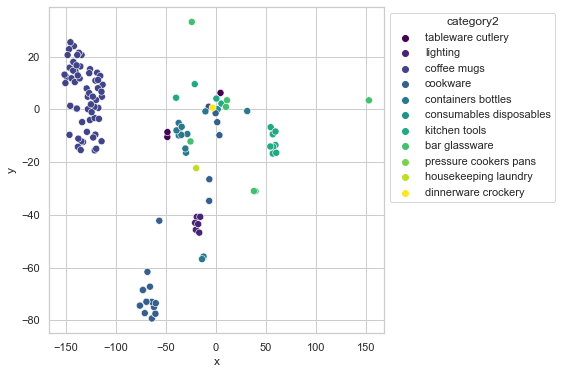

In [125]:
index_kitchen = categories.loc[categories['category1']=='kitchen dining'].index
data_kitchen = tfidfvect_name.iloc[index_kitchen, :]
categories_kitchen = categories.iloc[index_kitchen, :]
data_plot_kitchen = data_plot_name_tfidf.iloc[index_kitchen, :]

colors2 = np.linspace(0, 1, 11)
color2=[cmap(colors2[i]) for i in range(11)]
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
sns.scatterplot(ax=ax, data=data_plot_kitchen, x='x', y='y', hue=categories_kitchen['category2'], palette=color2, s=50)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

In [126]:
cat2_kitchen = ['coffee mugs']

### beauty and personal care

In [127]:
categories['category1'].unique()

array(['home furnishing', 'baby care', 'watches',
       'home decor festive needs', 'kitchen dining',
       'beauty and personal care', 'computers'], dtype=object)

In [128]:
categories.loc[categories['category1']=='beauty and personal care']['category2'].value_counts()

fragrances            65
combos and kits       24
makeup                18
body and skin care    15
hair care              9
health care            7
bath and spa           7
eye care               2
women s hygiene        1
men s grooming         1
beauty accessories     1
Name: category2, dtype: int64

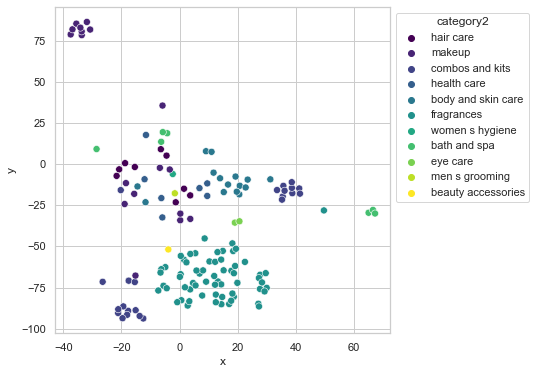

In [129]:
index_beauty = categories.loc[categories['category1']=='beauty and personal care'].index
data_beauty = tfidfvect_name.iloc[index_beauty, :]
categories_beauty = categories.iloc[index_beauty, :]
data_plot_beauty = data_plot_name_tfidf.iloc[index_beauty, :]

colors2 = np.linspace(0, 1, 11)
color2=[cmap(colors2[i]) for i in range(11)]
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
sns.scatterplot(ax=ax, data=data_plot_beauty, x='x', y='y', hue=categories_beauty['category2'], palette=color2, s=50)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

In [130]:
cat2_beauty = ['fragrances', 'combos and kits']

### Creation liste de catégories 2 restreinte

In [131]:
cat2 = cat2_beauty+cat2_kitchen+cat2_furnish+cat2_comp

In [132]:
len(cat2)

9

In [133]:
def select(x):
    if x in cat2:
        x=x
    else:
        x=''
    return x
select('curtains accessories')

'curtains accessories'

In [602]:
categories['cat'] = categories['category2']
categories['cat'] = categories['cat'].apply(lambda x: select(x))
mask = categories['cat']==''
categories.loc[mask, 'cat'] = categories[mask]['category1']

In [603]:
nb_clusters = len(categories['category1'].unique())
categories_num = categories['category1'].apply(lambda x: numerize(x))

In [604]:
categories_name_number = pd.DataFrame({'number': range(7), 'category': ['home furnishing', 'baby care', 'watches', 'home decor festive needs', 'kitchen dining', 'beauty and personal care', 'computers']})
categories_name_number

,number,category
0,0,home furnishing
1,1,baby care
2,2,watches
3,3,home decor festive needs
4,4,kitchen dining
5,5,beauty and personal care
6,6,computers


In [138]:
#perplexity=30, n_iter=2000,  init='pca', learning_rate=200, random_state=42

# Clustering non supervisé

In [139]:
import time
def ARI_fct(features, nb_clusters, cat_num, perplex, learn_rate) :
    """
    Projet features in 2 dimensions with TSNE
    Clusterize with KMeans in nb_clusters
    Calculate ARI score between clustering and true cat_num
    
    Positionnal argument:
    ---------------------------
    features : dataframe : bag of words
    nb_clusters : int : number of clusters
    cat_num : list : list of categories 
    perplex : int : perplexity for projection
    learn_rate : int : learn rate for projection
    
    Return:
    ---------------------------
    ARI : between clusters and truth
    X_tsne : features projected
    cls.labels_ : list of labels from clustering
    time2 : time of computation
    
    """
    time1 = time.time()
    tsne = TSNE(n_components=2, perplexity=perplex, n_iter=2000, 
                                 init='random', learning_rate=learn_rate, random_state=42)
    X_tsne = tsne.fit_transform(features)
    
    cls = KMeans(n_clusters=nb_clusters, n_init=100, random_state=42)
    cls.fit(X_tsne)
    ARI = np.round(adjusted_rand_score(cat_num, cls.labels_), 4)
    time2 = np.round(time.time() - time1,0)
    
    return ARI, X_tsne, cls.labels_, time2

In [140]:
def TSNE_visu_fct(ARI, X_tsne, labels, time, cat_num) :
    """
    Scatterplot X_tsne colored with predicted labels and true cat_num
    
    Positionnal argument:
    ---------------------------
    results of ARI_fct
    
    """
    fig, ax = plt.subplots(1, 2, figsize=(15,6))
    
    sns.scatterplot(ax=ax[0], x=X_tsne[:,0],y=X_tsne[:,1], hue=cat_num, cmap='Set1')
    ax[0].set_title('Représentation des descriptions par catégories')
    ax[0].legend('')

    sns.scatterplot(ax=ax[1], x=X_tsne[:,0],y=X_tsne[:,1], hue=labels, cmap='Set1')
    ax[1].set_title('Représentation des descriptions par clusters')
    ax[1].legend('')
    
    fig.suptitle(f"ARI = {ARI} - Time = {time}", fontsize=16, weight='bold')

In [141]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

In [142]:
def ARI_fct_LDA(features, nb_clusters, cat_num) :
    time1 = time.time()
    LDA = LinearDiscriminantAnalysis(n_components=2,)
    X_LDA = LDA.fit_transform(features, cat_num)
    
    cls = KMeans(n_clusters=nb_clusters, n_init=100, random_state=42)
    cls.fit(X_LDA)
    ARI = np.round(adjusted_rand_score(cat_num, cls.labels_), 4)
    time2 = np.round(time.time() - time1,0)
    
    return ARI, X_LDA, cls.labels_, time2

## Feature description
### CounVect

In [143]:
# Clustering non supervisé de countvect

#### Stemm

In [144]:
CountVect, frequence = countvectorise_text_fmin(text['description'], stopwords_base, 2, 'stemm', True, non_significativ_words, 2)
CountVect.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 2767)

In [145]:
ARI_score_cv, Xtsne_cv, labels_cv, time_cv = ARI_fct(CountVect, nb_clusters, categories_num, 30, 1500)

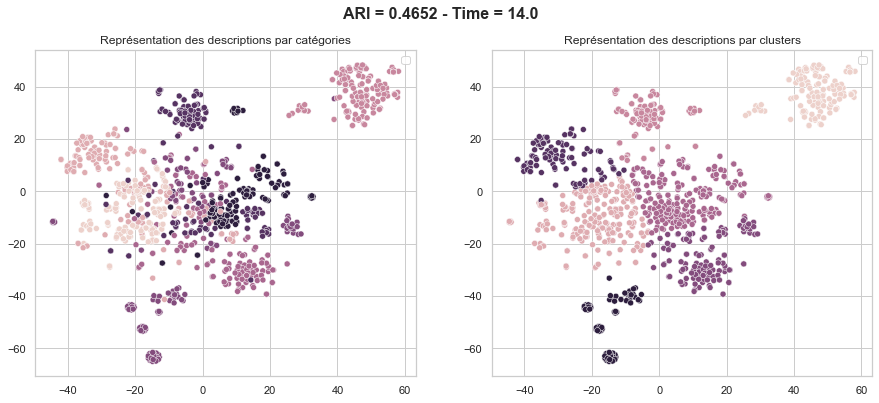

In [146]:
TSNE_visu_fct(ARI_score_cv, Xtsne_cv, labels_cv, time_cv, categories_num )

#### Lemmatize

In [147]:
CountVect1, frequence1 = countvectorise_text_fmin(text['description'], stopwords_base, 2, 'lemm', True, non_significativ_words, 4)
CountVect1.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 1722)

In [148]:
ARI_score_cv1, Xtsne_cv1, labels_cv1, time_cv1 = ARI_fct(CountVect1, nb_clusters, categories_num, 30, 1500)

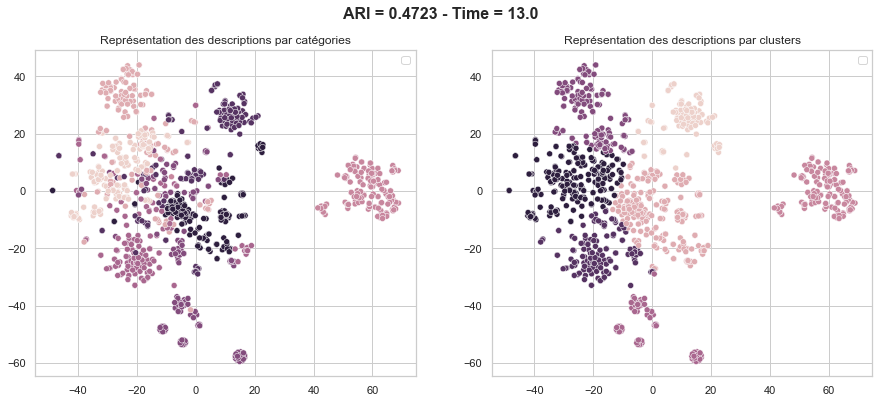

In [149]:
TSNE_visu_fct(ARI_score_cv1, Xtsne_cv1, labels_cv1, time_cv1, categories_num )

### tfidfvect

#### Stemm

In [150]:
tfidfvect, frequence_pond = tfidfvectorizer_text_fmin(text['description'], stopwords_base, 2, 'stemm', True, non_significativ_words, 0.07)
frequence_pond_ordered = frequence_pond.sort_values( ascending=False)
tfidfvect.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 3452)

In [151]:
ARI_score_tdidf, Xtsne_tdidf, labels_tdidf, time_tdidf = ARI_fct(tfidfvect, nb_clusters, categories_num, 30, 2000)

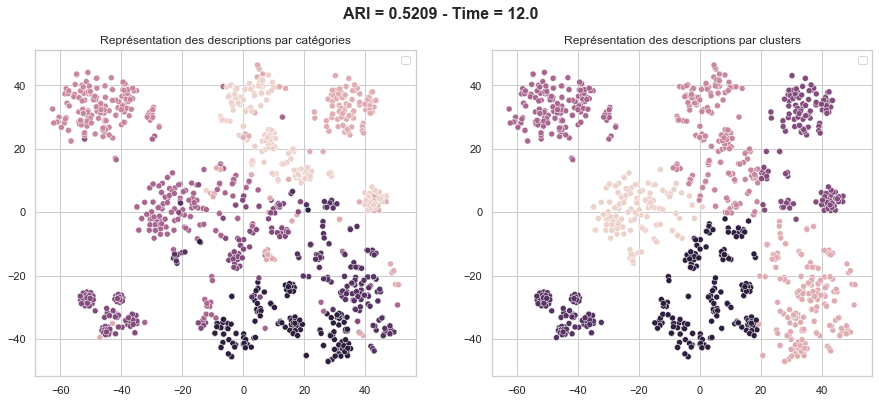

In [152]:
TSNE_visu_fct(ARI_score_tdidf, Xtsne_tdidf, labels_tdidf, time_tdidf, categories_num)

#### Lemmatize

In [153]:
tfidfvect1, frequence_pond1 = tfidfvectorizer_text_fmin(text['description'], stopwords_base, 2, 'lemm', True, non_significativ_words, 0.05)
tfidfvect1.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 4214)

In [154]:
ARI_score_tdidf1, Xtsne_tdidf1, labels_tdidf1, time_tdidf1 = ARI_fct(tfidfvect1, nb_clusters, categories_num, 30, 2000)

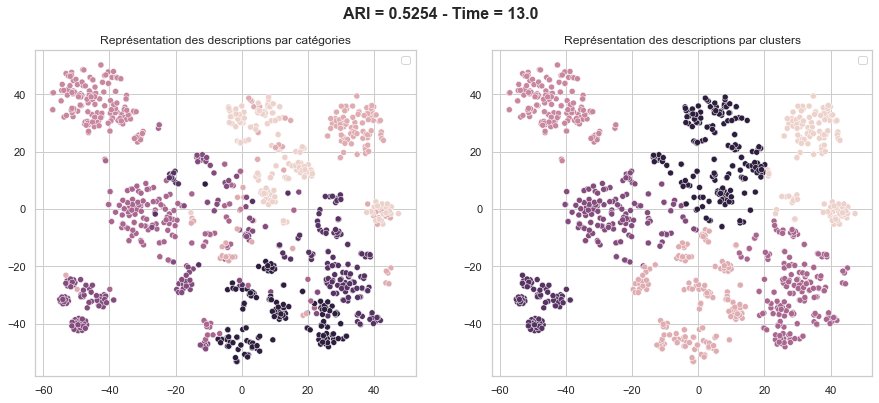

In [155]:
TSNE_visu_fct(ARI_score_tdidf1, Xtsne_tdidf1, labels_tdidf1, time_tdidf1, categories_num)

## Feature Name 
### CountVect_name

#### Stemm

In [156]:
ARI_score_name_cv, Xtsne_name_cv, labels_name_cv, time_cv = ARI_fct(CountVect_name, nb_clusters, categories_num, 30, 800)

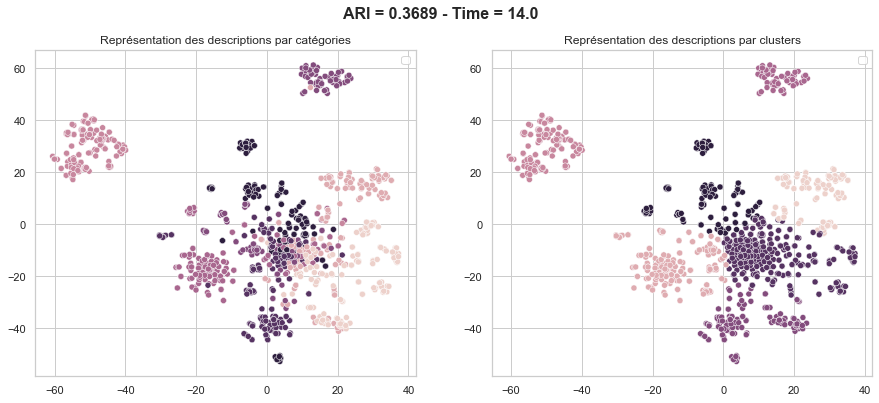

In [157]:
TSNE_visu_fct(ARI_score_name_cv, Xtsne_name_cv, labels_name_cv, time_cv, categories_num)

#### Lemmatize

In [158]:
CountVect_name1, frequence_name1 = countvectorise_text_fmin(text['product_name'], stopwords_base, 2, 'lemm', True, [], 2)
CountVect_name1.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 656)

In [159]:
ARI_score_name_cv1, Xtsne_name_cv1, labels_name_cv1, time_cv1 = ARI_fct(CountVect_name1, nb_clusters, categories_num, 30, 800)

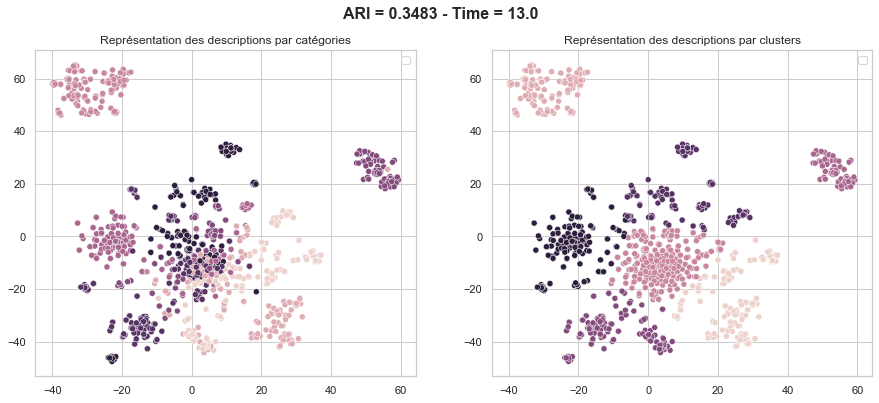

In [160]:
TSNE_visu_fct(ARI_score_name_cv1, Xtsne_name_cv1, labels_name_cv1, time_cv1, categories_num)

### tfidfvect_name

#### Stemm

In [161]:
tfidfvect_name.shape

(1050, 1650)

In [162]:
ARI_score_name_tdidf, Xtsne_name_tdidf, labels_name_tdidf, time_tdidf = ARI_fct(tfidfvect_name, nb_clusters, categories_num, 30, 1000)

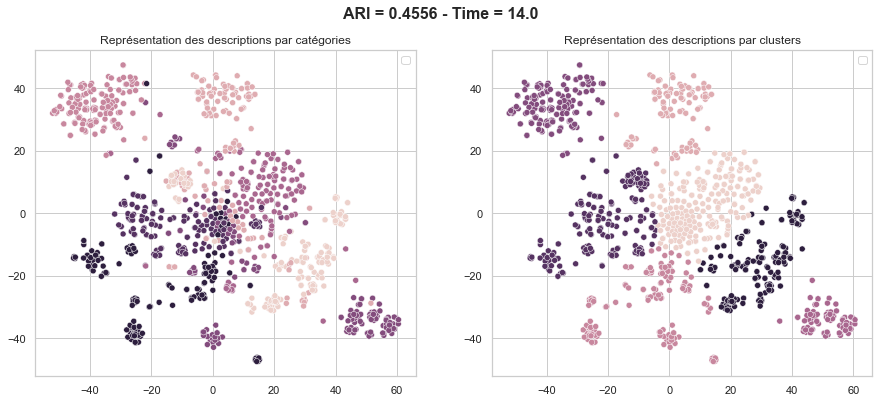

In [163]:
TSNE_visu_fct(ARI_score_name_tdidf, Xtsne_name_tdidf, labels_name_tdidf, time_tdidf, categories_num)

#### Lemmatize

In [164]:
tfidfvect_name1, frequence_name_pond1 = tfidfvectorizer_text_fmin(text['product_name'], stopwords_base, 2, 'lemm', True, [], 0.3)
tfidfvect_name1.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 1692)

In [165]:
ARI_score_name_tdidf1, Xtsne_name_tdidf1, labels_name_tdidf1, time_tdidf1 = ARI_fct(tfidfvect_name1, nb_clusters, categories_num, 30, 300)

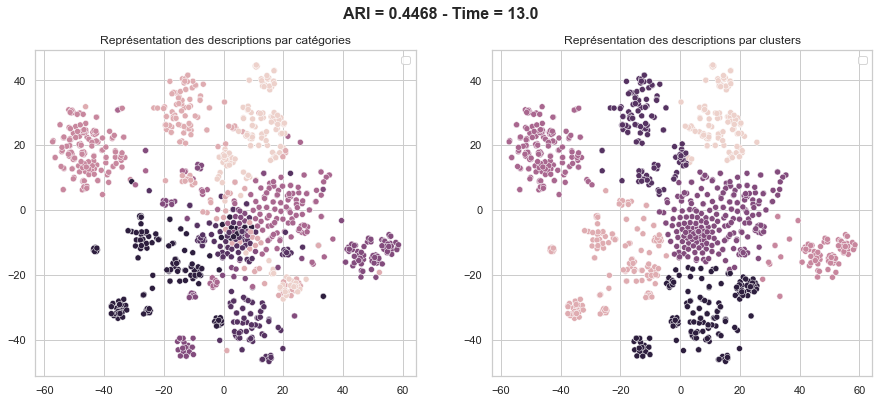

In [166]:
TSNE_visu_fct(ARI_score_name_tdidf1, Xtsne_name_tdidf1, labels_name_tdidf1, time_tdidf1, categories_num)

## Features name+description
### CountVect 

#### Stemm

In [167]:
features_descr_name_cv = pd.merge(CountVect, CountVect_name, left_index=True, right_index=True)

In [168]:
ARI_score_descr_name_cv, Xtsne_descr_name_cv, labels_descr_name_cv, time_descr_name_cv = ARI_fct(features_descr_name_cv, 
                                                                                                 nb_clusters, 
                                                                                                 categories_num, 30, 1000)

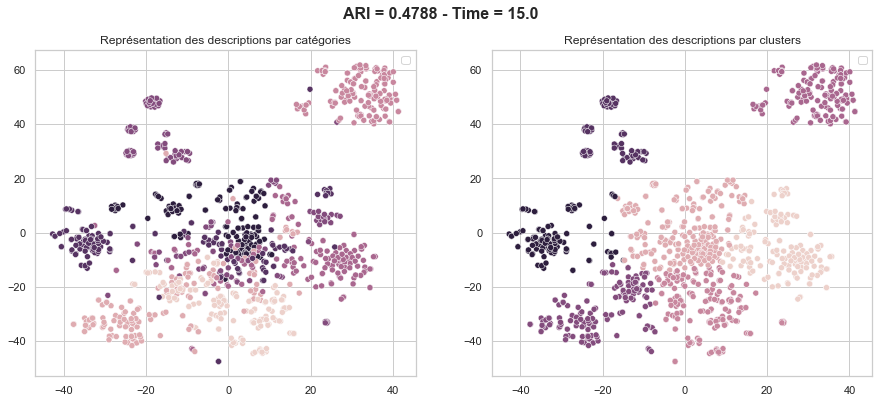

In [169]:
TSNE_visu_fct(ARI_score_descr_name_cv, Xtsne_descr_name_cv, labels_descr_name_cv, time_descr_name_cv, categories_num)

#### Lemmatize

In [170]:
features_descr_name_cv1 = pd.merge(CountVect1, CountVect_name1, left_index=True, right_index=True)

In [171]:
ARI_score_descr_name_cv1, Xtsne_descr_name_cv1, labels_descr_name_cv1, time_descr_name_cv1 = ARI_fct(features_descr_name_cv1, 
                                                                                                 nb_clusters, 
                                                                                                 categories_num, 30, 1000)

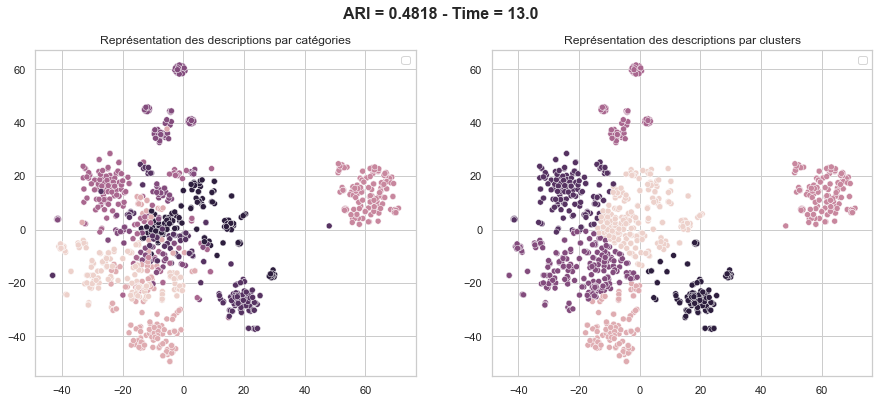

In [172]:
TSNE_visu_fct(ARI_score_descr_name_cv1, Xtsne_descr_name_cv1, labels_descr_name_cv1, time_descr_name_cv1, categories_num)

### tfidf 

#### Stemm

In [173]:
features_descr_name_tfidf = pd.merge(tfidfvect, tfidfvect_name, left_index=True, right_index=True)

In [174]:
ARI_score_descr_name_tdidf, Xtsne_descr_name_tdidf, labels_descr_name_tdidf, time_descr_name_tdidf = ARI_fct(features_descr_name_tfidf, 
                                                                                                             nb_clusters, 
                                                                                                             categories_num, 30, 750)

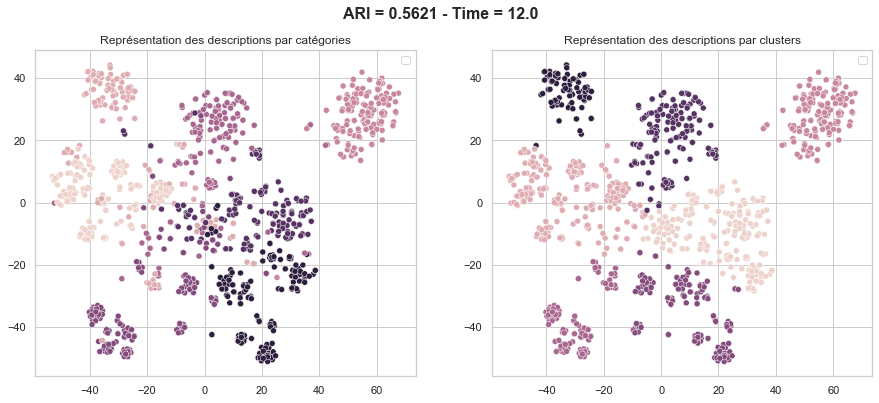

In [175]:
TSNE_visu_fct(ARI_score_descr_name_tdidf, Xtsne_descr_name_tdidf, labels_descr_name_tdidf, time_descr_name_tdidf, categories_num)

#### Lemmatize

In [176]:
features_descr_name_tfidf1 = pd.merge(tfidfvect1, tfidfvect_name1, left_index=True, right_index=True)

In [177]:
ARI_score_descr_name_tdidf1, Xtsne_descr_name_tdidf1, labels_descr_name_tdidf1, time_descr_name_tdidf1 = ARI_fct(features_descr_name_tfidf1, 
                                                                                                             nb_clusters, 
                                                                                                             categories_num, 30, 750)

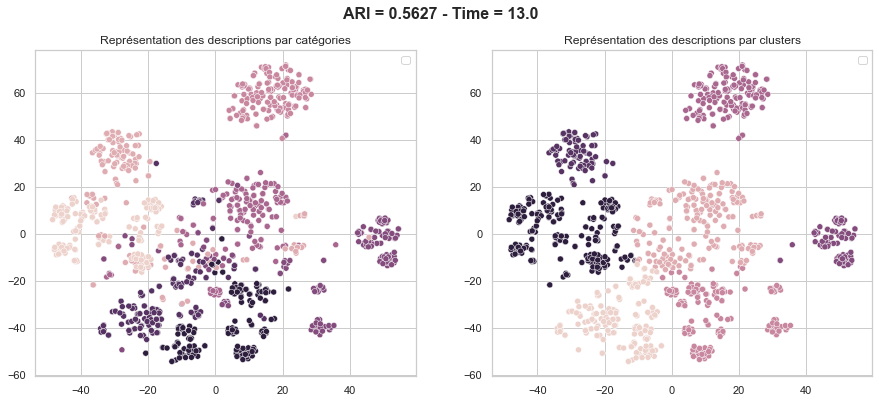

In [178]:
TSNE_visu_fct(ARI_score_descr_name_tdidf1, Xtsne_descr_name_tdidf1, labels_descr_name_tdidf1, time_descr_name_tdidf1, categories_num)

# Essais de classification supervisée - Paramètres par défaut

In [179]:
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.preprocessing import FunctionTransformer, StandardScaler, PolynomialFeatures
from sklearn.compose import ColumnTransformer

In [180]:
scaler = StandardScaler()
preprocessor = ColumnTransformer([('scaler', scaler)])

In [181]:
from sklearn import model_selection
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

## Fonctions
### fonction supervised_classification

In [182]:
def supervised_classification_with_tsne(features, cat_num, estimator) :
    """
    Projet features in 2 dimensions with TSNE
    Supervised classification with estimator
    
    Positionnal argument:
    ---------------------------
    features : dataframe : bag of words
    cat_num : list : list of categories 
    estimator : sklearn model for classification 
    
    """
    time1 = time.time()
    tsne = TSNE(n_components=2, perplexity=30, n_iter=2000, 
                                 init='random', learning_rate=200, random_state=42)
    X_tsne = tsne.fit_transform(features)
    
    X_train, X_test, y_train, y_test = train_test_split(X_tsne,
                                                    cat_num, 
                                                    test_size=0.2, 
                                                    random_state=42, 
                                                    stratify=cat_num)
    estimator.fit(X_train, y_train)
    score_train = estimator.score(X_train, y_train)
    score_test = estimator.score(X_test, y_test)
    y_train_predict = estimator.predict(X_train)
    y_test_predict = estimator.predict(X_test)
    ARI_train = np.round(adjusted_rand_score(y_train_predict, y_train), 4)
    ARI_test = np.round(adjusted_rand_score(y_test_predict, y_test), 4)
    time2 = np.round(time.time() - time1,0)
    print(f"score_train : {score_train}\nscore_test : {score_test}")
    return X_train, y_train_predict, y_train, ARI_train, X_test, y_test_predict, y_test, ARI_test

In [183]:
def supervised_classification(features, cat_num, estimator) :
    """
    Supervised classification with estimator
    
    Positionnal argument:
    ---------------------------
    features : dataframe : bag of words
    cat_num : list : list of categories 
    estimator : sklearn model for classification 
    
    """
    time1 = time.time()
    X_train, X_test, y_train, y_test = train_test_split(features,
                                                    cat_num, 
                                                    test_size=0.2, 
                                                    random_state=42, 
                                                    stratify=cat_num)
    estimator.fit(X_train, y_train)
    score_train = estimator.score(X_train, y_train)
    score_test = estimator.score(X_test, y_test)
    y_train_predict = estimator.predict(X_train)
    y_test_predict = estimator.predict(X_test)
    ARI_train = np.round(adjusted_rand_score(y_train_predict, y_train), 4)
    ARI_test = np.round(adjusted_rand_score(y_test_predict, y_test), 4)
    time2 = np.round(time.time() - time1,0)
    print(f"score_train : {score_train}\nscore_test : {score_test}")
    return X_train, y_train_predict, y_train, ARI_train, X_test, y_test_predict, y_test, ARI_test

In [184]:
def clusters(X):
    """
    Récupère les labels des clusters par individu
    """
    X_clust = pd.DataFrame(X)
    X_clust['cluster'] = X_clust.idxmin(axis=1)
    return X_clust['cluster']

### Fonction visualisation

In [185]:
def supervised_classification_visu(X_train, y_train_predict, y_train, ARI_train, X_test, y_test_predict, y_test, ARI_test) :
    
    fig, ax = plt.subplots(1, 2, figsize=(15,6))
    sns.heatmap(ax=ax[0], data=confusion_matrix(y_train_predict, y_train), annot=True, cmap='Blues', fmt='d')
    ax[0].set_title(f"Matrice de confusion - Train \n Accuracy : {round(accuracy_score(y_train_predict, y_train), 4)} ", fontsize=12, weight='bold')
    sns.heatmap(ax=ax[1], data=confusion_matrix(y_test_predict, y_test), annot=True, cmap='Blues', fmt='d') 
    ax[1].set_title(f"Matrice de confusion - Test \nAccuracy : {round(accuracy_score(y_test_predict, y_test), 4)}", fontsize=12, weight='bold')
    
    fig, ax = plt.subplots(2, 2, figsize=(15,15))
    
    sns.scatterplot(ax=ax[0][0], x=X_train[:,0],y=X_train[:,1], hue=y_train, cmap='Set1')
    ax[0][0].set_title(f"Train truth", fontsize=12, weight='bold', ha='right')
    sns.scatterplot(ax=ax[0][1], x=X_train[:,0],y=X_train[:,1], hue=y_train_predict, cmap='Set1')
    ax[0][1].set_title(f"Train prediction", fontsize=12, weight='bold', ha='right')
    ax[0][0].legend('')
    ax[0][1].legend('')

    sns.scatterplot(ax=ax[1][0], x=X_test[:,0],y=X_test[:,1], hue=y_test, cmap='Set1')
    ax[1][0].set_title(f"Test truth", fontsize=12, weight='bold', ha='right')
    sns.scatterplot(ax=ax[1][1], x=X_test[:,0], y=X_test[:,1], hue=y_test_predict, cmap='Set1')
    ax[1][1].set_title(f"Test prediction", fontsize=12, weight='bold', ha='right')
    ax[1][0].legend('')
    ax[1][1].legend('')
    
    fig.suptitle(f"ARI train : {ARI_train} - ARI test : {ARI_test}", fontsize=16, weight='bold', ha='center')   

In [186]:
def supervised_classification_visu_with_tsne(features, X_train, y_train_predict, y_train, ARI_train, X_test, y_test_predict, y_test, ARI_test) :
    
    
    fig, ax = plt.subplots(1, 2, figsize=(15,6))
    sns.heatmap(ax=ax[0], data=confusion_matrix(y_train_predict, y_train), annot=True, cmap='Blues', fmt='d')
    ax[0].set_title(f"Matrice de confusion - Train \n Accuracy : {round(accuracy_score(y_train_predict, y_train), 4)} ", fontsize=12, weight='bold')
    sns.heatmap(ax=ax[1], data=confusion_matrix(y_test_predict, y_test), annot=True, cmap='Blues', fmt='d') 
    ax[1].set_title(f"Matrice de confusion - Test \n Accuracy : {round(accuracy_score(y_test_predict, y_test), 4)} ", fontsize=12, weight='bold')
     
    tsne = TSNE(n_components=2, perplexity=30, n_iter=2000, 
                                 init='random', learning_rate=200, random_state=42)
    X_tsne = tsne.fit_transform(features)
    fig, ax = plt.subplots(2, 2, figsize=(15,15))
    index_train=list(X_train.index)
    index_test=list(X_test.index)
    
    print(f"Precision : {precision_score (y_test_predict, y_test, average='macro')} \nRecall : {recall_score(y_test_predict, y_test, average='macro')}")
    
    sns.scatterplot(ax=ax[0][0], x=X_tsne[index_train, 0],y=X_tsne[index_train, 1], hue=y_train, cmap='Set1')
    ax[0][0].set_title(f"Train truth", fontsize=12, weight='bold', ha='right')
    sns.scatterplot(ax=ax[0][1], x=X_tsne[index_train, 0],y=X_tsne[index_train, 1], hue=y_train_predict, cmap='Set1')
    ax[0][1].set_title(f"Train prediction", fontsize=12, weight='bold', ha='right')
    ax[0][0].legend('')
    ax[0][1].legend('')

    sns.scatterplot(ax=ax[1][0], x=X_tsne[index_test, 0],y=X_tsne[index_test, 1], hue=y_test, cmap='Set1')
    ax[1][0].set_title(f"Test truth", fontsize=12, weight='bold', ha='right')
    sns.scatterplot(ax=ax[1][1], x=X_tsne[index_test, 0], y=X_tsne[index_test, 1], hue=y_test_predict, cmap='Set1')
    ax[1][1].set_title(f"Test prediction", fontsize=12, weight='bold', ha='right')
    ax[1][0].legend('')
    ax[1][1].legend('')
    
    fig.suptitle(f"ARI train : {ARI_train} - ARI test : {ARI_test}", fontsize=16, weight='bold', ha='center')

In [187]:
def supervised_classification_confusion_matrice(features, X_train, y_train_predict, y_train, ARI_train, X_test, y_test_predict, y_test, ARI_test) :
    
    fig, ax = plt.subplots(1, 2, figsize=(15,6))
    sns.heatmap(ax=ax[0], data=confusion_matrix(y_train_predict, y_train), annot=True, cmap='Blues', fmt='d')
    ax[0].set_title(f"Matrice de confusion - Train \n Accuracy : {np.round(accuracy_score(y_train_predict, y_train), 4)} \n ARI train : {np.round(adjusted_rand_score(y_train_predict, y_train), 4)}", fontsize=12, weight='bold')
    sns.heatmap(ax=ax[1], data=confusion_matrix(y_test_predict, y_test), annot=True, cmap='Blues', fmt='d') 
    ax[1].set_title(f"Matrice de confusion - Test \n Accuracy : {np.round(accuracy_score(y_test_predict, y_test), 4)} \n ARI test : {np.round(adjusted_rand_score(y_test_predict, y_test), 4)}", fontsize=12, weight='bold')

In [188]:
def confusion_matrix_plot(y_predict, y):
    fig, ax = plt.subplots(1, 1, figsize=(7,6))
    sns.heatmap(ax=ax, data=confusion_matrix(y_predict, y), annot=True, cmap='Blues', fmt='d')
    ax.set_title(f"Matrice de confusion \n Accuracy : {np.round(accuracy_score(y_predict, y), 4)} \n  ARI : {np.round(adjusted_rand_score(y_predict, y), 4)}", fontsize=12, weight='bold')

## Logistic Regression
### Tsne avant classification - CountVect

In [189]:
X_train_LR, y_train_predict_LR, y_train_LR, ARI_train_LR, X_test_LR, y_test_predict_LR, y_test, ARI_test_LR = supervised_classification_with_tsne(CountVect, 
                                                                                                                                                  categories_num, 
                                                                                                                                                  LogisticRegression(dual=False))

score_train : 0.6785714285714286
score_test : 0.638095238095238


/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


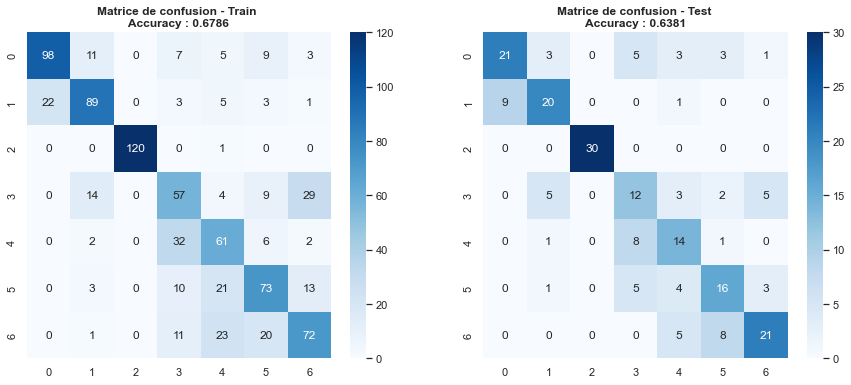

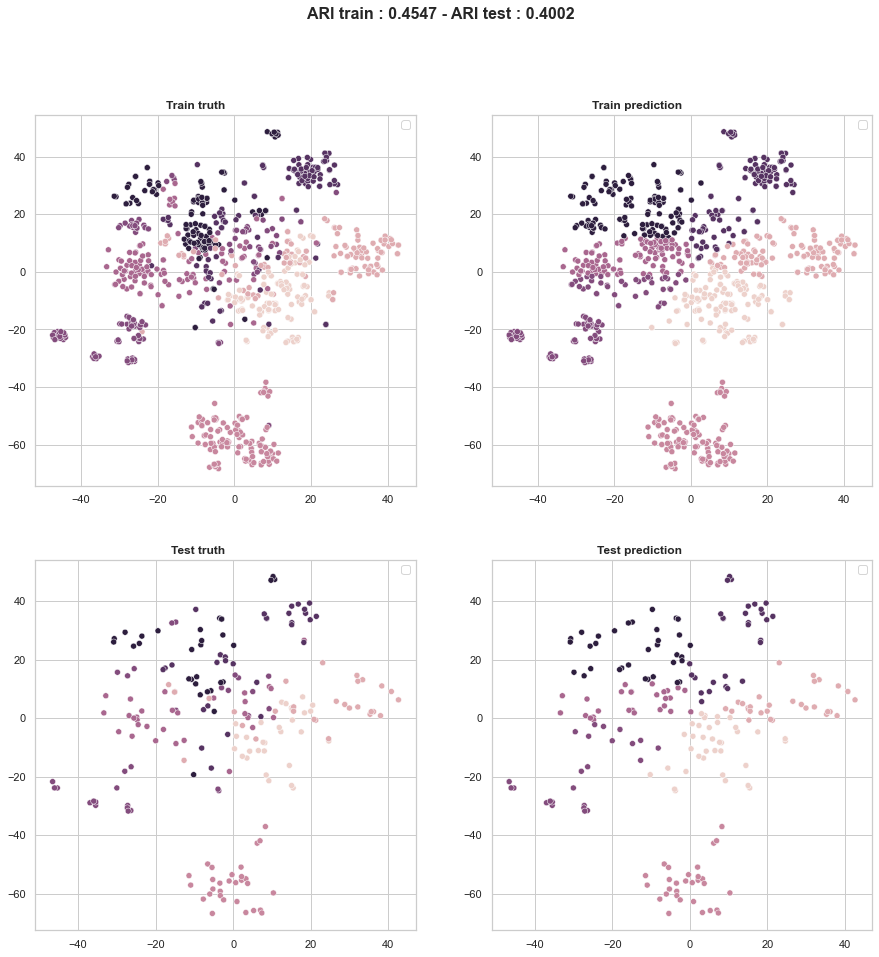

In [190]:
supervised_classification_visu(X_train_LR, y_train_predict_LR, y_train_LR, ARI_train_LR, X_test_LR, y_test_predict_LR, y_test, ARI_test_LR)

### Tsne après classification

In [191]:
X_train_LR, y_train_predict_LR, y_train_LR, ARI_train_LR, X_test_LR, y_test_predict_LR, y_test, ARI_test_LR = supervised_classification(CountVect, categories_num, LogisticRegression(dual=False))

score_train : 0.9940476190476191
score_test : 0.9238095238095239


Precision : 0.9238095238095239 
Recall : 0.9256199937025854


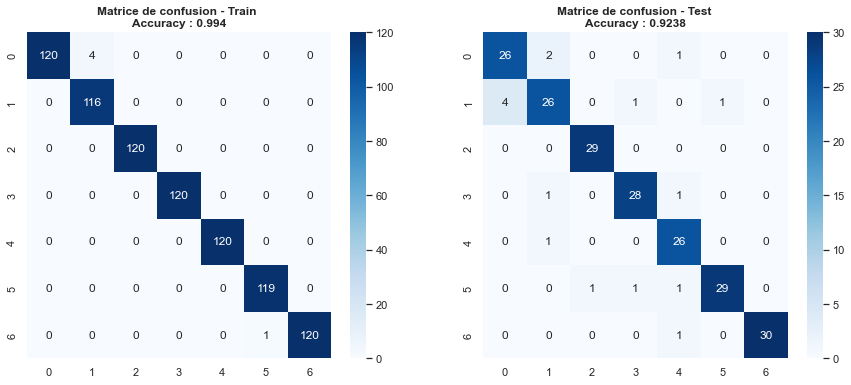

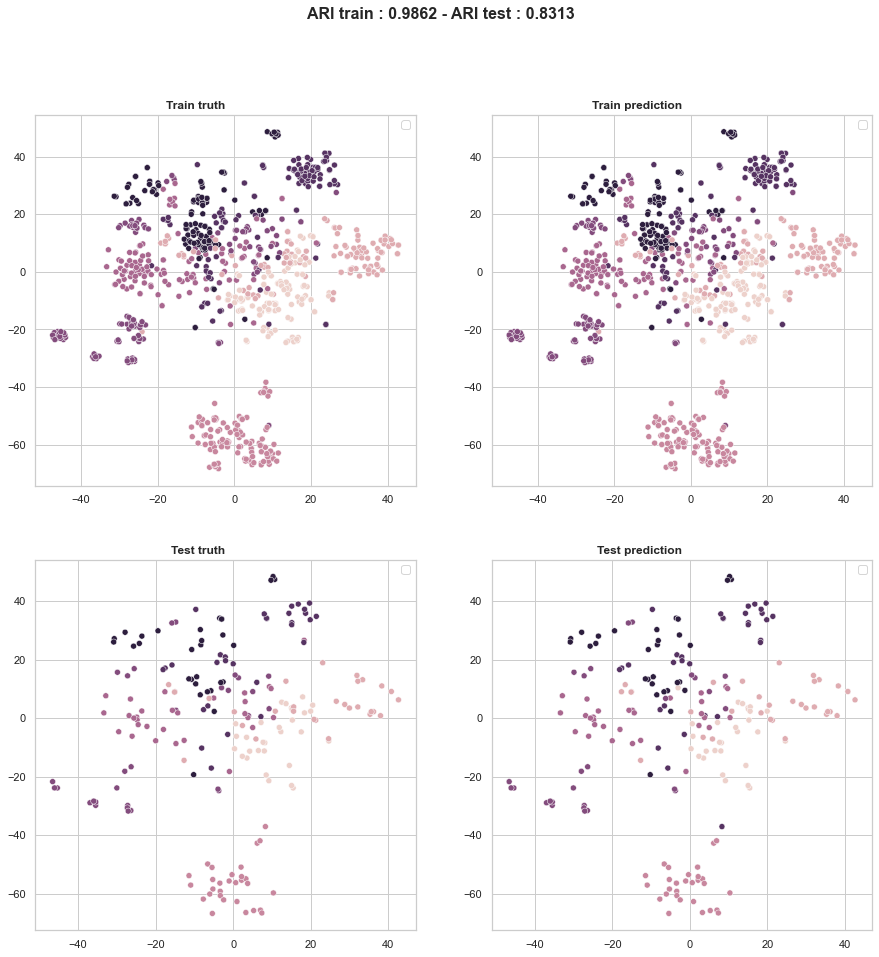

In [192]:
supervised_classification_visu_with_tsne(CountVect, X_train_LR, y_train_predict_LR, y_train_LR, ARI_train_LR, X_test_LR, y_test_predict_LR, y_test, ARI_test_LR)

### Tsne après classification - tfidfvect

In [193]:
X_train_LR, y_train_predict_LR, y_train_LR, ARI_train_LR, X_test_LR, y_test_predict_LR, y_test, ARI_test_LR = supervised_classification(tfidfvect, 
categories_num, LogisticRegression())

score_train : 0.9845238095238096
score_test : 0.9285714285714286


Precision : 0.9285714285714286 
Recall : 0.93300051203277


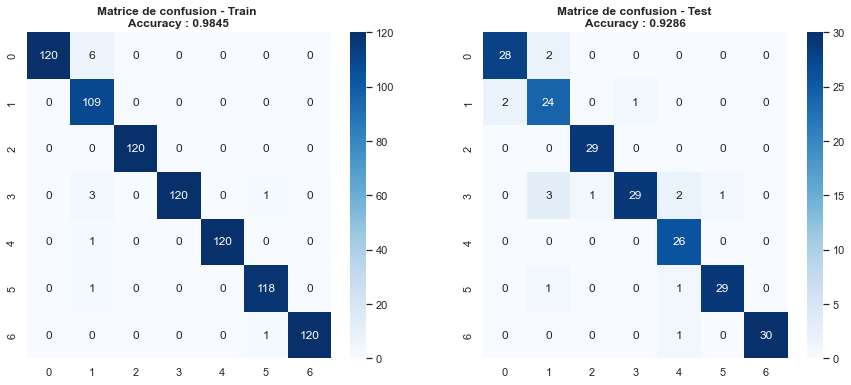

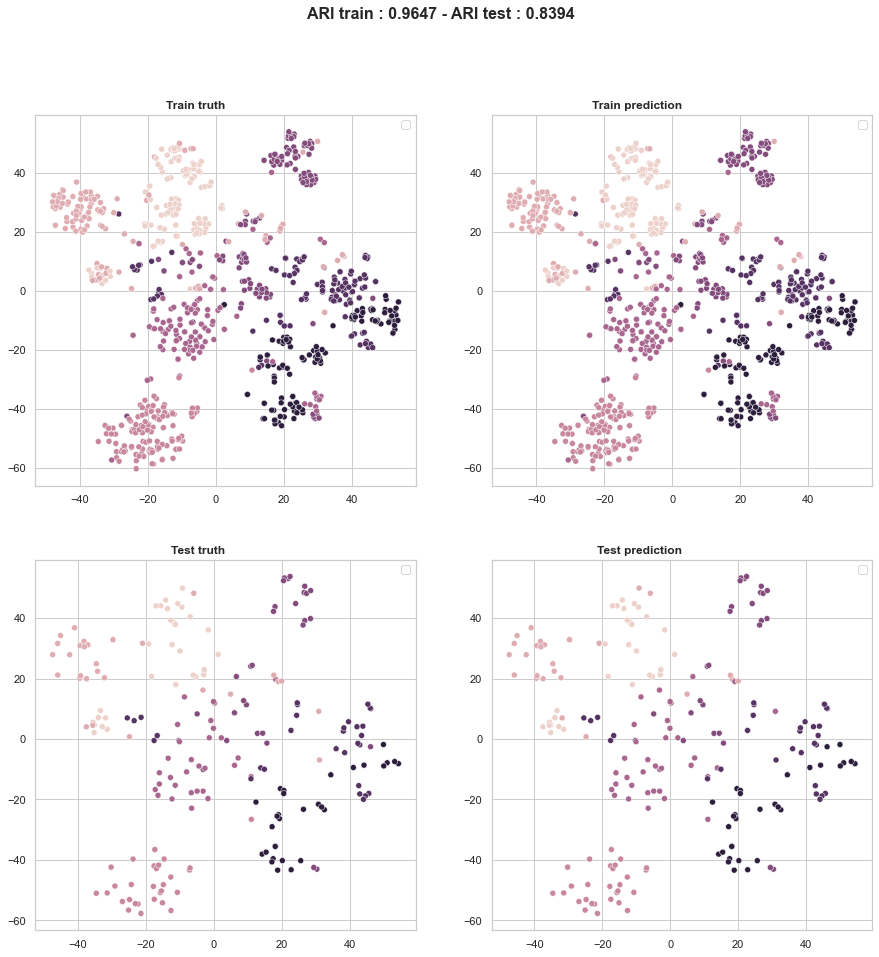

In [194]:
supervised_classification_visu_with_tsne(tfidfvect, X_train_LR, y_train_predict_LR, y_train_LR, ARI_train_LR, X_test_LR, y_test_predict_LR, y_test, ARI_test_LR)

## Naive Bayes

In [195]:
from sklearn.naive_bayes import MultinomialNB
estimator1 = MultinomialNB()

In [196]:
X_train_NB, y_train_predict_NB, y_train_NB, ARI_train_NB, X_test_NB, y_test_predict_NB, y_test_NB, ARI_test_NB = supervised_classification(CountVect, categories_num, MultinomialNB())

score_train : 0.9321428571428572
score_test : 0.8857142857142857


Precision : 0.8857142857142858 
Recall : 0.8940437538651825


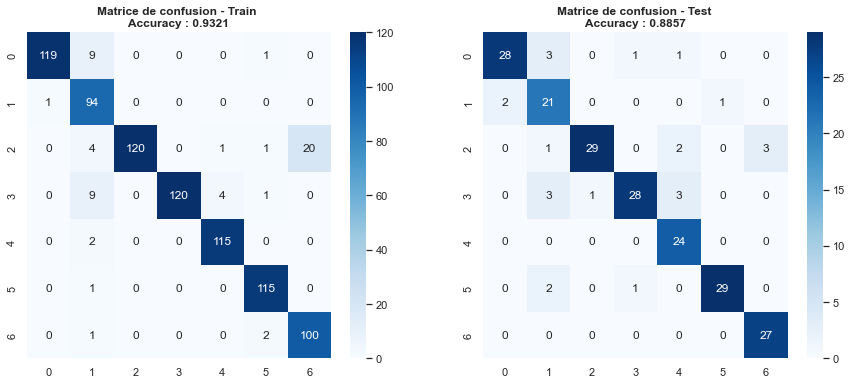

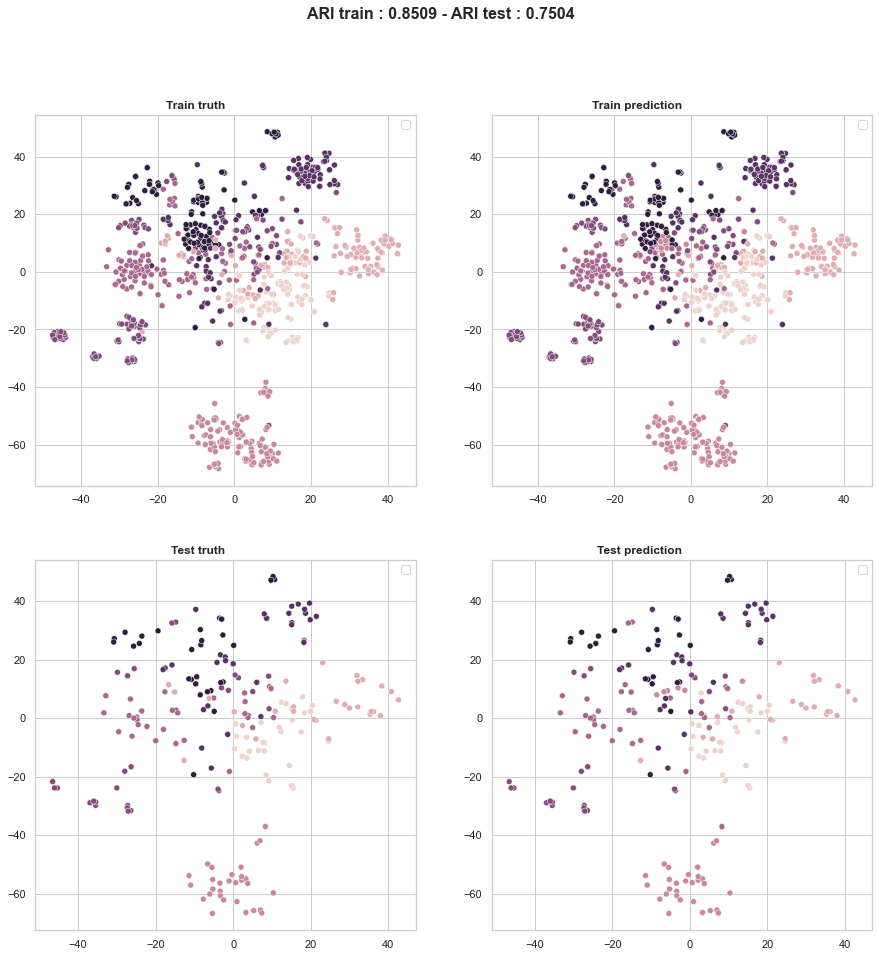

In [197]:
supervised_classification_visu_with_tsne(CountVect, X_train_NB, y_train_predict_NB, y_train_NB, ARI_train_NB, X_test_NB, y_test_predict_NB, y_test_NB, ARI_test_NB)

## SVC
### Tsne avant classification

In [198]:
from sklearn.svm import SVC

In [199]:
estimator2 = SVC()

In [200]:
X_train_SVC, y_train_predict_SVC, y_train_SVC, ARI_train_SVC, X_test_SVC, y_test_predict_SVC, y_test_SVC, ARI_test_SVC = supervised_classification_with_tsne(CountVect, categories_num, estimator2)

score_train : 0.7559523809523809
score_test : 0.7095238095238096


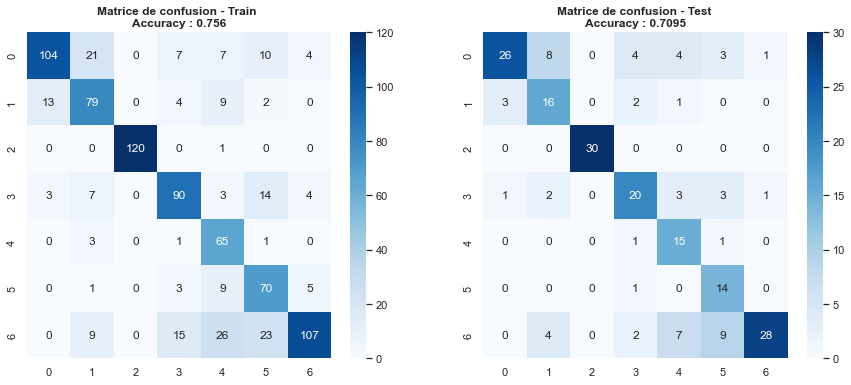

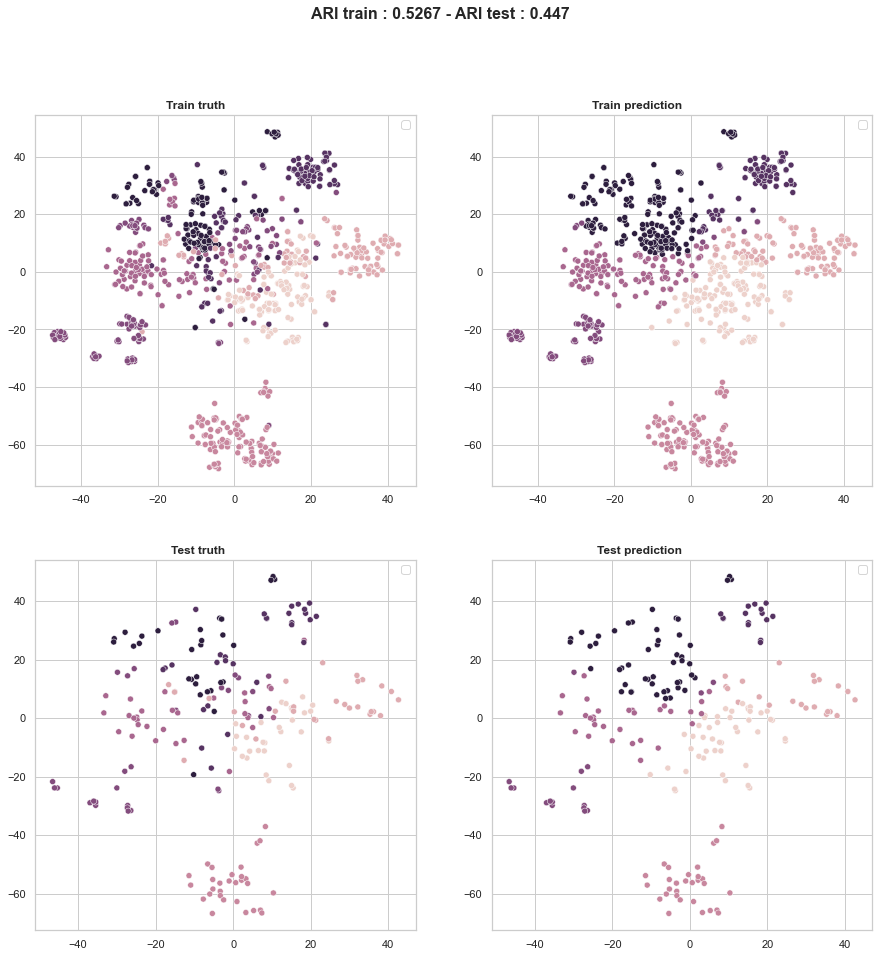

In [201]:
supervised_classification_visu(X_train_SVC, y_train_predict_SVC, y_train_SVC, ARI_train_SVC, X_test_SVC, y_test_predict_SVC, y_test_SVC, ARI_test_SVC)

### Tsne après classification

In [202]:
X_train_SVC, y_train_predict_SVC, y_train_SVC, ARI_train_SVC, X_test_SVC, y_test_predict_SVC, y_test_SVC, ARI_test_SVC = supervised_classification(CountVect, categories_num, estimator2)

score_train : 0.9654761904761905
score_test : 0.8761904761904762


Precision : 0.8761904761904763 
Recall : 0.8961451247165534


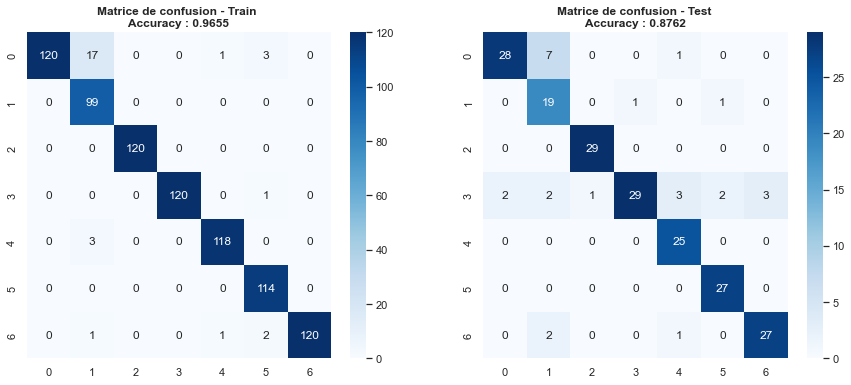

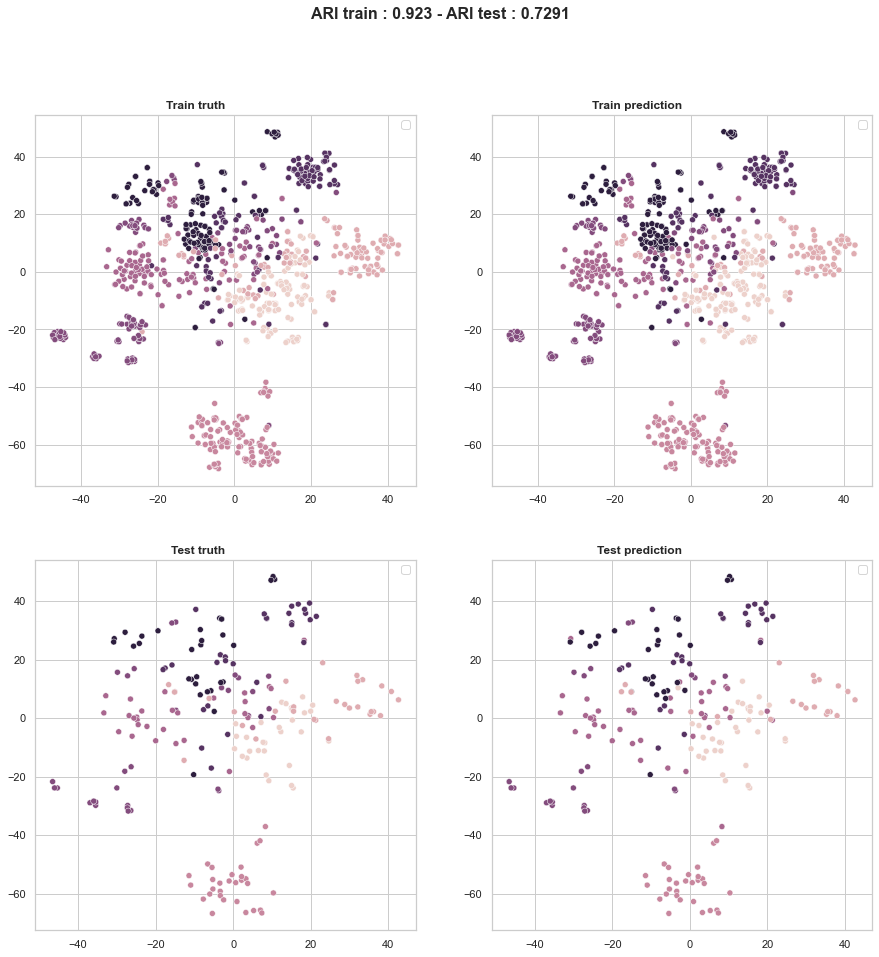

In [203]:
supervised_classification_visu_with_tsne(CountVect, X_train_SVC, y_train_predict_SVC, y_train_SVC, ARI_train_SVC, X_test_SVC, y_test_predict_SVC, y_test_SVC, ARI_test_SVC)

## KNN
### Tsne avant classification

In [204]:
from sklearn.neighbors import KNeighborsClassifier

In [205]:
estimator3 = KNeighborsClassifier(n_neighbors=3)

In [206]:
X_train_KNN, y_train_predict_KNN, y_train_KNN, ARI_train_KNN, X_test_KNN, y_test_predict_KNN, y_test_KNN, ARI_test_KNN = supervised_classification_with_tsne(CountVect, categories_num, estimator3)

score_train : 0.9369047619047619
score_test : 0.8428571428571429


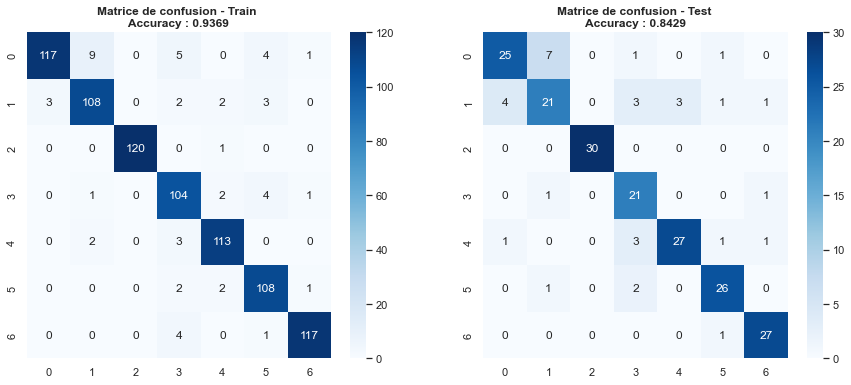

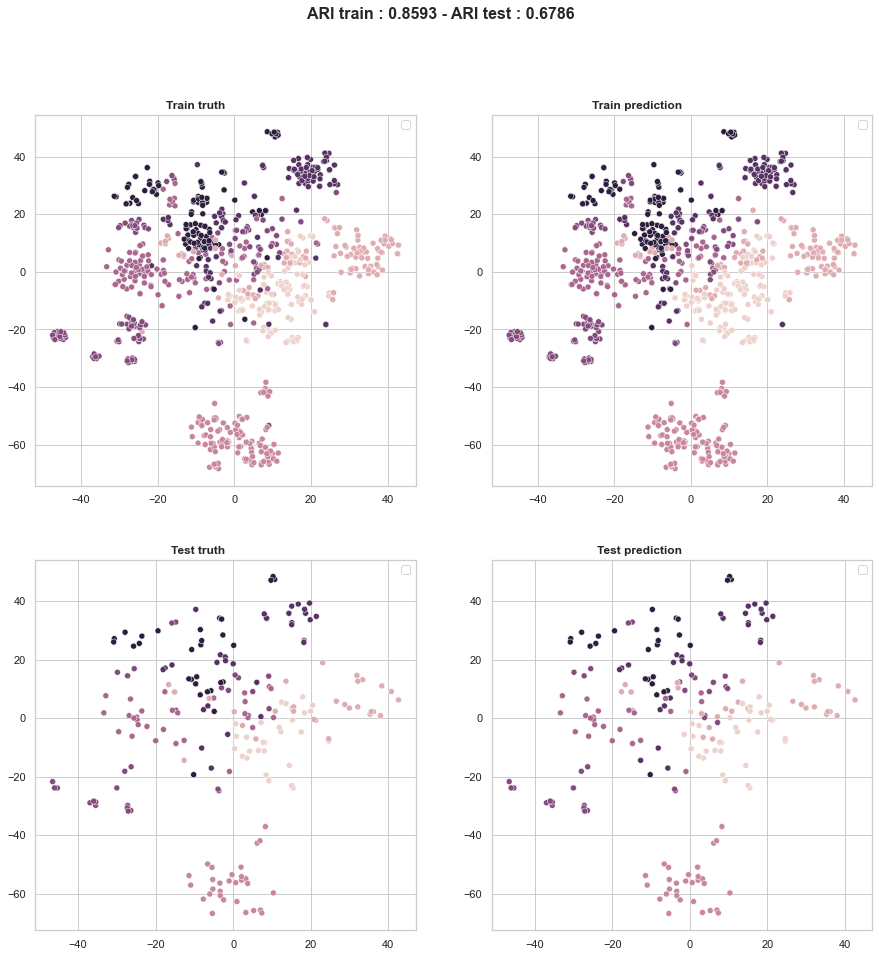

In [207]:
supervised_classification_visu(X_train_KNN, y_train_predict_KNN, y_train_KNN, ARI_train_KNN, X_test_KNN, y_test_predict_KNN, y_test_KNN, ARI_test_KNN)

In [208]:
X_train_KNN, y_train_predict_KNN, y_train_KNN, ARI_train_KNN, X_test_KNN, y_test_predict_KNN, y_test_KNN, ARI_test_KNN = supervised_classification(CountVect, categories_num, estimator3)

score_train : 0.9119047619047619
score_test : 0.8095238095238095


Precision : 0.8095238095238095 
Recall : 0.8472151831907929


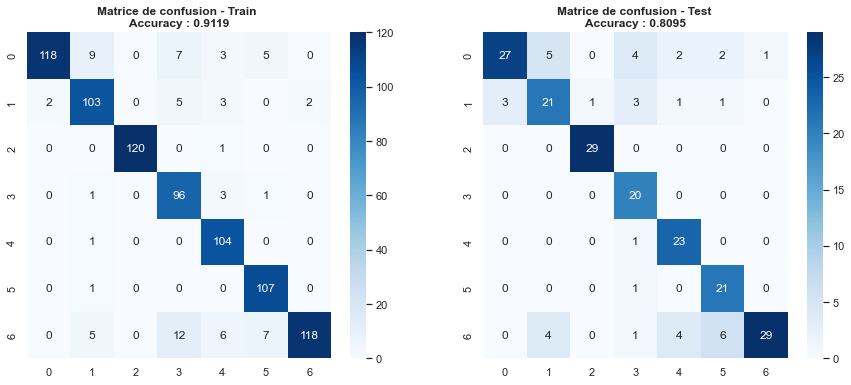

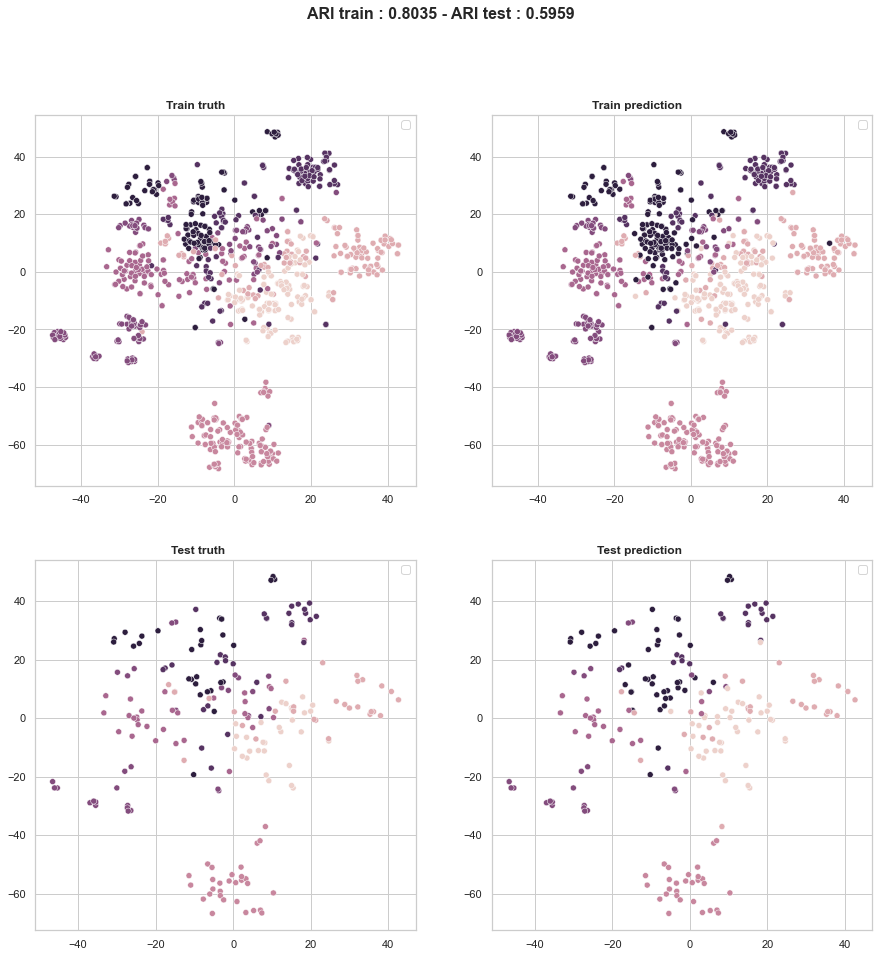

In [209]:
supervised_classification_visu_with_tsne(CountVect, X_train_KNN, y_train_predict_KNN, y_train_KNN, ARI_train_KNN, X_test_KNN, y_test_predict_KNN, y_test_KNN, ARI_test_KNN)

### Tsne avant classification - tfidfvect

In [210]:
X_train_KNN, y_train_predict_KNN, y_train_KNN, ARI_train_KNN, X_test_KNN, y_test_predict_KNN, y_test_KNN, ARI_test_KNN = supervised_classification_with_tsne(tfidfvect, 
categories_num, estimator3)

score_train : 0.9464285714285714
score_test : 0.9


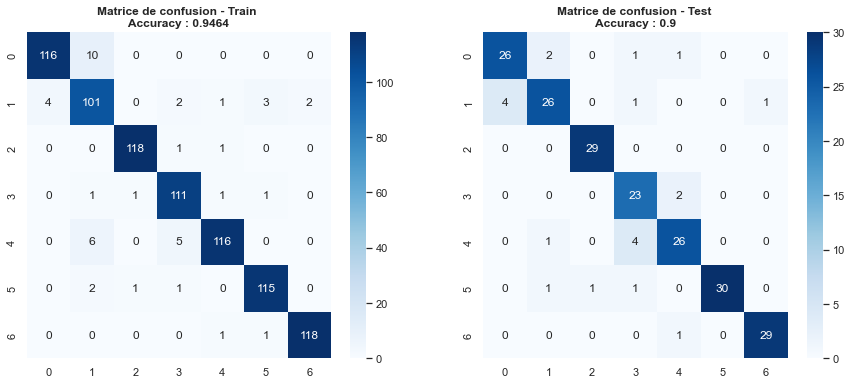

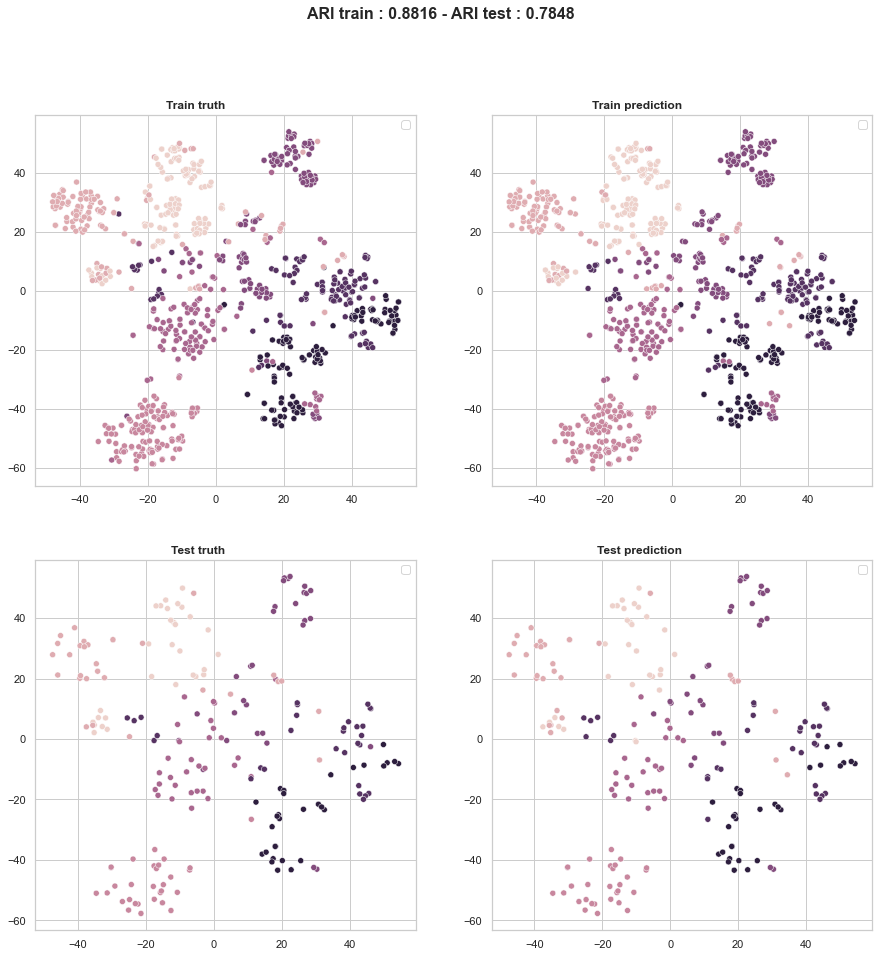

In [211]:
supervised_classification_visu(X_train_KNN, y_train_predict_KNN, y_train_KNN, ARI_train_KNN, X_test_KNN, y_test_predict_KNN, y_test_KNN, ARI_test_KNN)

# Essai de suppression article, adv, prep, pronom, etc

In [212]:
nltk.download('brown')
  
from nltk.corpus import brown
from nltk.tag import UnigramTagger
tagger = UnigramTagger(brown.tagged_sents(categories='news')[:10000])

[nltk_data] Downloading package brown to /Users/aleth/nltk_data...
[nltk_data]   Package brown is already up-to-date!


In [213]:
sent = ['Mitchell', 'tell', 'the', 'high', 'rate', 'of', 'unemployment', 'print', 'is', 'very', 'truly', 'to', 'but', 'she', 'it']
for word, tag in tagger.tag(sent):
    print(word, '->', tag)

Mitchell -> NP
tell -> VB
the -> AT
high -> JJ
rate -> NN
of -> IN
unemployment -> NN
print -> None
is -> BEZ
very -> QL
truly -> RB
to -> TO
but -> CC
she -> PPS
it -> PPS


In [214]:
def tag_and_keep(text):
    tagger = UnigramTagger(brown.tagged_sents()[:10000])
    text_taged = [w for w,tag in tagger.tag(text) if not tag in ['RB', 'AT', 'IN', 'TO', 'QL', 'CC', 'PPS']]
    return text_taged
 

In [215]:
test3 = "the girl goes to school every day during the week but she does'nt like it"
tokenizer = nltk.RegexpTokenizer(r'\w+')
text_tokenized  = tokenizer.tokenize(test3.lower())
tag_and_keep(text_tokenized)

['girl', 'goes', 'school', 'day', 'week', 'does', 'nt', 'like']

In [216]:
def transform_text2(text, stopwords=None, len_words=2, lemm_or_stemm ='lemm', not_a_number=True, stopwords_complement=None):
    """
    Lower, exclude stopwords, exclude words smaller than len_words letters, 
    lemmanize or stemmetize, exclude number if not_a_number=True, exclude stopwords_complement, exclude 'RB', 'AT', 'IN', 'TO', 'QL', 'CC', 'PPS'
    
    Positionnal argument:
    ---------------------------
    text : str: keys=identity, values=text to process
    
    Opt args :
    ---------------------------
    stopwords : list : list of words to exclude
    len_words : int : length mini of a word to be kept
    lemm_or_stemm : 'stemm' or 'lemm'
    not_a_number : bool : if True, exclude numbers
    stopwords_complement : list : list of complement words to exclude
    
    Return:
    ---------------------------
    text_alpha : list = text transformed
    """
    tokenizer = nltk.RegexpTokenizer(r'\w+')
    tagger = UnigramTagger(brown.tagged_sents()[:1000])
    lemmatizer = WordNetLemmatizer()
    stemmer = SnowballStemmer('english')
    if stopwords==None:
        stopwords = []
    text_tokenized  = tokenizer.tokenize(text.lower())
    text_tokenized_taged = [w for w,tag in tagger.tag(text_tokenized) if not tag in ['RB', 'AT', 'IN', 'TO', 'QL', 'CC', 'PPS']]
    text_stopped = [w for w in text_tokenized_taged if not w in stopwords]
    if lemm_or_stemm == 'lemm':
        text_transformed = [lemmatizer.lemmatize(w) for w in text_stopped]
    elif lemm_or_stemm == 'stemm':
        text_transformed = [stemmer.stem(w) for w in text_stopped]
    else:
        text_transformed = [w for w in text_stopped]
    text_filtered = [w for w in text_transformed if len(w)>len_words]
    text_filtered = [w for w in text_filtered if not w in stopwords_complement]
    if not_a_number:
        text_filtered = [w for w in text_filtered if w.isalpha()]
        
    return text_filtered

In [217]:
def countvectorise_text_fmin_name(document, stopwords, len_words, lemm_or_stemm, not_a_number, stopwords_complement, freq_min):
    """
     1 - Transform document
    Lower, exclude stopwords, exclude words smaller than len_words letters, lemmanize or stemmatize, 
    exclude number if not_a_number=True, exclude stopwords_complement, exclude 'RB', 'AT', 'IN', 'TO', 'QL', 'CC', 'PPS'
    
    2 - CountVectorize document transformed
    
    Positionnal argument:
    ---------------------------
    document : list or serie of texts : list of texts to process
    stopwords : list : list of words to exclude
    len_words : int : length mini of a word to be kept
    lemm_or_stemm : 'stemm' or 'lemm'
    not_a_number : bool : if True, exclude numbers
    stopwords_complement : list : list of complement words to exclude
    
    Return:
    ---------------------------
    df : dataframe : columns = words
                   rows = texts in document
                   values = number of words in text
    frequence : Serie : index = words
                        values = number of words in document
    """
    def transform(text):
        text_transformed = transform_text2(text, 
                                          stopwords=stopwords, 
                                          len_words=len_words, 
                                          lemm_or_stemm =lemm_or_stemm, 
                                          not_a_number=not_a_number, 
                                          stopwords_complement=stopwords_complement)
        return text_transformed
    cvect = CountVectorizer(tokenizer=transform)
    cv_fit = cvect.fit(document)
    cv_transform = cvect.transform(document)
    columns_cv = ordered_list(cvect.vocabulary_)
    df = pd.DataFrame(columns=columns_cv, data=cv_transform.toarray())
    frequence = df.sum(axis=0)
    mask = frequence<freq_min
    rare_words = list(frequence[mask].index)
    other_words = list(frequence[~mask].index)
    df1 = df.loc[:, other_words]
    frequence1 = df1.sum(axis=0)
    return df1, frequence1

In [218]:
def tfidfvectorizer_text_fmin_name(document, stopwords, len_words, lemm_or_stemm, not_a_number, stopwords_complement, freq_min):
    """
     1 - Transform document
    Lower, exclude stopwords, exclude words smaller than len_words letters, lemmanize or stemmatize, 
    exclude number if not_a_number=True, exclude stopwords_complement, exclude 'RB', 'AT', 'IN', 'TO', 'QL', 'CC', 'PPS'
    
    2 - TfidfVectorize document transformed
    
    Positionnal argument:
    ---------------------------
    document : list or serie of texts : list of texts to process
    stopwords : list : list of words to exclude
    len_words : int : length mini of a word to be kept
    lemm_or_stemm : 'stemm' or 'lemm'
    not_a_number : bool : if True, exclude numbers
    stopwords_complement : list : list of complement words to exclude
    
    Return:
    ---------------------------
    df : dataframe : columns = words
                   rows = texts in document
                   values = number of words in text
    frequence : Serie : index = words
                        values = number of words in document
    """
    def transform(text):
        text_transformed = transform_text2(text, 
                                          stopwords=stopwords, 
                                          len_words=len_words, 
                                          lemm_or_stemm =lemm_or_stemm, 
                                          not_a_number=not_a_number, 
                                          stopwords_complement=stopwords_complement)
        return text_transformed
    ctf = TfidfVectorizer(tokenizer=transform)
    ctf_fit = ctf.fit(document)
    ctf_transform = ctf.transform(document) 
    columns_ctf = ordered_list(ctf.vocabulary_)
    df = pd.DataFrame(columns=columns_ctf, data=ctf_transform.toarray())
    frequence_pond = df.sum(axis=0)
    mask = frequence_pond<freq_min
    rare_words = list(frequence_pond[mask].index)
    other_words = list(frequence_pond[~mask].index)
    df1 = df.loc[:, other_words]
    frequence_pond1 = df1.sum(axis=0)
    return df1, frequence_pond1

In [219]:
non_significativ_words = ['product', 'free', 'buy', 'ship', 'deliveri', 'price', 'featur', 'key', 'cash', 'day', 'com']

In [220]:
#CountVect_N, frequence_N = countvectorise_text_fmin_name(text['description'], stopwords_base, 2, 'stemm', True, non_significativ_words, 2)
#CountVect_N.shape

In [221]:
#nb_clusters = len(categories['category1'].unique())
#categories_num = categories['category1']

In [222]:
#ARI_score_cv_N, Xtsne_cv_N, labels_cv_N, time_cv_N = ARI_fct(CountVect_N, nb_clusters, categories_num)

In [223]:
#TSNE_visu_fct(ARI_score_cv_N, Xtsne_cv_N, labels_cv_N, time_cv_N, categories_num )

In [224]:
tfidf_N, frequence_N2 = tfidfvectorizer_text_fmin_name(text['product_name'], stopwords_base, 2, 'stemm', True, non_significativ_words, 2)
tfidf_N.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 245)

In [606]:
ARI_score_cv_N, Xtsne_cv_N, labels_cv_N, time_cv_N = ARI_fct(tfidf_N, nb_clusters, categories_num, 30, 3000)

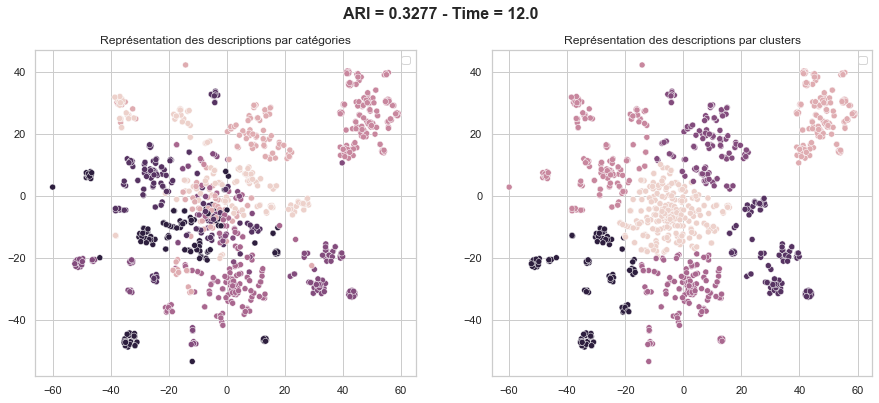

In [607]:
TSNE_visu_fct(ARI_score_cv_N, Xtsne_cv_N, labels_cv_N, time_cv_N, categories_num )

In [227]:
#X_train_LR_name, y_train_predict_LR_name, y_train_LR_name, ARI_train_LR_name, X_test_LR_name, y_test_predict_LR_name, y_test_LR_name, ARI_test_LR_name = supervised_classification(tfidf_N, 
#categories_num, LogisticRegression())

In [228]:
#supervised_classification_visu_with_tsne(tfidf_N, X_train_LR_name, y_train_predict_LR_name, y_train_LR_name, ARI_train_LR_name, X_test_LR_name, y_test_predict_LR_name, y_test_LR_name, ARI_test_LR_name)

# fit(Name) - transform(Name+description)

In [229]:
def countvectorise_text_bis(document1, document2, stopwords, len_words, lemm_or_stemm, not_a_number, stopwords_complement):
    """
     1 - Transform document1 + document2
    Lower, exclude stopwords, exclude words smaller than len_words letters, lemmanize or stemmatize, 
    exclude number if not_a_number=True, exclude stopwords_complement, exclude 'RB', 'AT', 'IN', 'TO', 'QL', 'CC', 'PPS'
    
    2 - CountVectorize document1 + document2 transformed
    
    Positionnal argument:
    ---------------------------
    document1, document2 : list or serie of texts : list of texts to process
    stopwords : list : list of words to exclude
    len_words : int : length mini of a word to be kept
    lemm_or_stemm : 'stemm' or 'lemm'
    not_a_number : bool : if True, exclude numbers
    stopwords_complement : list : list of complement words to exclude
    
    Return:
    ---------------------------
    df : dataframe : columns = words
                   rows = texts in document
                   values = number of words in text
    frequence : Serie : index = words
                        values = number of words in document
    """
    def transform(text):
        text_transformed = transform_text(text, 
                                          stopwords=stopwords, 
                                          len_words=len_words, 
                                          lemm_or_stemm =lemm_or_stemm, 
                                          not_a_number=not_a_number, 
                                          stopwords_complement=stopwords_complement)
        return text_transformed
    cvect = CountVectorizer(tokenizer=transform)
    cv_fit = cvect.fit(document1)
    cv_transform = cvect.transform(document1+document2)
    columns_cv = ordered_list(cvect.vocabulary_)
    df = pd.DataFrame(columns=columns_cv, data=cv_transform.toarray())
    frequence = df.sum(axis=0)
    return df, frequence

In [230]:
def countvectorise_text_fmin_bis(document1, document2, stopwords, len_words, lemm_or_stemm, not_a_number, stopwords_complement, freq_min):
    """
     1 - Transform document1, document2
    Lower, exclude stopwords, exclude words smaller than len_words letters, lemmanize or stemmatize, 
    exclude number if not_a_number=True, exclude stopwords_complement, exclude words if frequence lower than freq_min
    
    2 - CountVectorize document1, document2 transformed
    
    Positionnal argument:
    ---------------------------
    document1, document2 : list or serie of texts : list of texts to process
    stopwords : list : list of words to exclude
    len_words : int : length mini of a word to be kept
    lemm_or_stemm : 'stemm' or 'lemm'
    not_a_number : bool : if True, exclude numbers
    stopwords_complement : list : list of complement words to exclude
    freq_min : int : exclude word if freq < freq_min
    
    Return:
    ---------------------------
    df : dataframe : columns = words
                   rows = texts in document
                   values = number of words in text
    frequence : Serie : index = words
                        values = number of words in document
    """
        
    def transform(text):
        text_transformed = transform_text(text, 
                                          stopwords=stopwords, 
                                          len_words=len_words, 
                                          lemm_or_stemm =lemm_or_stemm, 
                                          not_a_number=not_a_number, 
                                          stopwords_complement=stopwords_complement)
        return text_transformed
    cvect = CountVectorizer(tokenizer=transform)
    cv_fit = cvect.fit(document1)
    cv_transform = cvect.transform(document1+document2)
    columns_cv = ordered_list(cvect.vocabulary_)
    df = pd.DataFrame(columns=columns_cv, data=cv_transform.toarray())
    frequence = df.sum(axis=0)
    mask = frequence<freq_min
    rare_words = list(frequence[mask].index)
    other_words = list(frequence[~mask].index)
    df1 = df.loc[:, other_words]
    frequence1 = df1.sum(axis=0)
    return df1, frequence1

## Non supervisé
### CountVect 

#### Stemm

In [231]:
non_significativ_words = ['product', 'free', 'buy', 'ship', 'deliveri', 'price', 'featur', 'key', 'cash', 'day', 'com']
CountVect_bis, frequence_bis = countvectorise_text_fmin_bis(text['product_name'], text['description'], stopwords_base, 2, 'stemm', True, non_significativ_words, 2)
CountVect_bis.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 1661)

In [232]:
ARI_score_cv_bis, Xtsne_cv_bis, labels_cv_bis, time_cv_bis = ARI_fct(CountVect_bis, nb_clusters, categories_num, 30, 750)

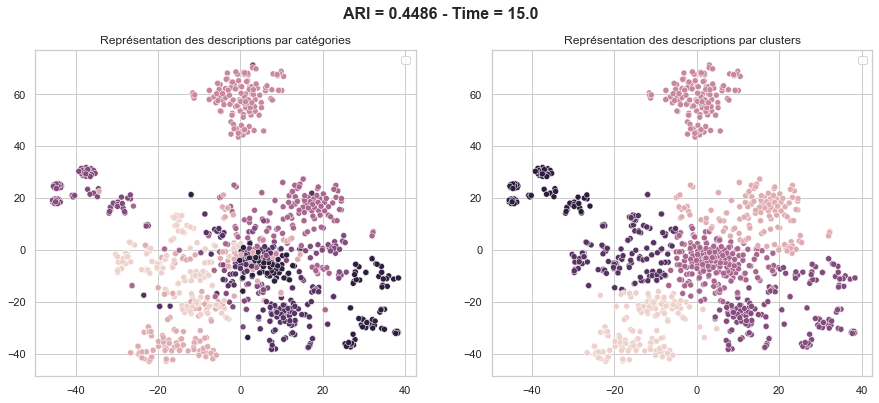

In [233]:
TSNE_visu_fct(ARI_score_cv_bis, Xtsne_cv_bis, labels_cv_bis, time_cv_bis, categories_num )

#### Lemmatize

In [234]:
CountVect_bis1, frequence_bis1 = countvectorise_text_fmin_bis(text['product_name'], text['description'], stopwords_base, 2, 'lemm', True, non_significativ_words, 2)
CountVect_bis1.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 1703)

In [235]:
ARI_score_cv_bis1, Xtsne_cv_bis1, labels_cv_bis1, time_cv_bis1 = ARI_fct(CountVect_bis1, nb_clusters, categories_num, 30, 750)

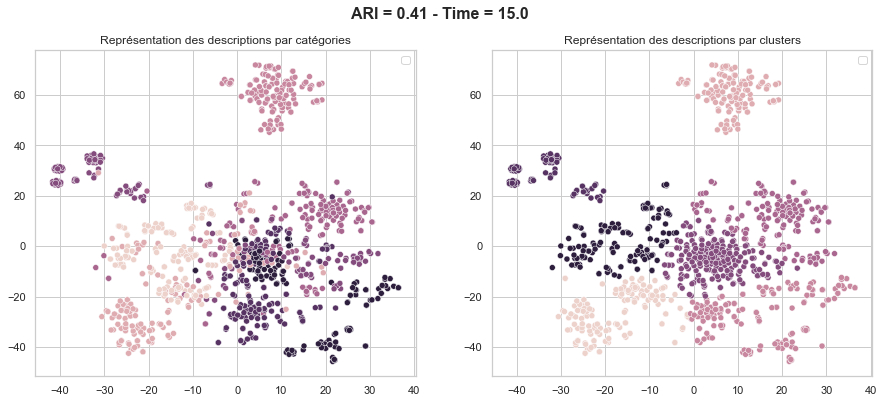

In [236]:
TSNE_visu_fct(ARI_score_cv_bis1, Xtsne_cv_bis1, labels_cv_bis1, time_cv_bis1, categories_num )

### tfidfvect 

In [237]:
def tfidfvectorizer_text_fmin_bis(document1, document2, stopwords, len_words, lemm_or_stemm, not_a_number, stopwords_complement, freq_min):
    """
     1 - Transform document1, document2
    Lower, exclude stopwords, exclude words smaller than len_words letters, lemmanize or stemmatize, 
    exclude number if not_a_number=True, exclude stopwords_complement, exclude words if frequence lower than freq_min
    
    2 - TfidfVectorize document1, document2 transformed
    
    Positionnal argument:
    ---------------------------
    document1, document2 : list or serie of texts : list of texts to process
    stopwords : list : list of words to exclude
    len_words : int : length mini of a word to be kept
    lemm_or_stemm : 'stemm' or 'lemm'
    not_a_number : bool : if True, exclude numbers
    stopwords_complement : list : list of complement words to exclude
    freq_min : int : exclude word if freq < freq_min
    
    Return:
    ---------------------------
    df : dataframe : columns = words
                   rows = texts in document
                   values = number of words in text
    frequence : Serie : index = words
                        values = number of words in document
    """
        
    def transform(text):
        text_transformed = transform_text(text, 
                                          stopwords=stopwords, 
                                          len_words=len_words, 
                                          lemm_or_stemm =lemm_or_stemm, 
                                          not_a_number=not_a_number, 
                                          stopwords_complement=stopwords_complement)
        return text_transformed
    ctf = TfidfVectorizer(tokenizer=transform)
    ctf_fit = ctf.fit(document1)
    ctf_transform = ctf.transform(document1+document2)
    columns_ctf = ordered_list(ctf.vocabulary_)
    df = pd.DataFrame(columns=columns_ctf, data=ctf_transform.toarray())
    frequence_pond = df.sum(axis=0)
    mask = frequence_pond<freq_min
    rare_words = list(frequence_pond[mask].index)
    other_words = list(frequence_pond[~mask].index)
    df1 = df.loc[:, other_words]
    frequence_pond1 = df1.sum(axis=0)
    return df1, frequence_pond1

#### Stemm

In [238]:
tfidfvect_bis, frequence_pond_bis = tfidfvectorizer_text_fmin_bis(text['product_name'], text['description'], stopwords_base, 2, 'stemm', True, non_significativ_words, 2)
frequence_pond_ordered_bis = frequence_pond_bis.sort_values( ascending=False)
tfidfvect_bis.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 347)

In [239]:
nb_clusters = len(categories['category1'].unique())
categories_num = categories['category1'].apply(lambda x: numerize(x))
nb_clusters

7

In [240]:
ARI_score_tdidf_bis, Xtsne_tdidf_bis, labels_tdidf_bis, time_tdidf_bis = ARI_fct(tfidfvect_bis, nb_clusters, categories_num, 31, 2000)

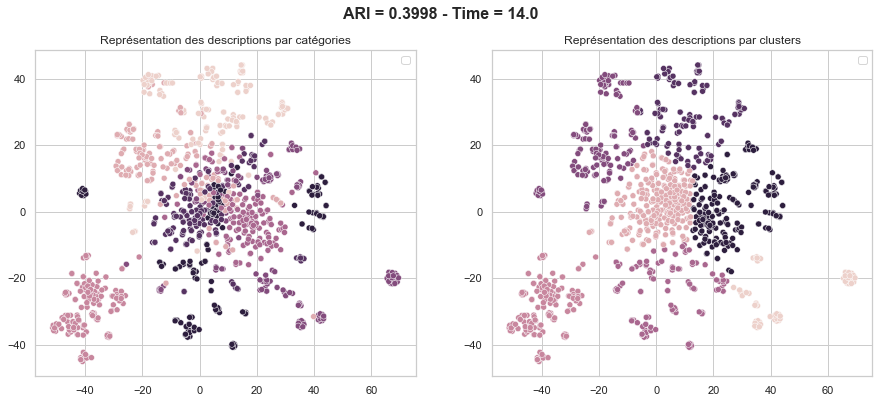

In [241]:
TSNE_visu_fct(ARI_score_tdidf_bis, Xtsne_tdidf_bis, labels_tdidf_bis, time_tdidf_bis, categories_num)

#### Lemmatize

In [275]:
tfidfvect_bis1, frequence_pond_bis1 = tfidfvectorizer_text_fmin_bis(text['product_name'], text['description'], stopwords_base, 2, 'lemm', True, non_significativ_words, 0.085)
tfidfvect_bis1.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:516: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


(1050, 1733)

In [276]:
ARI_score_tdidf_bis1, Xtsne_tdidf_bis1, labels_tdidf_bis1, time_tdidf_bis1 = ARI_fct(tfidfvect_bis1, nb_clusters, categories_num, 31, 2000)

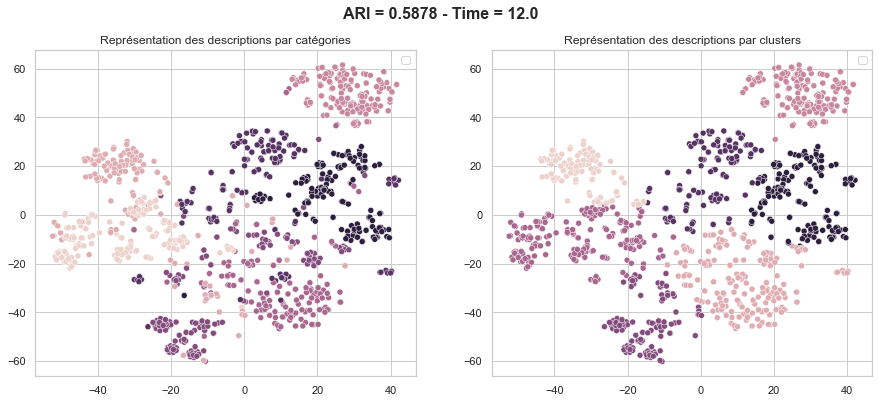

In [277]:
TSNE_visu_fct(ARI_score_tdidf_bis1, Xtsne_tdidf_bis1, labels_tdidf_bis1, time_tdidf_bis1, categories_num)

### Avec categories travaillées

In [278]:
nb_clusters2 = len(categories['cat'].unique())
categories_num2 = categories['cat']

In [279]:
nb_clusters2

16

In [280]:
ARI_score_tdidf_bis, Xtsne_tdidf_bis, labels_tdidf_bis, time_tdidf_bis = ARI_fct(tfidfvect_bis, nb_clusters2, categories_num2, 30, 750)

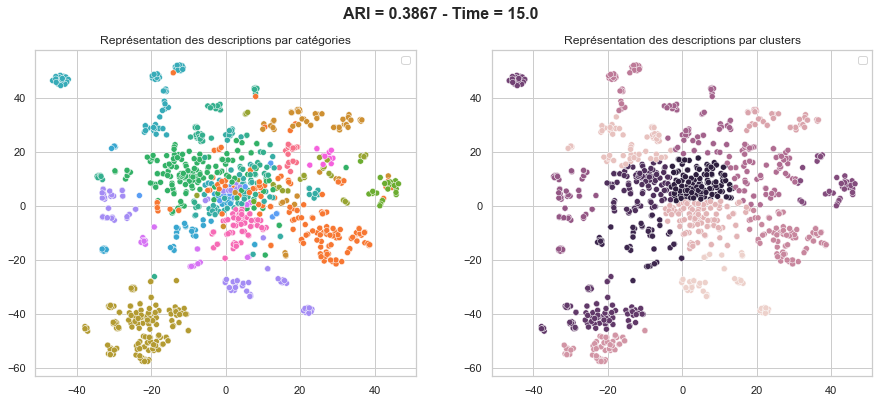

In [281]:
TSNE_visu_fct(ARI_score_tdidf_bis, Xtsne_tdidf_bis, labels_tdidf_bis, time_tdidf_bis, categories_num2)

## Supervisé
### Supervisé : logistique regression 

In [282]:
X_train_LR_N, y_train_predict_LR_N, y_train_LR_N, ARI_train_LR_N, X_test_LR_N, y_test_predict_LR_N, y_test_N, ARI_test_LR_N = supervised_classification(CountVect_bis, 
                                                                                                                                            categories_num, 
                                                                                                                                            LogisticRegression(dual=False))

score_train : 1.0
score_test : 0.9238095238095239


Precision : 0.9238095238095239 
Recall : 0.9259548801599493


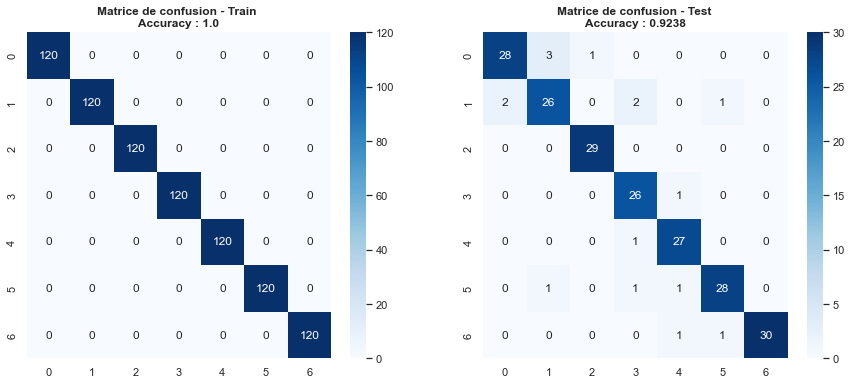

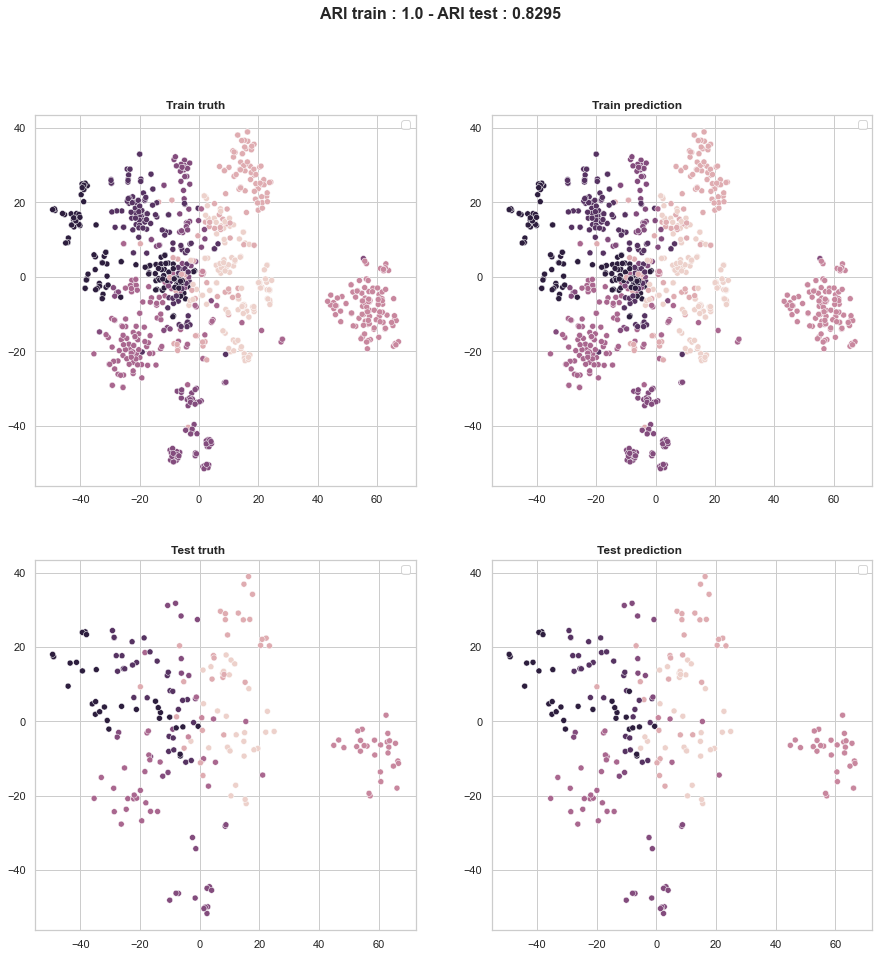

In [283]:
supervised_classification_visu_with_tsne(CountVect_bis, 
                                         X_train_LR_N, 
                                         y_train_predict_LR_N, 
                                         y_train_LR_N, 
                                         ARI_train_LR_N, 
                                         X_test_LR_N, 
                                         y_test_predict_LR_N, 
                                         y_test_N, 
                                         ARI_test_LR_N)

### Tsne après classification - tfidfvect

In [284]:
X_train_LR_N, y_train_predict_LR_N, y_train_LR_N, ARI_train_LR_N, X_test_LR_N, y_test_predict_LR_N, y_test_N, ARI_test_LR_N = supervised_classification(tfidfvect_bis1, 
                                                                                                                                            categories_num, 
                                                                                                                                            LogisticRegression(dual=False))

score_train : 0.986904761904762
score_test : 0.919047619047619


Precision : 0.9190476190476191 
Recall : 0.9230072042133752


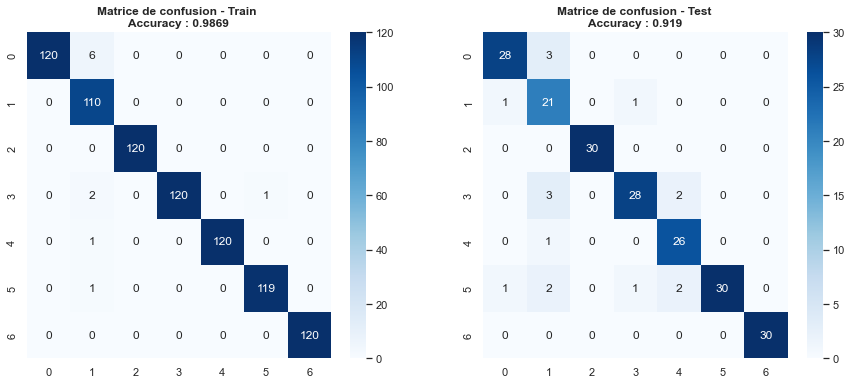

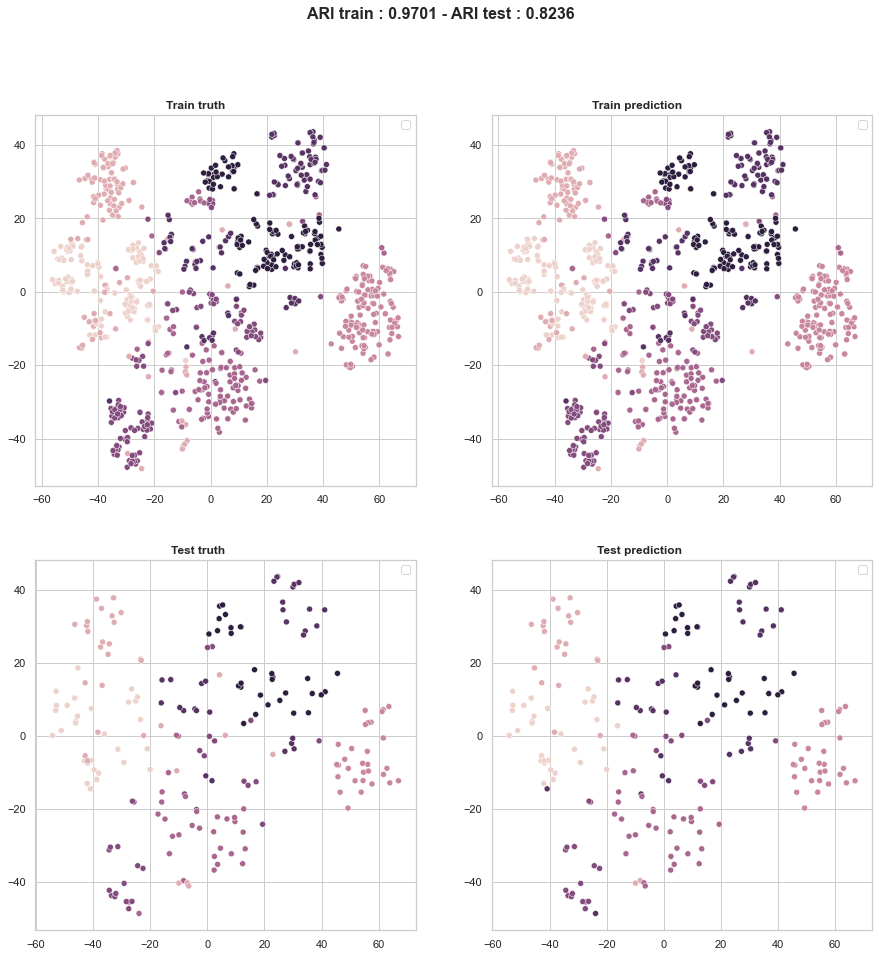

In [264]:
supervised_classification_visu_with_tsne(tfidfvect_bis1, X_train_LR_N, y_train_predict_LR_N, y_train_LR_N, ARI_train_LR_N, X_test_LR_N, y_test_predict_LR_N, y_test_N, ARI_test_LR_N)

## Reduction dimensionnelle PCA

In [253]:
from sklearn.decomposition import PCA

In [265]:
tfidfvect_bis1.shape

(1050, 1733)

In [309]:
# nombre de composantes à calculer
features = tfidfvect_bis1.columns
pca = PCA(n_components=800, svd_solver='full')
pca.fit(tfidfvect_bis1)

PCA(n_components=800, svd_solver='full')

In [310]:
# On transforme tfidfvect_bis en projetant sur les 800 premières directions
reduced_data = pd.DataFrame(pca.transform(tfidfvect_bis1))
reduced_data.shape

(1050, 800)

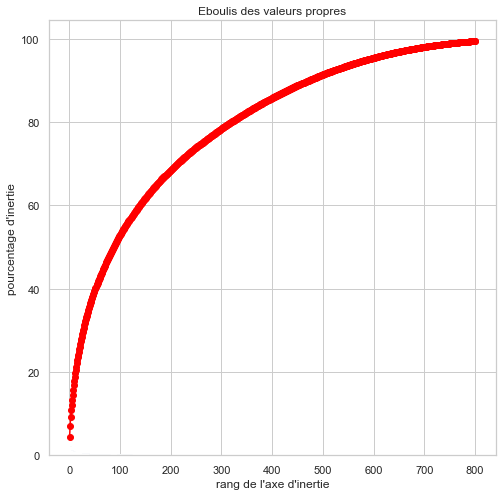

In [311]:
# Eboulis des valeurs propres
scree = pca.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")


### Non supervisé

<AxesSubplot:xlabel='0', ylabel='1'>

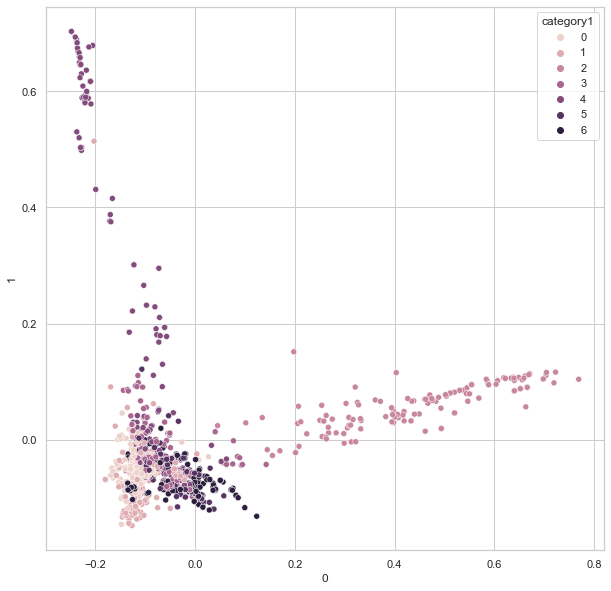

In [312]:
fig, ax = plt.subplots(figsize=(10, 10))
sns.scatterplot(x=reduced_data[0], y=reduced_data[1], hue=categories_num)

In [612]:
ARI_score_tdidf_bis_reduced, Xtsne_tdidf_bis_reduced, labels_tdidf_bis_reduced, time_tdidf_bis_reduced = ARI_fct(reduced_data, 
                                                                                                                 nb_clusters, 
                                                                                                                 categories_num, 31, 1500)

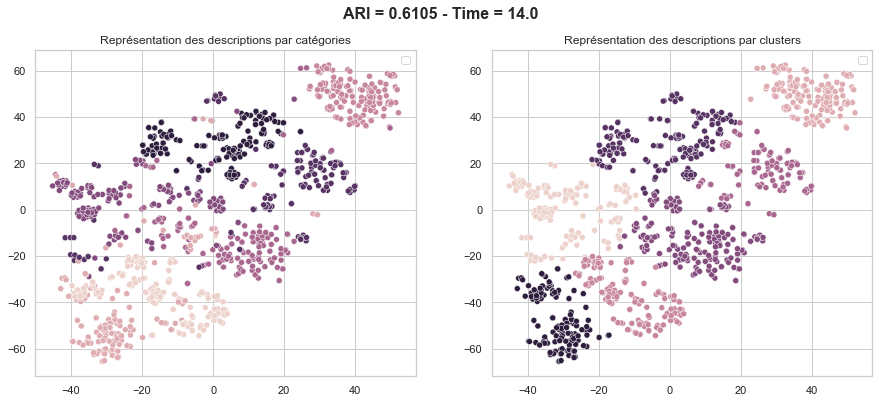

In [613]:
TSNE_visu_fct(ARI_score_tdidf_bis_reduced, Xtsne_tdidf_bis_reduced, labels_tdidf_bis_reduced, time_tdidf_bis_reduced, categories_num )

### Supervisé

In [315]:
X_train_LR_reduced, y_train_predict_LR_reduced, y_train_LR_reduced, ARI_train_LR_reduced, X_test_LR_reduced, y_test_predict_LR_reduced, y_test_reduced, ARI_test_LR_reduced = supervised_classification(reduced_data, 
                                                                                                                                            categories_num, 
                                                                                                                                            LogisticRegression(dual=False))

score_train : 0.986904761904762
score_test : 0.919047619047619


Precision : 0.9190476190476191 
Recall : 0.9230072042133752


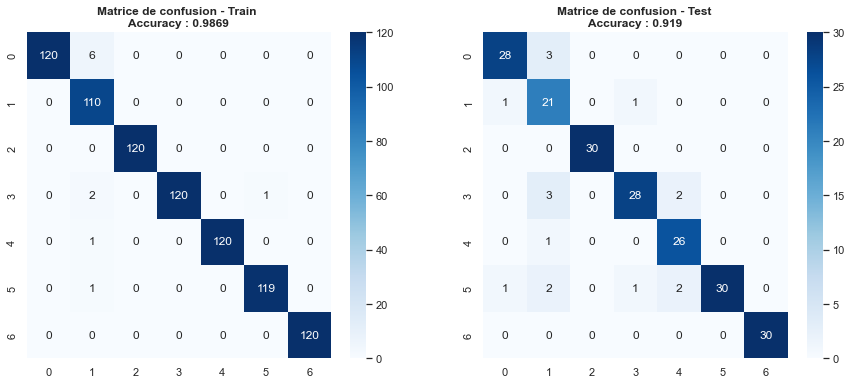

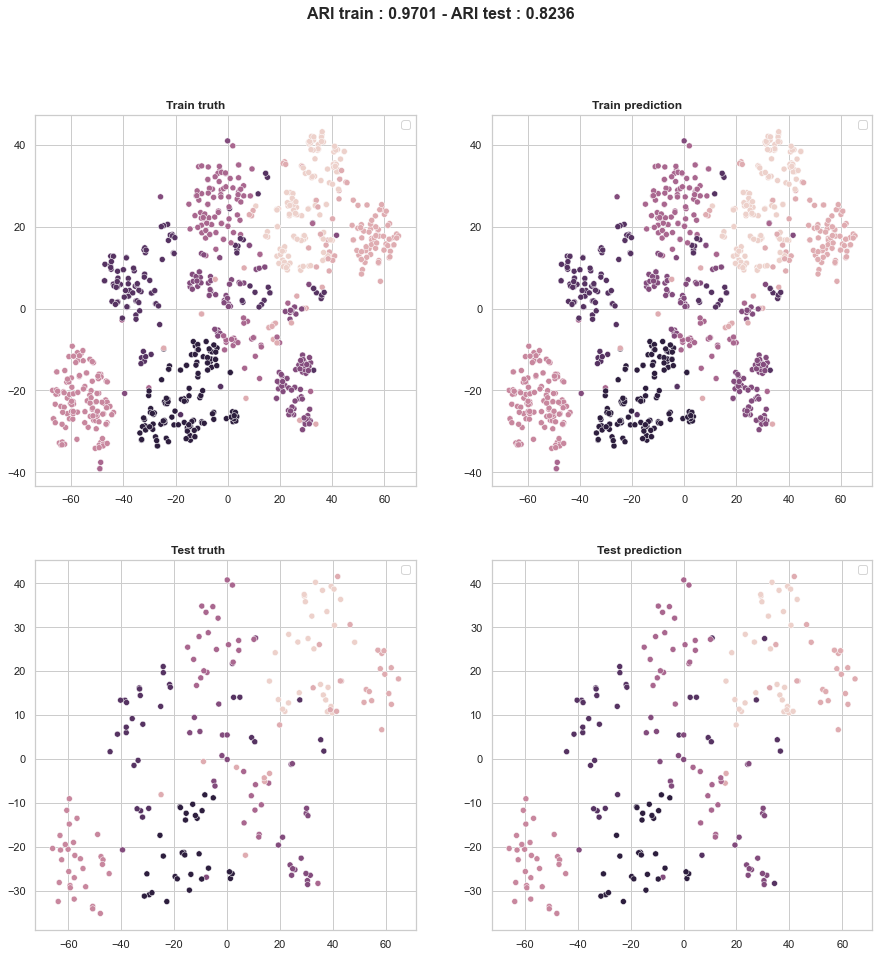

In [316]:
supervised_classification_visu_with_tsne(reduced_data, X_train_LR_reduced, y_train_predict_LR_reduced, y_train_LR_reduced, ARI_train_LR_reduced, X_test_LR_reduced, y_test_predict_LR_reduced, y_test_reduced, ARI_test_LR_reduced)

## LDA

In [317]:
from sklearn.decomposition import LatentDirichletAllocation
n_topics = 7

lda = LatentDirichletAllocation(n_components=n_topics, max_iter=10, learning_method='online', learning_offset=50., random_state=0)
lda.fit(tfidfvect_bis)

LatentDirichletAllocation(learning_method='online', learning_offset=50.0,
                          n_components=7, random_state=0)

In [318]:
def display_topics(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print("Topic {}:".format(topic_idx))
        print(" ".join([feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]))

no_top_words = 20
display_topics(lda, tfidfvect_bis.columns, no_top_words)

Topic 0:
best showpiec sticker replac vinyl medium wallmantra quilt larg comfort singl brass floral handicraft rajasthan paper decor statu ganesha jewelleri
Topic 1:
usb led light replac best power inch bulb glass rice flexibl port portabl fan lamp use hub white pack yardley
Topic 2:
cotton babi skin pack print laptop box color shape girl set use wash pad inch mous multicolor towel cover size
Topic 3:
lip plate way good natur smooth box dual shade oil pink idol colour showpiec color silver name brass gift women
Topic 4:
polyest eyelet design blanket aroma comfort door abstract curtain brown doubl self singl pack window plain raymond home width bodi
Topic 5:
mug ceram qualiti coffe design gift one love give make size safe best year get home prithish fresh start creation
Topic 6:
replac watch analog india men dial combo strap women water sonata round laptop set cell digit boy maxima case batteri


# Word2Vec

In [319]:
import tensorflow as tf
import tensorflow.keras
from tensorflow.keras import backend as K

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
import gensim

2022-12-01 13:35:58.813196: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


## Création du modèle Word2Vec

### Préparation du texte

In [320]:
def transform_corpus(document, stopwords, len_words, lemm_or_stemm, not_a_number, stopwords_complement):
    """
    Lower, exclude stopwords, exclude words smaller than len_words letters, 
    lemmanize or stemmetize, exclude number if not_a_number=True, exclude stopwords_complement
    
    Positionnal argument:
    ---------------------------
    document : list or serie of texts : list of texts to process
    stopwords : list : list of words to exclude
    len_words : int : length mini of a word to be kept
    lemm_or_stemm : 'stemm' or 'lemm'
    not_a_number : bool : if True, exclude numbers
    stopwords_complement : list : list of complement words to exclude
    
    Return:
    ---------------------------
    document_transformed : serie of words
    """
    
    def transform(text):
        text_transformed = transform_text(text, 
                                          stopwords=stopwords, 
                                          len_words=len_words, 
                                          lemm_or_stemm =lemm_or_stemm, 
                                          not_a_number=not_a_number, 
                                          stopwords_complement=stopwords_complement)
        return text_transformed
    document_transformed = document.apply(lambda x : transform(x))
    document_transformed = document_transformed.apply(lambda x :' '.join(x))
    
    return document_transformed

In [622]:
corpus_description = transform_corpus(text['description'], stopwords_base, 2, 'lemm', True, [])
corpus_name = transform_corpus(text['product_name'], stopwords_base, 2, 'lemm', True, [])
corpus = corpus_description+corpus_name
sentences = corpus_description.to_list()

In [623]:
# Création d'une liste de longueur n=nb de descriptions de liste de mots d'une description utilisée pour entrainer le modèle
sentences = [gensim.utils.simple_preprocess(text) for text in sentences]

In [323]:
# Regardons la longueur médiane des descriptions
median_length = np.median([len(x) for x in sentences])
median_length

31.0

In [324]:
w2v_size=720      # taille de l'espace vectoriel construit (nb de colonnes matrice embedding)
w2v_window=5       # taille du contexte pris en compte
w2v_min_count=2    # fréquence mini d'apparition d'un mot pour être conservé
w2v_epochs=100
maxlen = 100       # longueur max d'une descrition (tronquée à la fin ou au début)

### Model

In [325]:
# Création du modèle Word2Vec
#w2v_model = gensim.models.Word2Vec(min_count=w2v_min_count,  # fréquence mini d'apparition d'un mot pour être conservé
#                                   window=w2v_window,        # taille du contexte pris en compte
#                                   vector_size=w2v_size,     # taille de l'espace vectoriel construit (taille de l'embedding)
#                                   seed=42,
#                                   workers=1,
#                                  sg=1)                      # 1 : skip-gram; - 0: CBOW.
#                                 workers=multiprocessing.cpu_count())

In [326]:
# Entrainement de model puis sauvegarde

#w2v_model.build_vocab(sentences)
#w2v_model.train(sentences, total_examples=w2v_model.corpus_count, epochs=w2v_epochs)  # total_examples:nombre de phrase - epochs:nombre d'itérations
#w2v_model.save("word2vec.model")

In [340]:
w2v_model = gensim.models.Word2Vec.load('word2vec.model')
model_vectors = w2v_model.wv               # wv = word vector
w2v_words = model_vectors.index_to_key     # wv.index_to_key = liste du vocabulaire filtré
print("Vocabulary size: %i" % len(w2v_words))

Vocabulary size: 3104


In [619]:
len(model_vectors[0])

720

In [620]:
r = random.randint(0, len(sentences))
w2v_model.predict_output_word(sentences[r], topn=3)

[('spf', 0.08884626), ('lowest', 0.08290778), ('sunscreen', 0.025070438)]

#### Plot model

In [343]:
def reduce_dimensions(model, dim):
    """
    Reduce model.wv.vectors to dim dimensions with TSNE
    
    Positionnal argument:
    ---------------------------
    model : Word2Vec model trained 
    dim : int : number of dimension to reduce model.wv.vectors (2 or 3)
    
    
    Return:
    ---------------------------
    x_vals : first dimension of model.wv.vectors reduced
    y_vals : second dimension of model.wv.vectors reduced
    labels : words
    """
    
    num_dimensions = dim  

    vectors = np.asarray(model.wv.vectors)      # vectors pour chaque mot
    labels = np.asarray(model.wv.index_to_key)  # mots

    # reduce using t-SNE
    tsne = TSNE(n_components=num_dimensions, random_state=0)
    vectors = tsne.fit_transform(vectors)

    x_vals = [v[0] for v in vectors]
    y_vals = [v[1] for v in vectors]
    return x_vals, y_vals, labels

In [344]:
x_vals, y_vals, labels = reduce_dimensions(w2v_model, 2)

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


In [345]:
def plot_model(x_vals, y_vals, labels, nb):
    """
    Plot nb random labels at (x_vals, y_vals)
    
    Positionnal argument:
    ---------------------------
    x_vals : list : first dimension of vectors projected
    y_vals : list : second dimension of vectors projected
    labels : array : words
    nb : int : nb of words to plot
    """
    random.seed(0)
    plt.figure(figsize=(12, 12))
    plt.scatter(x_vals, y_vals, alpha=0.3)
    indices = list(range(len(labels)))
    selected_indices = random.sample(indices, nb)
    for i in selected_indices:
        plt.annotate(labels[i], (x_vals[i], y_vals[i]), fontproperties={'size':14}, weight='bold')

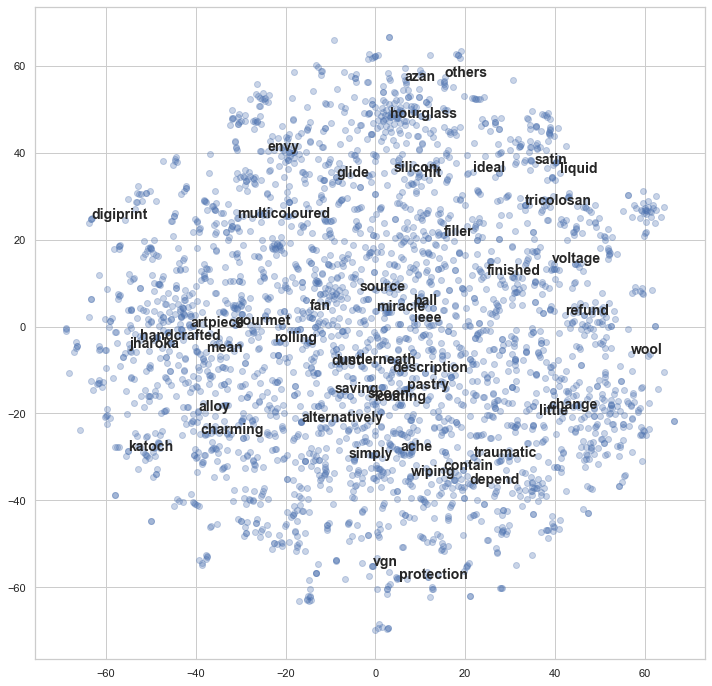

In [346]:
plot_model(x_vals, y_vals, labels, 50)

#### Comparaison entre un wordvector téléchargé et celui obtenu avec nos data

In [335]:
from gensim.models import KeyedVectors
wv_from_text = KeyedVectors.load_word2vec_format('numberbatch-en-19.08.txt', binary=False)
wv_from_text

In [614]:
w2v_model.wv.most_similar(positive=["curtain"])

[('door', 0.655540406703949),
 ('eyelet', 0.6345058083534241),
 ('swhf', 0.6227265000343323),
 ('jacquard', 0.6154297590255737),
 ('quallity', 0.5867923498153687),
 ('ville', 0.5647681355476379),
 ('stiching', 0.5574243068695068),
 ('window', 0.5364383459091187),
 ('wrinkle', 0.5340484976768494),
 ('opaque', 0.5326926112174988)]

In [615]:
wv_from_text.most_similar(positive=["curtain"])

[('incurtain', 0.997959554195404),
 ('curtain_fabric', 0.9920047521591187),
 ('curtainlike', 0.9768604040145874),
 ('net_curtain', 0.975211501121521),
 ('velvet_curtain', 0.9707514047622681),
 ('hanging_screen', 0.9455984234809875),
 ('theater_curtain', 0.9356663227081299),
 ('precurtain', 0.9215916991233826),
 ('uncurtain', 0.9175840020179749),
 ('becurtain', 0.9130883812904358)]

## Création de la matrice d'embedding

In [648]:
# Préparation des sentences (tokenization)
vocab_size = len(w2v_words) + 1
tokenizer = Tokenizer(num_words=vocab_size)
tokenizer.fit_on_texts(sentences)

# attribuer un nombre à un mot 
# créer des sequences où les phrases sont remplacées par des listes de nombres correspondant aux mots
sequences = tokenizer.texts_to_sequences(sentences)

num_words = len(tokenizer.word_index) + 1
print("Number of unique words: %i" % num_words)

Number of unique words: 4358


In [649]:
# Création de la matrice d'embedding (matrice regroupant l'ens des vecteurs des mots présents dans le texte original)

print("Create Embedding matrix ...")
word_index = tokenizer.word_index     # tokenizer.word_index = dictionnaire mot : nombre associé
vocab_size = len(w2v_words) + 1
embedding_matrix = np.zeros((vocab_size, w2v_size))
i=0
j=0
    
for word, idx in word_index.items():
    i +=1
    if word in w2v_words:                # w2v_words = liste vocabulaire
        j +=1
        embedding_vector = model_vectors[word]
        if embedding_vector is not None:
            embedding_matrix[idx] = model_vectors[word]
            
word_rate = np.round(j/i,4)
print("Word embedding rate : ", word_rate)
print("Embedding matrix: %s" % str(embedding_matrix.shape))

Create Embedding matrix ...
Word embedding rate :  0.7124
Embedding matrix: (3105, 720)


In [650]:
# Vocabulaire complet de départ
len(tokenizer.word_index)

4357

In [651]:
# Vocabulaire où les mots n'apparaissant qu'une seule fois sont filtrés
len(w2v_words)

3104

In [652]:
# Taille de la matrice d'embedding : (nb mots originaux, dim choisie en hyperparamètre)
embedding_matrix.shape

(3105, 720)

## Création du modèle d'embedding

In [653]:
# Création du modèle où les inputs sont de longueur maxlen

word_input=Input(shape=(maxlen,),dtype='float64')            # longueur de chaque document pris en compte (document tronqué)
word_embedding=Embedding(input_dim=vocab_size,               # nombre de mots au départ = nb lignes matrice embedding
                         output_dim=w2v_size,                # dimension de sortie = nb colonnes matrice embedding
                         weights = [embedding_matrix],       # matrice embedding
                         input_length=maxlen)(word_input)    # longueur de chaque document pris en compte (document tronqué)
word_vec=GlobalAveragePooling1D()(word_embedding)  
embed_model = Model([word_input],word_vec)

embed_model.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 100)]             0         
                                                                 
 embedding_2 (Embedding)     (None, 100, 720)          2235600   
                                                                 
 global_average_pooling1d_2   (None, 720)              0         
 (GlobalAveragePooling1D)                                        
                                                                 
Total params: 2,235,600
Trainable params: 2,235,600
Non-trainable params: 0
_________________________________________________________________


In [654]:
word_input

<KerasTensor: shape=(None, 100) dtype=float64 (created by layer 'input_3')>

## Exécution du modèle

In [655]:
# padding='post' tronquer la fin pour que longueur d'une phrase = maxlen et padding='pre' tronque le début
x_sentences = pad_sequences(sequences, maxlen=maxlen, padding='post')

In [656]:
# out : matrice où les documents sont vectorisés
embeddings = embed_model.predict(x_sentences)
embeddings.shape

33/33 [==============================] - 0s 7ms/step


(1050, 720)

### Non supervisé

In [657]:
nb_clusters = len(categories['category1'].unique())
categories_num = categories['category1'].apply(lambda x: numerize(x))

In [658]:
ARI, X_tsne, labels, time2 = ARI_fct(embeddings, nb_clusters, categories_num, 30, 1500)

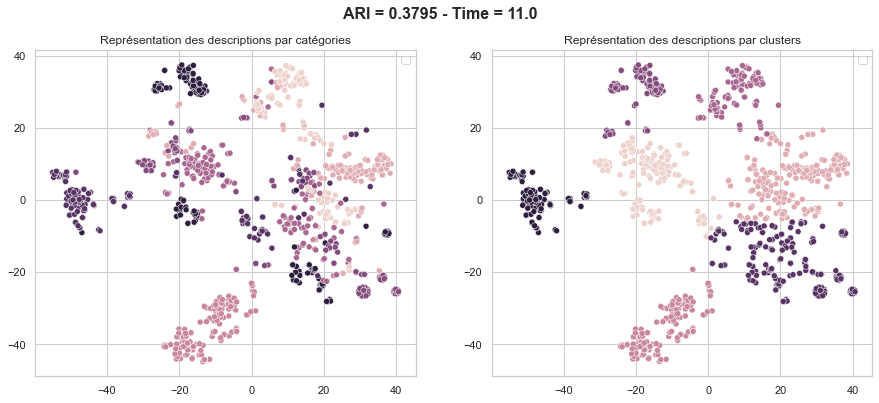

In [659]:
TSNE_visu_fct(ARI, X_tsne, labels, time2 , categories_num )

### Non supervisé avec réduction dimensionnelle

In [627]:
# nombre de composantes à calculer
pca_w2v = PCA(n_components=0.99, svd_solver='full')
pca_w2v.fit(embeddings)

PCA(n_components=0.99, svd_solver='full')

In [628]:
# On transforme tfidfvect_bis en projetant sur les 800 premières directions
reduced_data_w2v = pd.DataFrame(pca_w2v.transform(embeddings))
reduced_data_w2v.shape

(1050, 94)

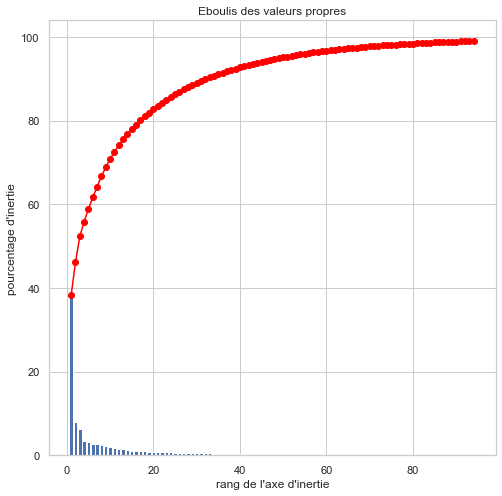

In [630]:
# Eboulis des valeurs propres
scree = pca_w2v.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

In [635]:
ARI_w2v, X_tsne_w2v, labels_w2v, time2_w2v = ARI_fct(reduced_data_w2v, nb_clusters, categories_num, 30, 2500)

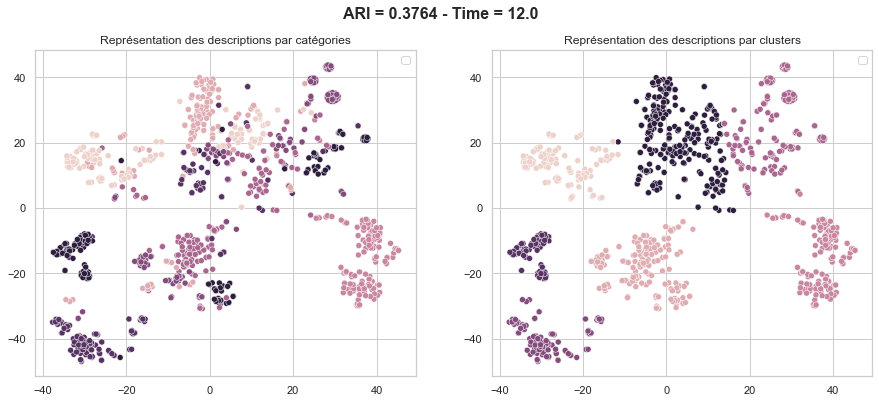

In [636]:
TSNE_visu_fct(ARI_w2v, X_tsne_w2v, labels_w2v, time2_w2v, categories_num )

### Supervisé : regression logistique

In [359]:
X_train_LR_word, y_train_predict_LR_word, y_train_LR_word, ARI_train_LR_word, X_test_LR_word, y_test_predict_LR_word, y_test_word, ARI_test_LR_word = supervised_classification(
    pd.DataFrame(embeddings), 
    categories_num, 
    LogisticRegression(dual=False))


score_train : 0.9226190476190477
score_test : 0.9


Precision : 0.9 
Recall : 0.9061971717433904


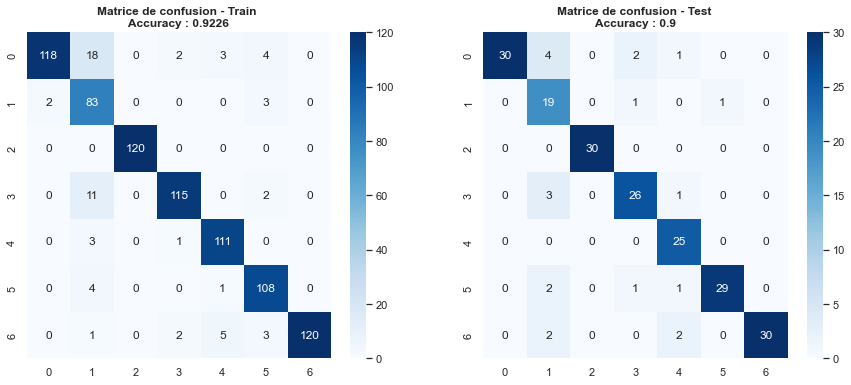

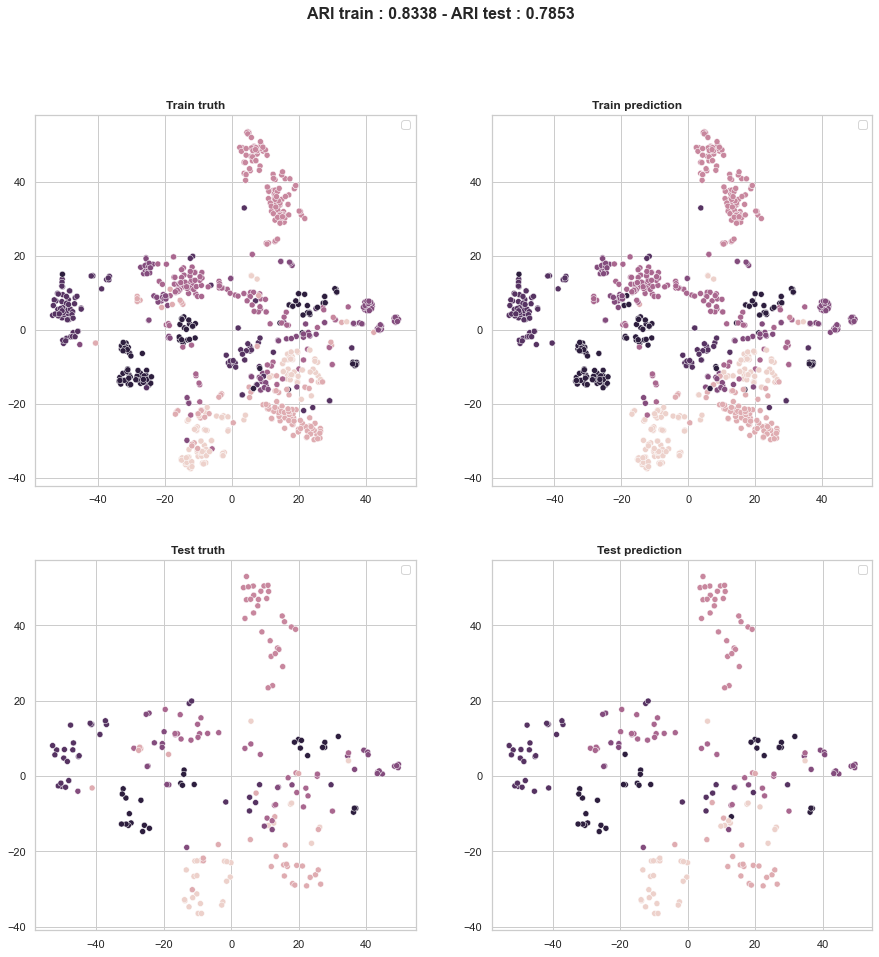

In [360]:
supervised_classification_visu_with_tsne(pd.DataFrame(embeddings), 
                                         X_train_LR_word, 
                                         y_train_predict_LR_word, 
                                         y_train_LR_word, 
                                         ARI_train_LR_word, 
                                         X_test_LR_word, 
                                         y_test_predict_LR_word, 
                                         y_test_word, 
                                         ARI_test_LR_word)

# BERT

In [361]:
import tensorflow as tf
# import tensorflow_hub as hub
import tensorflow.keras
from tensorflow.keras import backend as K

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model

# Bert
import os
import transformers
from transformers import TFAutoModel, AutoTokenizer

os.environ["TF_KERAS"]='1'

In [362]:
print(tf.__version__)
print(tensorflow.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
print(tf.test.is_built_with_cuda())

2.10.0
2.10.0
Num GPUs Available:  0
False


In [363]:
corpus_bert = text['description'] + text['product_name']
sentences_bert = corpus_bert.to_list()

## Fonctions communes

In [364]:
# Fonction de préparation des sentences
def bert_inp_fct(sentences, bert_tokenizer, max_length) :
    input_ids=[]
    token_type_ids = []
    attention_mask=[]
    bert_inp_tot = []

    for sent in sentences:                                                            # encode_plus : return un dictionnaire avec inputs_id, type_tokens_id, attention_mask
        bert_inp = bert_tokenizer.encode_plus(sent,                                   # la phrase à encoder
                                              add_special_tokens = True,              # ajoute [CLS] au début et/ou  [SEP] selon le model
                                              max_length = max_length,                # pad et truncate à cette longueur
                                              padding='max_length',
                                              return_attention_mask = True,           # array de 0 et 1 indiquant quel token a subi un pad
                                              return_token_type_ids=True,             # indique le numero de phrase auquel le token appartient           
                                              truncation=True,
                                              return_tensors="tf")
    
        input_ids.append(bert_inp['input_ids'][0])
        token_type_ids.append(bert_inp['token_type_ids'][0])
        attention_mask.append(bert_inp['attention_mask'][0])
        bert_inp_tot.append((bert_inp['input_ids'][0], 
                             bert_inp['token_type_ids'][0], 
                             bert_inp['attention_mask'][0]))

    input_ids = np.asarray(input_ids)
    token_type_ids = np.asarray(token_type_ids)
    attention_mask = np.array(attention_mask)
    
    return input_ids, token_type_ids, attention_mask, bert_inp_tot
    

# Fonction de création des features
def feature_BERT_fct(model, model_type, sentences, max_length, b_size, mode='HF') :
    batch_size = b_size
    batch_size_pred = b_size
    bert_tokenizer = AutoTokenizer.from_pretrained(model_type)
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        input_ids, token_type_ids, attention_mask, bert_inp_tot = bert_inp_fct(sentences[idx:idx+batch_size], 
                                                                      bert_tokenizer, max_length)
        
        if mode=='HF' :    # Bert HuggingFace
            outputs = model.predict([input_ids, attention_mask, token_type_ids], batch_size=batch_size_pred)
            last_hidden_states = outputs.last_hidden_state

        if mode=='TFhub' : # Bert Tensorflow Hub
            text_preprocessed = {"input_word_ids" : input_ids, 
                                 "input_mask" : attention_mask, 
                                 "input_type_ids" : token_type_ids}
            outputs = model(text_preprocessed)
            last_hidden_states = outputs['sequence_output']
             
        if step ==0 :
            last_hidden_states_tot = last_hidden_states
            last_hidden_states_tot_0 = last_hidden_states
        else :
            last_hidden_states_tot = np.concatenate((last_hidden_states_tot,last_hidden_states))
    
    features_bert = np.array(last_hidden_states_tot).mean(axis=1)
    
    time2 = np.round(time.time() - time1,0)
    print("temps traitement : ", time2)
     
    return features_bert, last_hidden_states_tot

In [365]:
bert_tokenizer = AutoTokenizer.from_pretrained('bert-base-uncased')
input_ids, token_type_ids, attention_mask, bert_inp_tot = bert_inp_fct(sentences_bert, bert_tokenizer, 100)

In [366]:
bert_inp_tot[780]
# token_type_ids à 0 car chaque entrée n'est qu'une unique phrase

(<tf.Tensor: shape=(100,), dtype=int32, numpy=
 array([  101,  7304, 14693,  7473,  2278,  1011, 16202,  2278, 20946,
        11698,  3422,  1011,  2005,  2273,  1011,  4965,  7304, 14693,
         7473,  2278,  1011, 16202,  2278, 20946, 11698,  3422,  1011,
         2005,  2273,  7473,  2278,  1011, 16202,  2278,  3784,  2012,
        12667,  1012, 12875,  2692,  1999,  2634,  2069,  2012, 11238,
         6673,  2102,  1012,  4012,  1012,  5971,  3422,  1010,  2569,
         7223,  3422,  1010,  2880,  3422,  1010,  3422,  2005,  2273,
         1011,  2307, 19575,  2015,  1010,  2069, 10218,  3688,  1010,
         2382,  2154,  6110, 11302,  1010,  2489,  7829,  1012,  5356,
         2006,  6959,   999,  7304, 14693,  7473,  2278,  1011, 16202,
         2278, 20946, 11698,  3422,  1011,  2005,  2273,   102,     0,
            0], dtype=int32)>,
 <tf.Tensor: shape=(100,), dtype=int32, numpy=
 array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 

In [367]:
bert_tokenizer.decode(bert_inp_tot[100][0], clean_up_tokenization_spaces=False)

'[CLS] buy goldencollections gc4353 makeup and jewellery vanity pouch for rs. 783 online. goldencollections gc4353 makeup and jewellery vanity pouch at best prices with free shipping & cash on delivery. only genuine products. 30 day replacement guarantee. goldencollections gc4353 makeup and jewellery vanity pouch [SEP] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD]'

## BERT HuggingFace

### 'bert-base-uncased'

In [368]:
max_length = 100
batch_size = 10
model_type = 'bert-base-uncased'
model = TFAutoModel.from_pretrained(model_type)

Some layers from the model checkpoint at bert-base-uncased were not used when initializing TFBertModel: ['nsp___cls', 'mlm___cls']
- This IS expected if you are initializing TFBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFBertModel were initialized from the model checkpoint at bert-base-uncased.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions without further training.


In [369]:
model.summary()

Model: "tf_bert_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bert (TFBertMainLayer)      multiple                  109482240 
                                                                 
Total params: 109,482,240
Trainable params: 109,482,240
Non-trainable params: 0
_________________________________________________________________


In [370]:
# Création des features
features_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences_bert, max_length, batch_size, mode='HF')

1/1 [==============================] - 3s 3s/step
temps traitement :  347.0


In [661]:
features_bert.shape

(1050, 768)

In [371]:
ARI, X_tsne, labels, time2 = ARI_fct(features_bert, nb_clusters, categories_num, 40, 2000)

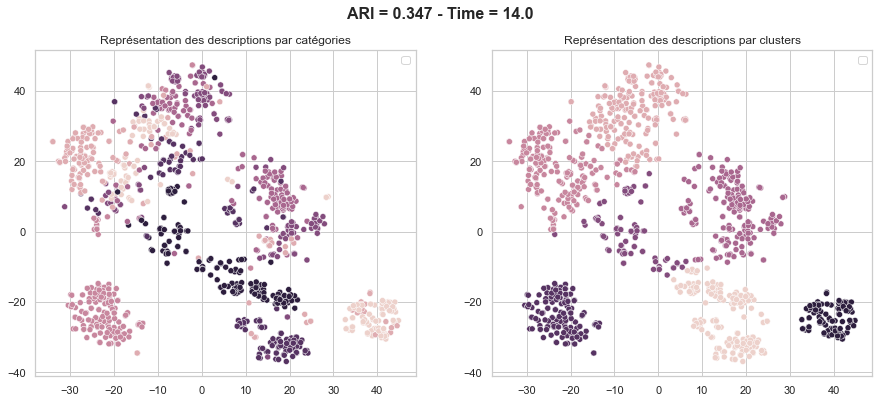

In [372]:
TSNE_visu_fct(ARI, X_tsne, labels, time2 , categories_num )

### roberta-base


In [373]:
max_length = 30
batch_size = 10
model_type = 'roberta-base'
model = TFAutoModel.from_pretrained(model_type)

Some layers from the model checkpoint at roberta-base were not used when initializing TFRobertaModel: ['lm_head']
- This IS expected if you are initializing TFRobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
All the layers of TFRobertaModel were initialized from the model checkpoint at roberta-base.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFRobertaModel for predictions without further training.


In [374]:
features_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences_bert, 
                                                         max_length, batch_size, mode='HF')

1/1 [==============================] - 1s 908ms/step
temps traitement :  136.0


In [660]:
features_bert.shape

(1050, 768)

In [375]:
ARI, X_tsne, labels, time2 = ARI_fct(features_bert, nb_clusters, categories_num, 30, 1000)

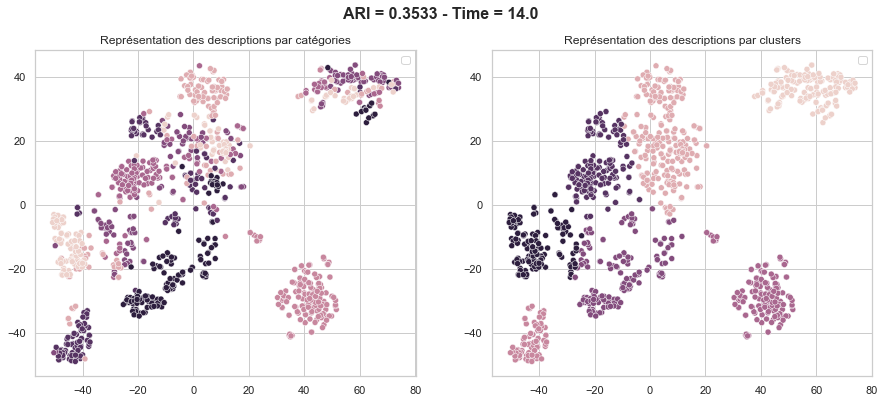

In [376]:
TSNE_visu_fct(ARI, X_tsne, labels, time2 , categories_num )

## TFBertForSequenceClassification

In [377]:
from transformers import DistilBertTokenizer
from transformers import ’
import tensorflow as tf
import pandas as pd
import json
import gc

### Préparation des données

In [378]:
corpus_bert = text['description'] + text['product_name']
sentences_bert = corpus_bert.to_list()

In [379]:
train_texts, test_texts, train_cat, test_cat= train_test_split(corpus_bert, categories_num, test_size=0.2, random_state=0, stratify=categories_num)
train_cat.value_counts()

2    120
0    120
3    120
6    120
1    120
5    120
4    120
Name: category1, dtype: int64

In [380]:
train_index = train_texts.index
test_index = test_texts.index

In [381]:
train_texts_list = train_texts.to_list()
test_texts_list = test_texts.to_list()
train_cat = train_cat.to_list()
test_cat = test_cat.to_list()

In [382]:
tokenizer_DistilBert = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_encodings = tokenizer_DistilBert(train_texts_list, truncation=True, padding=True)

In [383]:
train_dataset = tf.data.Dataset.from_tensor_slices((dict(train_encodings),train_cat))

### Construction du modèle

In [384]:
model = TFDistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=7)
optimizer = tf.keras.optimizers.Adam(learning_rate=5e-5)
loss = tf.losses.SparseCategoricalCrossentropy(from_logits=True)
model.compile(optimizer=optimizer, loss=loss, metrics=['accuracy'])

Some layers from the model checkpoint at distilbert-base-uncased were not used when initializing TFDistilBertForSequenceClassification: ['vocab_layer_norm', 'vocab_transform', 'activation_13', 'vocab_projector']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some layers of TFDistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['dropout_93', 'pre_classifier', 'classifier']
You should probably TRAIN this model on a down-stream task to be able to use i

### Entrainement du modèle

In [385]:
#tfdataset_train = train_dataset.batch(16)
#model.fit(tfdataset_train, epochs=3, batch_size=16)

### Sauvegarde du modèle entrainé

In [386]:
#model.save_pretrained('clf')

### Chargement et prédiction avec le modèle pré-entrainé

In [387]:
loaded_model = TFDistilBertForSequenceClassification.from_pretrained('clf')

Some layers from the model checkpoint at clf were not used when initializing TFDistilBertForSequenceClassification: ['dropout_176']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some layers of TFDistilBertForSequenceClassification were not initialized from the model checkpoint at clf and are newly initialized: ['dropout_113']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [388]:
def prediction_model(text, model_pre):
    """
    Predict label of text with model model_pre
    
    """
    predict_input = tokenizer_DistilBert.encode(text,
                                 truncation=True,
                                 padding=True,
                                 return_tensors="tf")

    output = model_pre(predict_input)[0]

    prediction_value = tf.argmax(output, axis=1).numpy()[0]
    return prediction_value

In [389]:
# Prediction pour test set
prediction_test = [prediction_model(test_texts_list[i], loaded_model) for i in range(len(test_texts_list))]


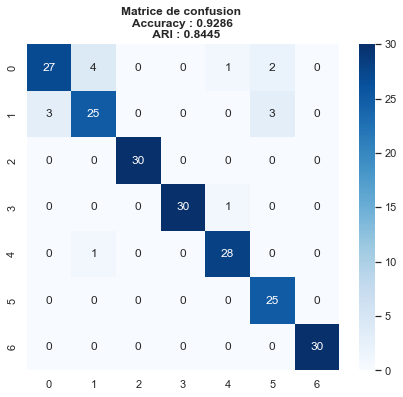

In [390]:
confusion_matrix_plot(prediction_test, test_cat)

In [391]:
# Bons résultats!

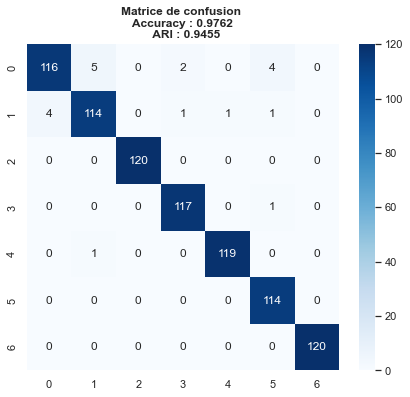

In [662]:
prediction_train = [prediction_model(train_texts_list[i], loaded_model) for i in range(len(train_texts_list))]

confusion_matrix_plot(prediction_train, train_cat)

In [392]:
# Essai avec des descriptions prises sur amazon.co.uk

#'home furnishing': 0
#'baby care': 1
#'watches': 2
#'home decor festive needs': 3
#'kitchen dining': 4
#'beauty and personal care': 5
#'computers': 6

In [393]:
prediction_model('QUICKLY ACCESS A SATA SSD OR HDD: By connecting to a SATA 2.5" SATA SSD or HDD using this SATA to USB cable--you can add storage, perform backups, create disk images, implement data recoveries, and transfer content to your laptop ', loaded_model)

6

In [394]:
prediction_model('Remove the Dullness - With its gold frame and white wood panels, this elegant bookcase is perfect for your office, bedroom, study, living room or balcony to bring a bright splash to your room ', loaded_model)

3

In [395]:
prediction_model('SMALL TABLE, BIG POSSIBILITIES - With its beautiful natural woodgrain, this solid wood \
table refines a compact dining area, small kitchen, office or craft room with ease ', loaded_model)

3

In [396]:
prediction_model('PREMIUM MATERIAL - The dining chair is covered with high quality velvet fabric material and padding with upholstered foam, solid black wood legs make a strong \
structure to maximum loading capacity and help you to reduce daily fatigue. ', loaded_model)

0

In [397]:
prediction_model('Cute Design: Unisex baby fleece romper jumpsuit with a little bear and pocket on the front, cartoon pattern makes your baby more lovely. The baby girl boy winter outfits is made of 3-layer fabric, layer by layer care, warm and hug the baby', loaded_model)

1

In [398]:
prediction_model('SMA PRO First Infant Milk ready to use liquids are in resealable cartons, easy and convenient for on the go When your baby is 6 months old, \
SMA PRO Follow-on Milk is designed to help meet your babies changing needs, enriched with iron to help support normal cognitive development ', loaded_model) 

5

In [399]:
prediction_model('Clean lines make BOSS Bottled an iconic classic. Combining elegance and style, it was designed with the modern man in mind and is the encapsulation of BOSS in a fragrance.', loaded_model) 

5

In [400]:
prediction_model('1.5L LARGE CAPACITY - Glass carafe with 1.5 L capacity, this allows you to brew a large amount of coffee up to full 12 cups, or choose two or four at a time. It has an easy-grip handle for comfortable, dripless pouring. The cup is made of high-quality glass, \
which allows you to keep the temperature of coffee for a long time.', loaded_model) 

4

In [401]:
prediction_model('BHK HOMLYNK Cutlery Set 16 Piece Teaspoons, Knife and Forks Sets | Tableware Stainless Steel Cutlery Sets | \
Easy Clean, Mirror Polished, Portable & Reusable Cutlery Set for 4 People, Silver ', loaded_model)

3

In [402]:
prediction_model('STYLISH AND PRACTICAL - Constructed with premium materials, this classic yet futuristic portable lamp is available in 4 stunning \
finishes - black, white, copper, and brass. Each is designed to complement your environment, wherever you decide to take it ', loaded_model)

3

In [403]:
prediction_model('PERSEUS Compatible Drum unit for HP 126A CE314A Imaging drum, use for HP Color LaserJet Pro MFP M176n M177fw M176 M177 CP1025 \
CP1025NW Printer Drum unit, High Yield Pack of 1 ', loaded_model)

6

In [404]:
prediction_model('Full HD 1080p Webcam: With premium glass lens, manual focus, high resolution CMOS sensor to fast capture sharp and clear image at 30fps,\
the 1080p webcam delivers smooth true-to-life video for Skype chatting, YouTube recording，live streaming, etc.. ', loaded_model)

6

In [405]:
prediction_model("When you're adding plants to your home, give them a home of their own in plant pots. Our variety of \
indoor plant pots ensures you’ll please your plants and suit your style. We even have  self-watering ones (for vacation days) \
and some with handles, too (for easier moving and watering).", loaded_model)

3

In [406]:
prediction_model("Rectangular, Round & Unique Mirrors", loaded_model)

3

In [407]:
# Modèle entrainé sur train_set(description+name)
# Par curiosité, essai du modèle avec test_set en utilisant uniquement la feature Name

In [408]:
index_test = test_texts.index
text_test = text.iloc[index_test, :]

In [409]:
name_test = text_test['product_name'].to_list()
name_test_cat = test_cat

In [410]:
prediction_essai = [prediction_model(name_test[i], loaded_model) for i in range(len(name_test))]

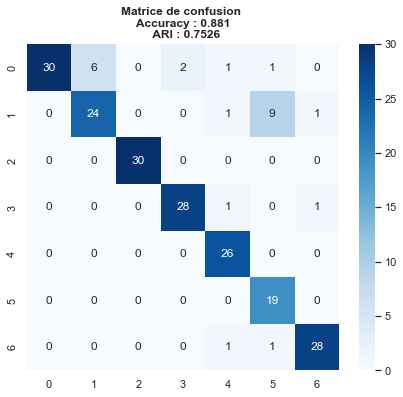

In [411]:
confusion_matrix_plot(prediction_essai, name_test_cat)

## BERT hub Tensorflow

In [412]:
model_url = 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4'

In [413]:
import tensorflow_hub as hub
#import tensorflow_text 
model_url = 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4'
bert_layer = hub.KerasLayer(model_url, trainable=True)

In [414]:
max_length = 64
batch_size = 10
model_type = 'bert-base-uncased'
model = bert_layer

features_bert_hub, last_hidden_states_tot_hub = feature_BERT_fct(model, model_type, sentences_bert, 
                                                         max_length, batch_size, mode='TFhub')

temps traitement :  215.0


In [415]:
ARI_hub, X_tsne_hub, labels_hub, time2_hub = ARI_fct(features_bert_hub, nb_clusters, categories_num, 30, 750)

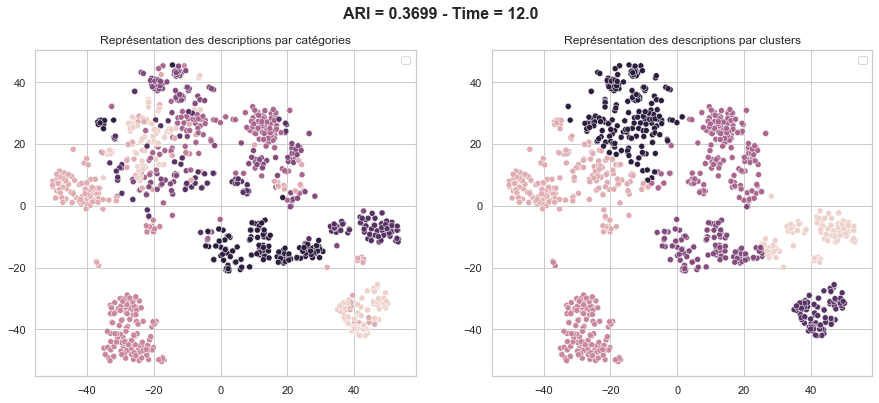

In [416]:
TSNE_visu_fct(ARI_hub, X_tsne_hub, labels_hub, time2_hub, categories_num )

# USE - Universal Sentence Encoder

In [417]:
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow.keras
from tensorflow.keras import backend as K

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model

# Bert
import transformers
#from transformers import *

os.environ["TF_KERAS"]='1'

In [418]:
print(tf.__version__)
print(tensorflow.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
print(tf.test.is_built_with_cuda())

2.10.0
2.10.0
Num GPUs Available:  0
False


In [419]:
import tensorflow_hub as hub

In [420]:

module_url = "https://tfhub.dev/google/universal-sentence-encoder/4" 
embed = hub.load(module_url)

In [421]:
def feature_USE_fct(sentences, b_size) :
    batch_size = b_size
    time1 = time.time()

    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size
        feat = embed(sentences[idx:idx+batch_size])

        if step ==0 :
            features = feat
        else :
            features = np.concatenate((features,feat))

    time2 = np.round(time.time() - time1,0)
    return features

In [422]:
batch_size = 10

In [423]:
features_USE = feature_USE_fct(sentences_bert, batch_size)

In [424]:
features_USE.shape

(1050, 512)

## Non supervisé

In [425]:
ARI, X_tsne, labels, time2 = ARI_fct(features_USE, nb_clusters, categories_num, 30, 750)

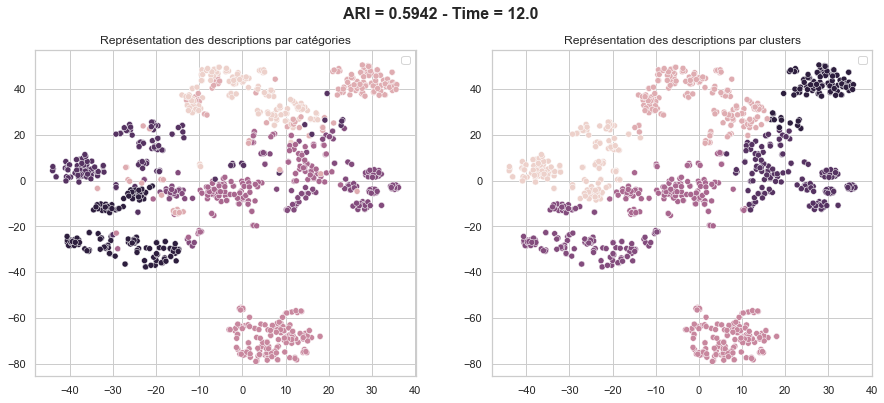

In [426]:
TSNE_visu_fct(ARI, X_tsne, labels, time2 , categories_num )

## Non supervisé après PCA

In [1002]:
# nombre de composantes à calculer
pca_use = PCA(n_components=0.99, svd_solver='full')
pca_use.fit(features_USE)

PCA(n_components=0.99, svd_solver='full')

In [1003]:
# On transforme tfidfvect_bis en projetant sur les 800 premières directions
reduced_data_use = pd.DataFrame(pca_use.transform(features_USE))
reduced_data_use.shape

(1050, 330)

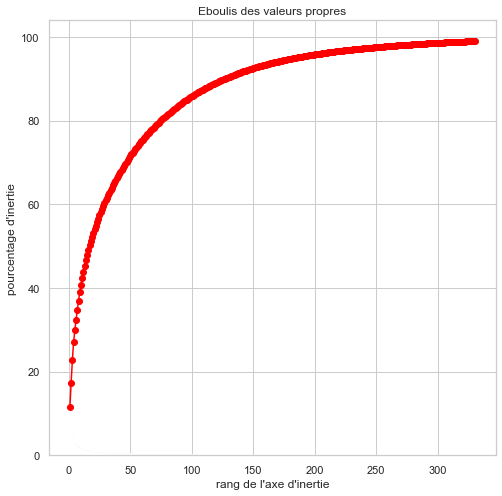

In [1004]:
# Eboulis des valeurs propres
scree = pca_use.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

In [1027]:
ARI_use, X_tsne_use, labels_use, time2_use = ARI_fct(reduced_data_use, nb_clusters, categories_num, 30, 2700)

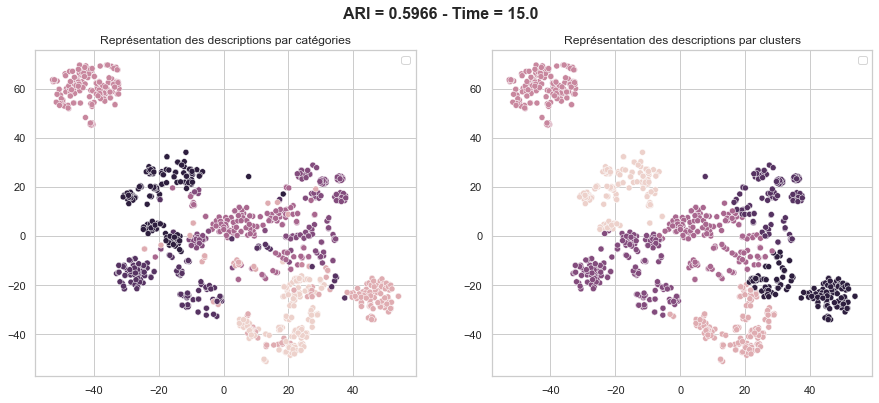

In [1028]:
TSNE_visu_fct(ARI_use, X_tsne_use, labels_use, time2_use, categories_num )

## Supervisé

In [427]:
X_train_LR_USE, y_train_predict_LR_USE, y_train_LR_USE, ARI_train_LR_USE, X_test_LR_USE, y_test_predict_LR_USE, y_test_USE, ARI_test_LR_USE = supervised_classification(pd.DataFrame(features_USE), 
                                                                                                                                            categories_num, 
                                                                                                                                            LogisticRegression(dual=False))

score_train : 0.9523809523809523
score_test : 0.9095238095238095


Precision : 0.9095238095238096 
Recall : 0.9087804476629362


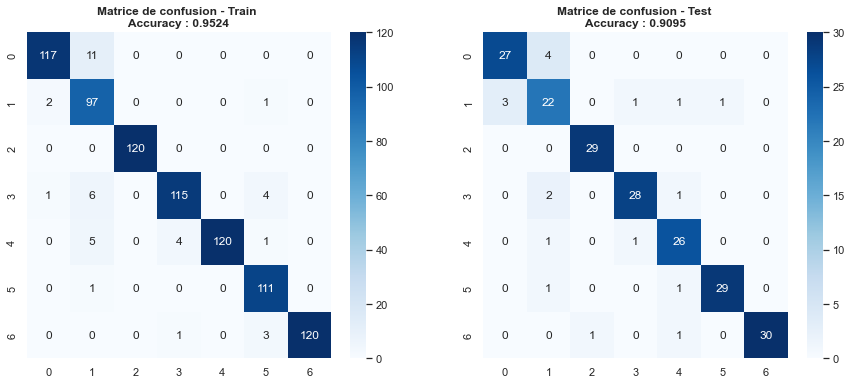

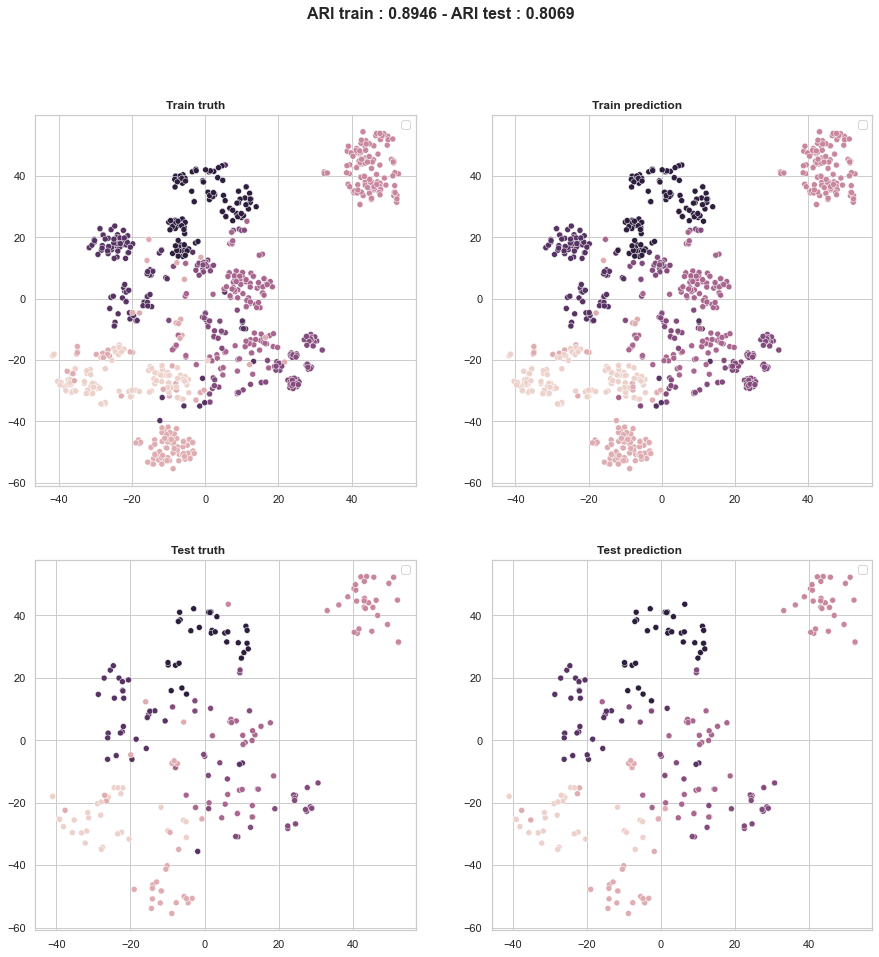

In [428]:
supervised_classification_visu_with_tsne(pd.DataFrame(features_USE), 
                                         X_train_LR_USE, y_train_predict_LR_USE, y_train_LR_USE, ARI_train_LR_USE, X_test_LR_USE, y_test_predict_LR_USE, y_test_USE, ARI_test_LR_USE)

# Images - Tensorflow/Keras

In [429]:
from PIL import Image

In [430]:
images_directories = (text.loc[:, 'image'])

## Aperçu des images

In [431]:
import cv2 as cv
def random_images(nb):
    """
    Shows nb random images
    
    """
    fig1, ax = plt.subplots(nb, nb, figsize=(15, 15))
    fig.tight_layout()
    for i in range(nb):
        for j in range(nb):
            r = random.randint(0, len(images_directories))
            image_ij = cv.imread('Images/'+images_directories[r])
            ax[i][j].imshow(image_ij, cmap="gray")
            ax[i][j].set_xticks([]) 
            ax[i][j].set_yticks([])

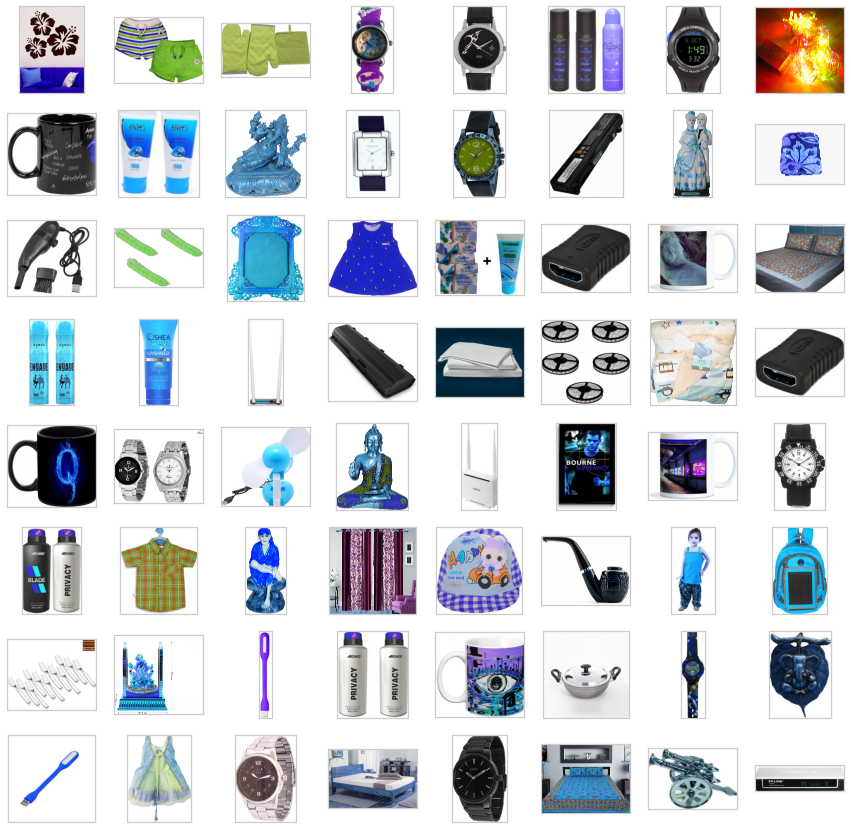

In [432]:
random_images(8)

In [433]:
def random_images_per_category(nb):
    """
    Shows nb random images from each category
    
    """
    fig1, ax = plt.subplots(7, nb, figsize=(2*nb, 14))
    fig.tight_layout()
    for i in range(7):
        mask = categories_num==i
        images_directories_i = images_directories[mask].reset_index()
        ax[i][0].set_title(f"Category {i}", size=14, weight='bold')
        for j in range(nb):
            r = random.randint(0, len(images_directories_i)-1)
            image_ij = cv.imread('Images/'+images_directories_i['image'][r])
            ax[i][j].imshow(image_ij, cmap="gray")
            ax[i][j].set_xticks([]) 
            ax[i][j].set_yticks([])

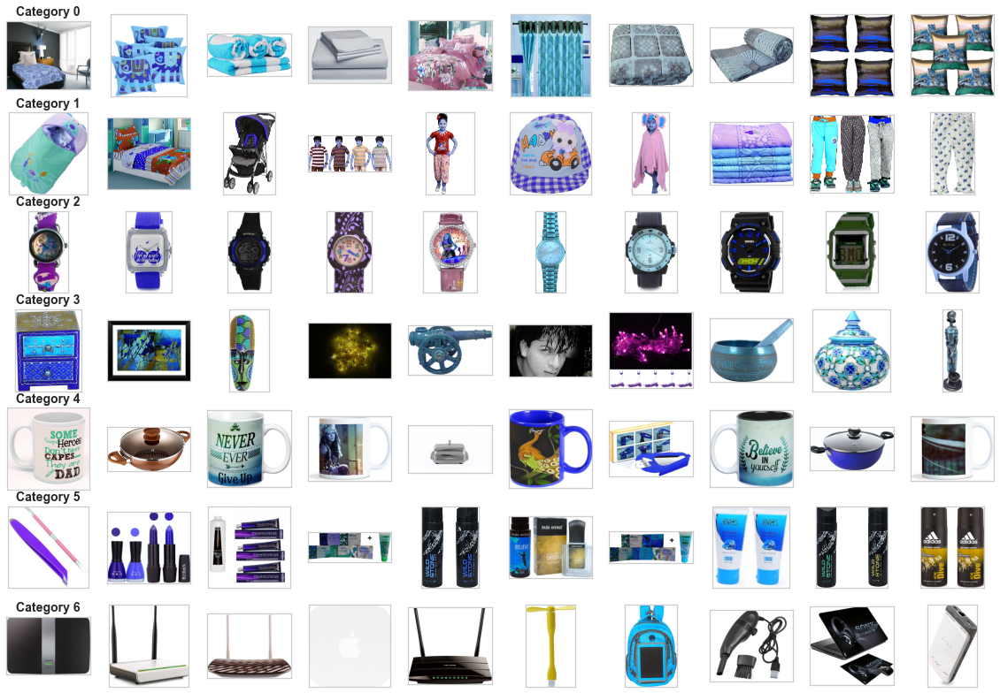

In [435]:
random_images_per_category(10)

## Etude des pré-traitrements

In [436]:
from joblib import Parallel, delayed
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.cluster import MiniBatchKMeans
from sklearn.utils import check_random_state
from skimage.feature import SIFT
from skimage.io import imread
from skimage.color import rgb2gray
from PIL import ImageOps
from skimage.restoration import denoise_nl_means, estimate_sigma
import cv2 as cv
import time

In [437]:
def compare_2_images(img1, img2):
    """
    Shows img1 and img2
    
    """
    fig, ax = plt.subplots(1, 2, figsize=(10, 6))
    fig.tight_layout()
    ax[0].imshow(img1, cmap="gray")
    ax[0].set_xticks([]) 
    ax[0].set_yticks([])
    ax[0].set_title('Original')
    ax[1].imshow(img2, cmap="gray")
    ax[1].set_xticks([]) 
    ax[1].set_yticks([])
    ax[1].set_title('Transformed')

In [438]:
def compare_images(images):
    """
    Show images by pair
    
    Positionnal argument:
    ---------------------------
    images : list of tuple : list of doublet of images to compare
    
    """
    
    nb = len(images)
    if nb%2 == 0:
        fig, ax = plt.subplots(nb//2, 4, figsize=(16, nb*2))
        fig.tight_layout()
        for i in range(nb//2):
            ax[i][0].imshow(images[2*i][0], cmap="gray")
            ax[i][1].imshow(images[2*i][1], cmap="gray")
            ax[i][2].imshow(images[2*i+1][0], cmap="gray")
            ax[i][3].imshow(images[2*i+1][1], cmap="gray")
            for j in range(4):
                ax[i][j].set_xticks([])
                ax[i][j].set_yticks([])
    else:
        fig, ax = plt.subplots(nb//2+1, 4, figsize=(16, nb*2))
        fig.tight_layout()
        for i in range(nb//2):
            ax[i][0].imshow(images[2*i][0], cmap="gray")
            ax[i][1].imshow(images[2*i][1], cmap="gray")
            ax[i][2].imshow(images[2*i+1][0], cmap="gray")
            ax[i][3].imshow(images[2*i+1][1], cmap="gray")
            for j in range(4):
                ax[i][j].set_xticks([])
                ax[i][j].set_yticks([])
        ax[nb//2][0].imshow(images[nb-1][0], cmap="gray")
        ax[nb//2][1].imshow(images[nb-1][1], cmap="gray")
        ax[nb//2][0].set_xticks([])
        ax[nb//2][0].set_yticks([])
        ax[nb//2][1].set_xticks([])
        ax[nb//2][1].set_yticks([])
        

### Blur

In [439]:
def blur(nb, blur=cv.medianBlur,  **kwargs):
    """
    Blur nb random images
    
    Positionnal argument:
    ---------------------------
    nb : int : number of images to blur
    
    Opt args :
    ---------------------------
    blur : cv2 blur to use
    
    **kwargs
    if cv.blur : ksize=doublet
    if cv.GaussianBlur : ksize=doublet, sigmaX= integer
    if cv.medianBlur : ksize=integer
    if cv.bilateralFilter : d=integer, sigmaColor=integer, sigmaSpace=integer
    -----------------------------
    
    Return:
    ---------------------------
    time2 : float : time of computation
    images : list of doublets : [(image to blur, image blured)]
    
    
    """
    rand = [random.randint(0, len(images_directories)-1) for j in range(nb)]
    time1 = time.time()
    images = []
    for i in range(len(rand)):
        img = cv.imread('Images/'+images_directories[rand[i]])
        if blur==cv.blur or blur==cv.medianBlur:
            ksize = kwargs.get('ksize')
            img_blur = blur(img, ksize=ksize)
        elif blur==cv.GaussianBlur :
            ksize = kwargs.get('ksize')
            sigmaX = kwargs.get('sigmaX')
            img_blur = blur(img, ksize=ksize , sigmaX=sigmaX)
        elif blur==cv.bilateralFilter:
            d = kwargs.get('d')
            sigmaColor = kwargs.get('sigmaColor')
            sigmaSpace = kwargs.get('sigmaSpace')
            img_blur = blur(img, d=d, sigmaColor=sigmaColor, sigmaSpace=sigmaSpace)
        images +=[(img, img_blur)]
    time2 = np.round(time.time() - time1,6)
    return (time2, images)

In [440]:
print(f"Time for 10 images with blur : {blur(10, blur=cv.blur, ksize=(9, 9))[0]} s")
print(f"Time for 10 images with GaussianBlur : {blur(10, blur=cv.GaussianBlur, ksize=(9, 9), sigmaX=1)[0]} s")
print(f"Time for 10 images with medianBlur : {blur(10, blur=cv.medianBlur, ksize=9)[0]} s")
print(f"Time for 10 images with bilateralFilter : {blur(10, blur=cv.bilateralFilter, d=9, sigmaColor=75, sigmaSpace=75)[0]} s")

Time for 10 images with blur : 0.596683 s
Time for 10 images with GaussianBlur : 0.435622 s
Time for 10 images with medianBlur : 2.470776 s
Time for 10 images with bilateralFilter : 13.147317 s


In [1031]:
images = blur(10, blur=cv.blur, ksize=(25, 25))[1]

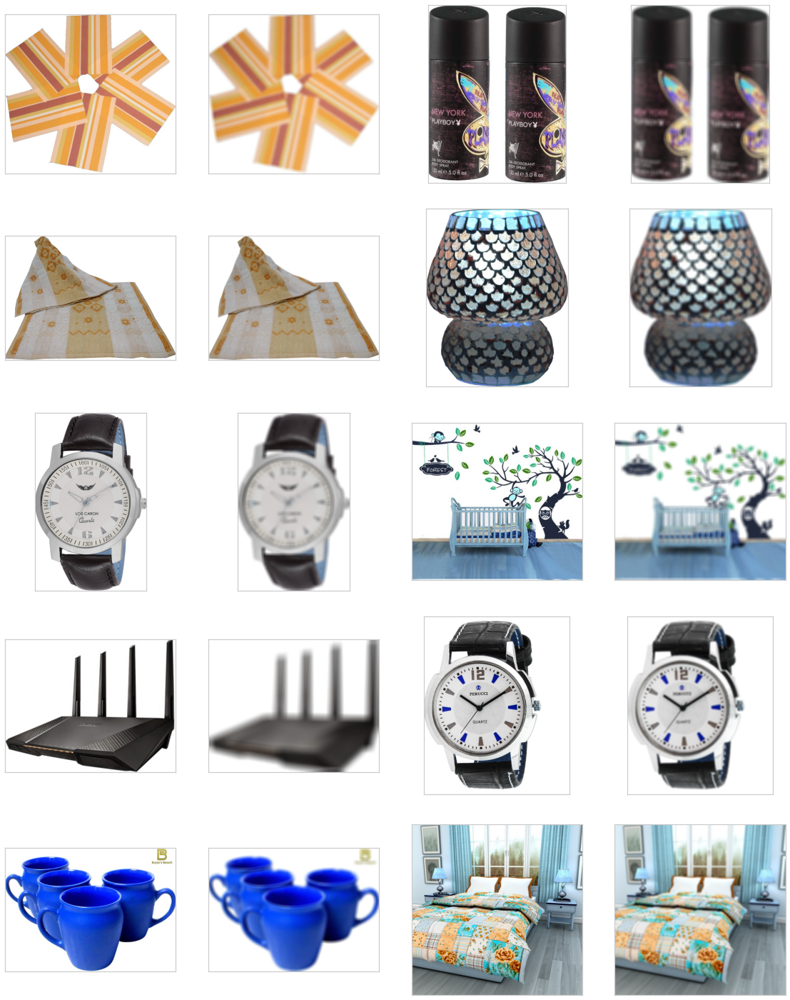

In [1032]:
compare_images(images)

In [1035]:
images = blur(10, blur=cv.GaussianBlur, ksize=(25, 25), sigmaX=20)[1]

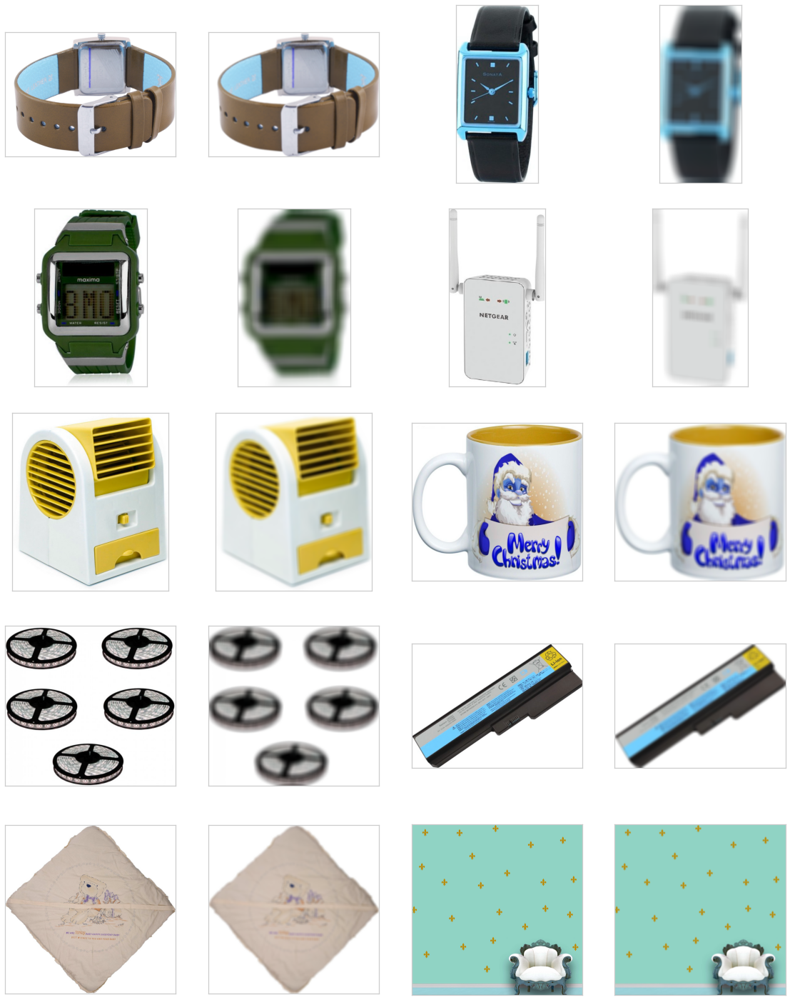

In [1036]:
compare_images(images)

In [1037]:
images = blur(10, blur=cv.medianBlur, ksize=25)[1]

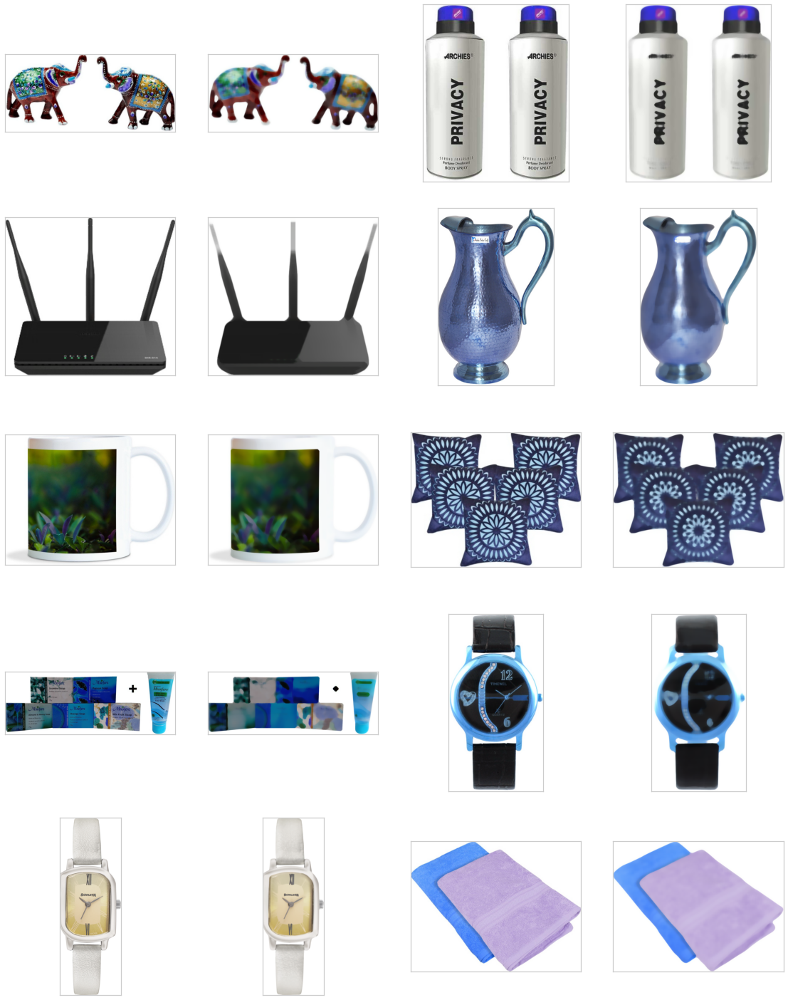

In [1038]:
compare_images(images)

In [447]:
images = blur(10, blur=cv.bilateralFilter, d=17, sigmaColor=75, sigmaSpace=75)[1]

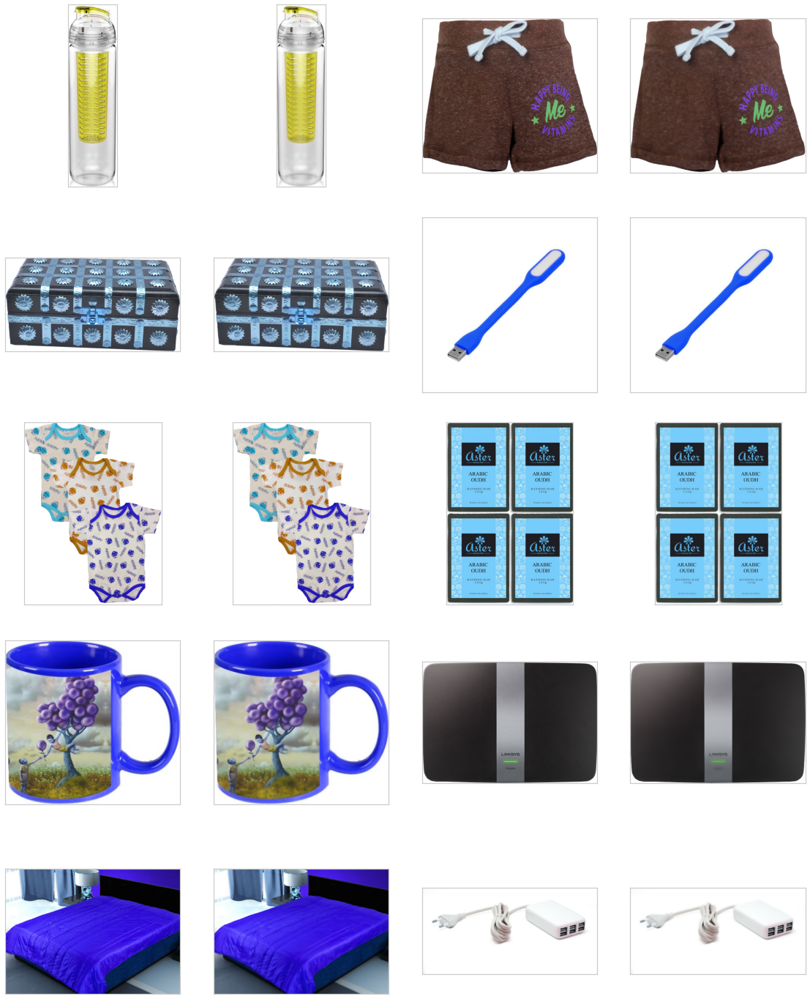

In [448]:
compare_images(images)

### Equalize

In [449]:
def equalize(nb):
    """
    Equalize nb random images
    
    Positionnal argument:
    ---------------------------
    nb : int : number of images to blur 
    
    Return:
    ---------------------------
    images : list of doublets : [(image to equalize, image equalized)]
    
    """
    rand = [random.randint(0, len(images_directories)) for j in range(nb)]
    images = []
    for i in range(len(rand)):
        img = cv.imread('Images/'+images_directories[rand[i]])
        img_nb = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
        img_eq = cv.equalizeHist(img_nb)
        images +=[(img_nb, img_eq)]
    return images

In [988]:
def compare_images_with_histogramme(images):
    """
    Show images by pair
    
    Positionnal argument:
    ---------------------------
    images : list of tuple : list of doublet of images to compare
    
    """
    
    nb = len(images)
    if nb%2 == 0:
        fig, ax = plt.subplots(nb, 4, figsize=(16, nb*4))
        fig.tight_layout()
        for i in range(nb//2):
            ax[2*i][0].imshow(images[2*i][0], cmap="gray")
            sns.histplot(ax = ax[2*i+1][0], data=np.array(images[2*i][0]).flatten(), bins=256)
            ax[2*i][1].imshow(images[2*i][1], cmap="gray")
            sns.histplot(ax = ax[2*i+1][1], data=np.array(images[2*i+1][1]).flatten(), bins=256)
            ax[2*i][2].imshow(images[2*i+1][0], cmap="gray")
            sns.histplot(ax = ax[2*i+1][2], data=np.array(images[2*i][0]).flatten(), bins=256)
            ax[2*i][3].imshow(images[2*i+1][1], cmap="gray")
            sns.histplot(ax = ax[2*i+1][3], data=np.array(images[2*i+1][1]).flatten(), bins=256)
            
            for j in range(4):
                ax[2*i][j].set_xticks([])
                ax[2*i][j].set_yticks([])
                ax[2*i+1][j].set_xticks([])
                ax[2*i+1][j].set_yticks([])
    else:
        fig, ax = plt.subplots(nb+1, 4, figsize=(16, nb*4))
        fig.tight_layout()
        for i in range(nb//2):
            ax[2*i][0].imshow(images[2*i][0], cmap="gray")
            sns.histplot(ax = ax[2*i+1][0], data=np.array(images[2*i][0]).flatten(), bins=256)
            ax[2*i][1].imshow(images[2*i][1], cmap="gray")
            sns.histplot(ax = ax[2*i+1][1], data=np.array(images[2*i+1][1]).flatten(), bins=256)
            ax[2*i][2].imshow(images[2*i+1][0], cmap="gray")
            sns.histplot(ax = ax[2*i+1][2], data=np.array(images[2*i][0]).flatten(), bins=256)
            ax[2*i][3].imshow(images[2*i+1][1], cmap="gray")
            sns.histplot(ax = ax[2*i+1][3], data=np.array(images[2*i+1][1]).flatten(), bins=256)
            for j in range(4):
                ax[2*i][j].set_xticks([])
                ax[2*i][j].set_yticks([])
                ax[2*i+1][j].set_xticks([])
                ax[2*i+1][j].set_yticks([])
        ax[nb-1][0].imshow(images[nb-1][0], cmap="gray")
        sns.histplot(ax = ax[nb][0], data=np.array(images[nb-1][0]).flatten(), bins=256)
        ax[nb-1][1].imshow(images[nb-1][1], cmap="gray")
        sns.histplot(ax = ax[nb][1], data=np.array(images[nb-1][1]).flatten(), bins=256)
        
        ax[nb-1][0].set_xticks([])
        ax[nb-1][0].set_yticks([])
        ax[nb-1][1].set_xticks([])
        ax[nb-1][1].set_yticks([])
        ax[nb][0].set_xticks([])
        ax[nb][0].set_yticks([])
        ax[nb][1].set_xticks([])
        ax[nb][1].set_yticks([])

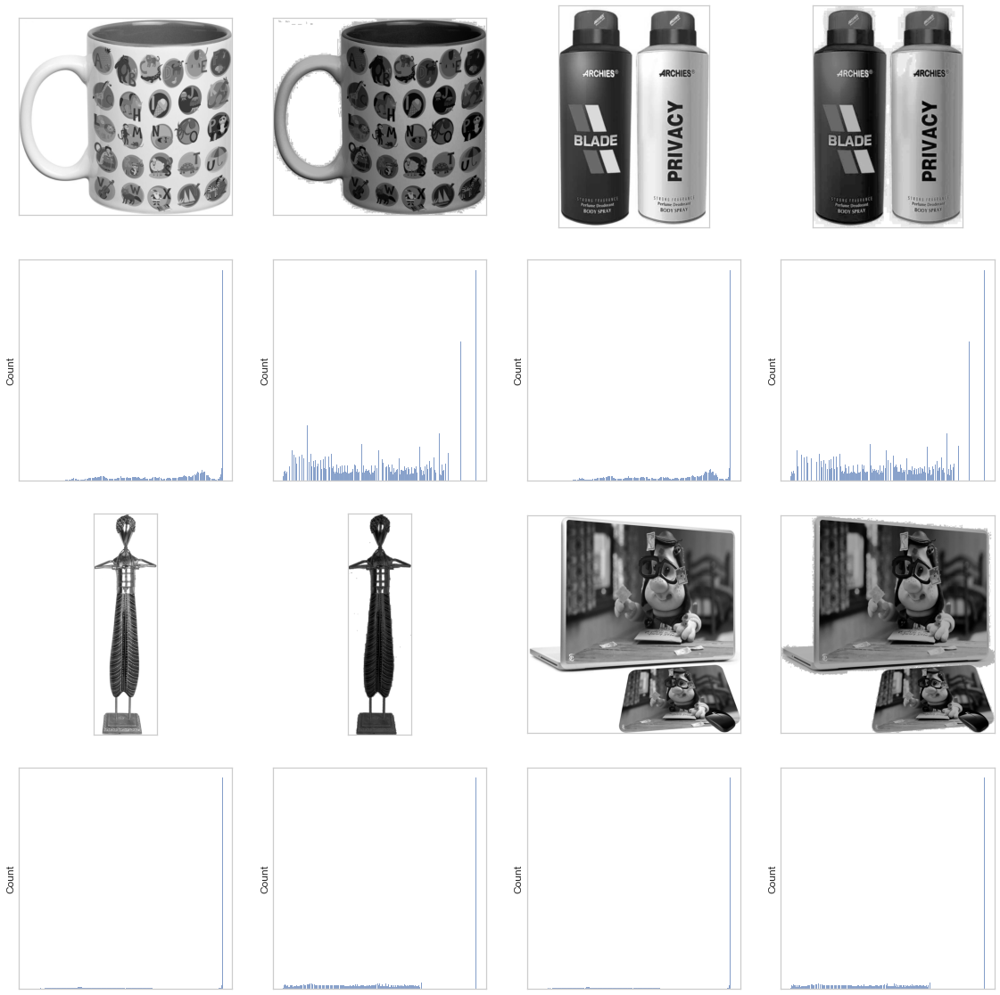

In [1001]:
compare_images_with_histogramme(equalize(4))

### Resize

In [452]:
import time
def new_dimension(max_length, interpolation, indx):
    """
    Resize images
    
    Positionnal argument:
    ---------------------------
    max_length : int : max dimension (height or width) of new image
    interpolation : cv2 interpolation to use
    indx : int : index of image to resize
    
    Return:
    ---------------------------
    time2 : float : time of computation
    img : image to resize
    img_resized : image resized
    
    """
    img = cv.imread('Images/'+images_directories[indx])
    time1 = time.time()
    height = img.shape[0]
    width = img.shape[1]
    dim_max = max(height, width)
    k=max_length/dim_max
    new_dim = (int(k*width), int(k*height))
    img_resized = cv.resize(img, new_dim, interpolation = interpolation)
    time2 = np.round(time.time() - time1, 6)
    return(time2, img, img_resized)

In [453]:
#Comparaison des méthodes d'interpolation

In [1039]:
time_nearest, img_nearest, img_resized_nearest = new_dimension(200, cv.INTER_NEAREST, 12)
time_linear, img_linear, img_resized_linear = new_dimension(200, cv.INTER_LINEAR, 12)
time_cubic, img_cubic, img_resized_cubic = new_dimension(200, cv.INTER_CUBIC, 12)
time_area, img_area, img_resized_area = new_dimension(200, cv.INTER_AREA, 12)
print(f"Temps de calcul - INTER_NEAREST : {time_nearest}\nTemps de calcul - INTER_LINEAR : {time_linear}\nTemps de calcul - INTER_CUBIC : {time_cubic}\nTemps de calcul - INTER_AREA : {time_area}")

Temps de calcul - INTER_NEAREST : 0.00764
Temps de calcul - INTER_LINEAR : 0.001572
Temps de calcul - INTER_CUBIC : 0.018703
Temps de calcul - INTER_AREA : 0.009588


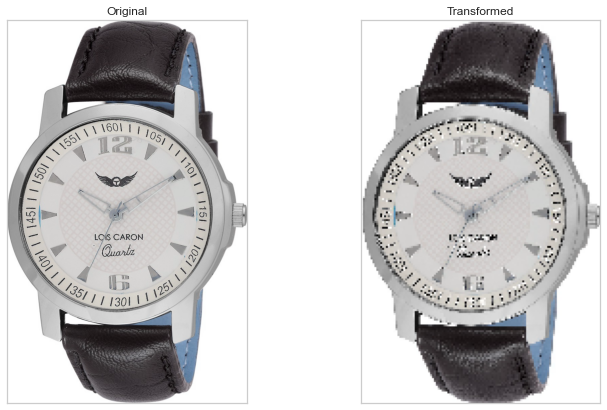

In [1040]:
compare_2_images(img_nearest, img_resized_nearest)

In [456]:
img_nearest.shape

(1145, 719, 3)

In [457]:
img_resized_nearest.shape

(400, 251, 3)

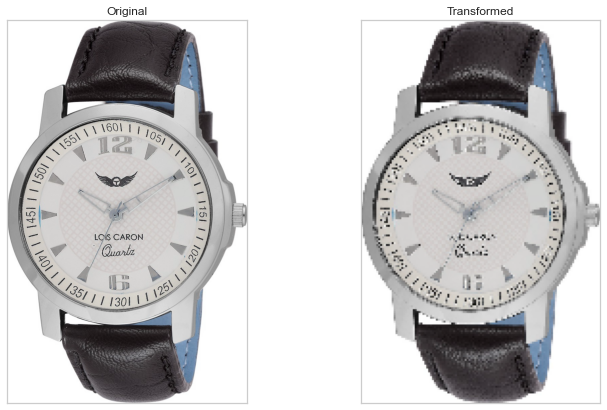

In [1041]:
compare_2_images(img_linear, img_resized_linear)

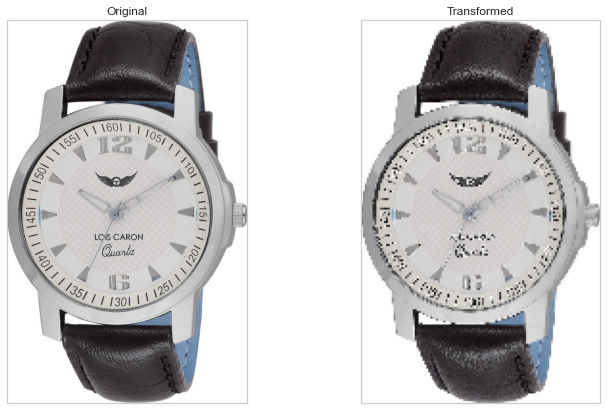

In [1042]:
compare_2_images(img_cubic, img_resized_cubic)

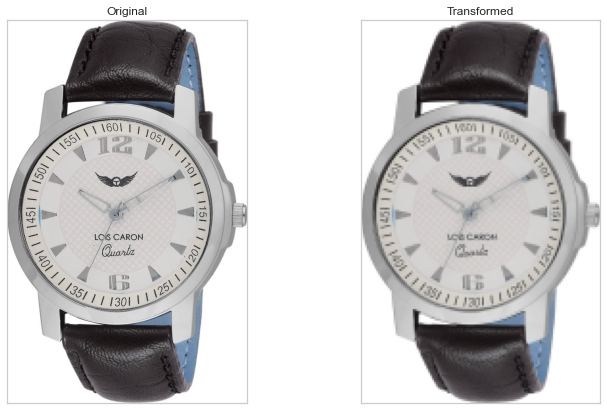

In [1043]:
compare_2_images(img_area, img_resized_area)

In [461]:
img_resized_area.shape

(400, 251, 3)

## Pré-traitement des images

In [462]:
def pre_treatment_resized_first(i, blur=cv.medianBlur, equalize=False, max_length=480, interpolation=cv.INTER_AREA, **kwargs):
    
    """
    Resize image first, Blur and equalize then image i
    
    Positionnal argument:
    ---------------------------
    i : int : index of image to treat
    
    Opt args :
    ---------------------------
    blur : cv2 blur to use
    equalize : bool : equalize if True
    max_length : int : max dimension (height or width) of new image
    interpolation : cv2 interpolation to use
    
    **kwargs
    if cv.blur : ksize=doublet
    if cv.GaussianBlur : ksize=doublet, sigmaX= integer
    if cv.medianBlur : ksize=integer
    if cv.bilateralFilter : d=integer, sigmaColor=integer, sigmaSpace=integer
    -----------------------------
    
    Return:
    ---------------------------
    img_blur : image treated
    
    """
    
    img = cv.imread('Images/'+images_directories[i])
    #time1 = time.time()
    img_nb = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    if equalize == True:
        img_nb = cv.equalizeHist(img_nb)
    height = img_nb.shape[0]
    width = img_nb.shape[1]
    dim_max = max(height, width)
    k=max_length/dim_max
    new_dim = (int(k*width), int(k*height))
    img_resized = cv.resize(img_nb, new_dim, interpolation = interpolation)
    if blur==cv.blur or blur==cv.medianBlur:
        ksize = kwargs.get('ksize')
        img_blur = blur(img_resized, ksize=ksize)
    elif blur==cv.GaussianBlur :
        ksize = kwargs.get('ksize')
        sigmaX = kwargs.get('sigmaX')
        img_blur = blur(img_resized, ksize=ksize , sigmaX=sigmaX)
    elif blur==cv.bilateralFilter:
        d = kwargs.get('d')
        sigmaColor = kwargs.get('sigmaColor')
        sigmaSpace = kwargs.get('sigmaSpace')
        img_blur = blur(img_resized, d=d, sigmaColor=sigmaColor, sigmaSpace=sigmaSpace)
    
    #time2 = round((time.time() - time1), 4)
    #print(time2)
    return img_blur

In [463]:
def pre_treatment_resized_last(i, blur=cv.medianBlur, equalize=False, max_length=480, interpolation=cv.INTER_AREA, **kwargs):
    
    """
    Blur and equalize first, resize image i then
    
    Positionnal argument:
    ---------------------------
    i : int : index of image to treat
    
    Opt args :
    ---------------------------
    blur : cv2 blur to use
    equalize : bool : equalize if True
    max_length : int : max dimension (height or width) of new image
    interpolation : cv2 interpolation to use
    
    **kwargs
    if cv.blur : ksize=doublet
    if cv.GaussianBlur : ksize=doublet, sigmaX= integer
    if cv.medianBlur : ksize=integer
    if cv.bilateralFilter : d=integer, sigmaColor=integer, sigmaSpace=integer
    -----------------------------
    
    Return:
    ---------------------------
    img_blur : image treated
    
    """
    
    img = cv.imread('Images/'+images_directories[i])
    #time1 = time.time()
    img_nb = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    if equalize == True:
        img_nb = cv.equalizeHist(img_nb)
    if blur==cv.blur or blur==cv.medianBlur:
        ksize = kwargs.get('ksize')
        img_blur = blur(img_nb, ksize=ksize)
    elif blur==cv.GaussianBlur :
        ksize = kwargs.get('ksize')
        sigmaX = kwargs.get('sigmaX')
        img_blur = blur(img_nb, ksize=ksize , sigmaX=sigmaX)
    elif blur==cv.bilateralFilter:
        d = kwargs.get('d')
        sigmaColor = kwargs.get('sigmaColor')
        sigmaSpace = kwargs.get('sigmaSpace')
        img_blur = blur(img_nb, d=d, sigmaColor=sigmaColor, sigmaSpace=sigmaSpace)
    height = img_blur.shape[0]
    width = img_blur.shape[1]
    dim_max = max(height, width)
    k=max_length/dim_max
    new_dim = (int(k*width), int(k*height))
    img_resized = cv.resize(img_blur, new_dim, interpolation = interpolation)
    #
    #time2 = round((time.time() - time1), 4)
    #print(time2)
    return img_blur

In [464]:
def pre_treatment_no_resize(i, blur=cv.medianBlur, equalize=False, **kwargs):
    
    """
    Blur and equalize image i 
    
    Positionnal argument:
    ---------------------------
    i : int : index of image to treat
    
    Opt args :
    ---------------------------
    blur : cv2 blur to use
    equalize : bool : equalize if True
    
    **kwargs
    if cv.blur : ksize=doublet
    if cv.GaussianBlur : ksize=doublet, sigmaX= integer
    if cv.medianBlur : ksize=integer
    if cv.bilateralFilter : d=integer, sigmaColor=integer, sigmaSpace=integer
    -----------------------------
    
    Return:
    ---------------------------
    img_blur : image treated
    
    """
    
    img = cv.imread('Images/'+images_directories[i])
    #time1 = time.time()
    img_nb = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    if equalize == True:
        img_nb = cv.equalizeHist(img_nb)
    if blur==cv.blur or blur==cv.medianBlur:
        ksize = kwargs.get('ksize')
        img_blur = blur(img_nb, ksize=ksize)
    elif blur==cv.GaussianBlur :
        ksize = kwargs.get('ksize')
        sigmaX = kwargs.get('sigmaX')
        img_blur = blur(img_nb, ksize=ksize , sigmaX=sigmaX)
    elif blur==cv.bilateralFilter:
        d = kwargs.get('d')
        sigmaColor = kwargs.get('sigmaColor')
        sigmaSpace = kwargs.get('sigmaSpace')
        img_blur = blur(img_nb, d=d, sigmaColor=sigmaColor, sigmaSpace=sigmaSpace)
    #time2 = round((time.time() - time1), 4)
    #print(time2)
    return img_blur

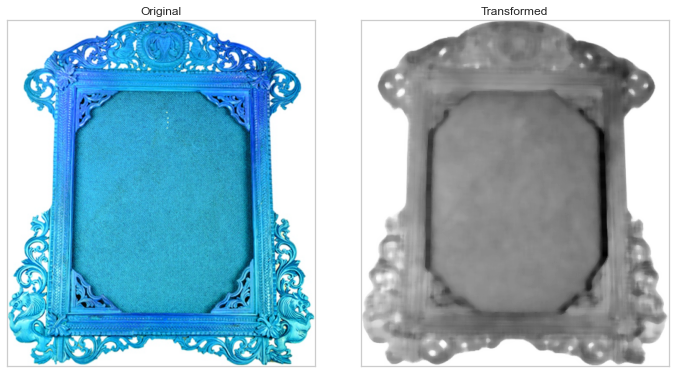

In [465]:
i= random.randint(0, len(images_directories))
img_transformed = pre_treatment_resized_first(i, blur=cv.medianBlur, equalize=False, max_length=480, interpolation=cv.INTER_AREA, ksize=11)
compare_2_images(cv.imread('Images/'+images_directories[i]), img_transformed)

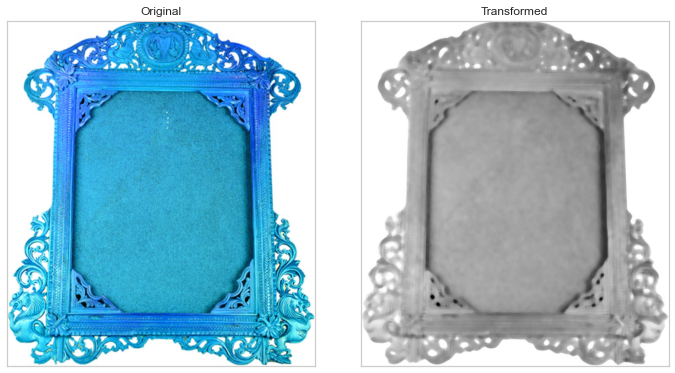

In [466]:
img_transformed = pre_treatment_resized_last(i, blur=cv.medianBlur, equalize=False, max_length=480, interpolation=cv.INTER_AREA, ksize=11)
compare_2_images(cv.imread('Images/'+images_directories[i]), img_transformed)

In [467]:
# Redimensionner au début permet d'uniformiser l'impact du blur sur les images (sinon la taille est très différente)

## Extraction Features

In [468]:
def extract_sift(i, nfeatures=500, blur=cv.medianBlur, equalize=False, max_length=480, interpolation=cv.INTER_AREA, **kwargs):
    
    """
    Resize image first, then blur and equalize image i
    Extract with SIFT nfeatures from image
    
    Positionnal argument:
    ---------------------------
    i : int : index of image to treat
    
    Opt args :
    ---------------------------
    nfeatures : int : number of features to extract
    blur : cv2 blur to use
    equalize : bool : equalize if True
    max_length : int : max dimension (height or width) of new image
    interpolation : cv2 interpolation to use
    
    **kwargs
    if cv.blur : ksize=doublet
    if cv.GaussianBlur : ksize=doublet, sigmaX= integer
    if cv.medianBlur : ksize=integer
    if cv.bilateralFilter : d=integer, sigmaColor=integer, sigmaSpace=integer
    -----------------------------
    
    Return:
    ---------------------------
    kp : 
    des : 
    
    """
    
    if blur==cv.blur or blur==cv.medianBlur:
        ksize = kwargs.get('ksize')
        img = pre_treatment_resized_first(i, blur=blur, equalize=equalize, max_length=max_length, interpolation=interpolation, ksize=ksize)
    elif blur==cv.GaussianBlur :
        ksize = kwargs.get('ksize')
        sigmaX = kwargs.get('sigmaX')
        img = pre_treatment_resized_first(i, blur=blur, equalize=equalize, max_length=max_length, interpolation=interpolation, ksize=ksize, sigmaX = sigmaX)
    elif blur==cv.bilateralFilter:
        d = kwargs.get('d')
        sigmaColor = kwargs.get('sigmaColor')
        sigmaSpace = kwargs.get('sigmaSpace')
        img = pre_treatment_resized_first(i, blur=blur, equalize=equalize, max_length=max_length, interpolation=interpolation, d=d, sigmaColor=sigmaColor, sigmaSpace=sigmaSpace)
    sift = cv.SIFT_create(nfeatures=nfeatures)
    kp, des = sift.detectAndCompute(img,None)
    return kp, des

In [469]:
def extract_sift_no_resize(i, nfeatures=500, blur=cv.medianBlur, equalize=False, **kwargs):
       
    """
    Blur and equalize image i
    Extract with SIFT nfeatures from image
    
    Positionnal argument:
    ---------------------------
    i : int : index of image to treat
    
    Opt args :
    ---------------------------
    nfeatures : int : number of features to extract
    blur : cv2 blur to use
    equalize : bool : equalize if True
    
    **kwargs
    if cv.blur : ksize=doublet
    if cv.GaussianBlur : ksize=doublet, sigmaX= integer
    if cv.medianBlur : ksize=integer
    if cv.bilateralFilter : d=integer, sigmaColor=integer, sigmaSpace=integer
    -----------------------------
    
    Return:
    ---------------------------
    kp : 
    des :
    
    """
    
    if blur==cv.blur or blur==cv.medianBlur:
        ksize = kwargs.get('ksize')
        img = pre_treatment_no_resize(i, blur=blur, equalize=equalize, ksize=ksize)
    elif blur==cv.GaussianBlur :
        ksize = kwargs.get('ksize')
        sigmaX = kwargs.get('sigmaX')
        img = pre_treatment_no_resize(i, blur=blur, equalize=equalize, ksize=ksize, sigmaX = sigmaX)
    elif blur==cv.bilateralFilter:
        d = kwargs.get('d')
        sigmaColor = kwargs.get('sigmaColor')
        sigmaSpace = kwargs.get('sigmaSpace')
        img = pre_treatment_no_resize(i, blur=blur, equalize=equalize, d=d, sigmaColor=sigmaColor, sigmaSpace=sigmaSpace)
    sift = cv.SIFT_create(nfeatures=nfeatures)
    kp, des = sift.detectAndCompute(img,None)
    return kp, des

In [470]:
def extract_ORB(i, nfeatures=500, blur=cv.medianBlur, equalize=False, max_length=480, interpolation=cv.INTER_AREA, **kwargs):
    
    
    """
    Resize image first, then blur and equalize image i
    Extract with ORB nfeatures from image
    
    Positionnal argument:
    ---------------------------
    i : int : index of image to treat
    
    Opt args :
    ---------------------------
    nfeatures : int : number of features to extract
    blur : cv2 blur to use
    equalize : bool : equalize if True
    max_length : int : max dimension (height or width) of new image
    interpolation : cv2 interpolation to use
    
    **kwargs
    if cv.blur : ksize=doublet
    if cv.GaussianBlur : ksize=doublet, sigmaX= integer
    if cv.medianBlur : ksize=integer
    if cv.bilateralFilter : d=integer, sigmaColor=integer, sigmaSpace=integer
    -----------------------------
    
    Return:
    ---------------------------
    kp : 
    des :
    
    """
    if blur==cv.blur or blur==cv.medianBlur:
        ksize = kwargs.get('ksize')
        img = pre_treatment_resized_first(i, blur=blur, equalize=equalize, max_length=max_length, interpolation=interpolation, ksize=ksize)
    elif blur==cv.GaussianBlur :
        ksize = kwargs.get('ksize')
        sigmaX = kwargs.get('sigmaX')
        img = pre_treatment_resized_first(i, blur=blur, equalize=equalize, max_length=max_length, interpolation=interpolation, ksize=ksize, sigmaX = sigmaX)
    elif blur==cv.bilateralFilter:
        d = kwargs.get('d')
        sigmaColor = kwargs.get('sigmaColor')
        sigmaSpace = kwargs.get('sigmaSpace')
        img = pre_treatment_resized_first(i, blur=blur, equalize=equalize, max_length=max_length, interpolation=interpolation, d=d, sigmaColor=sigmaColor, sigmaSpace=sigmaSpace)
    orb = cv.ORB_create(nfeatures=nfeatures)
    kp, des = orb.detectAndCompute(img,None)
    return kp, des

In [471]:
def contrast_luminosity_invariance(X):
    X_norm = X/np.sqrt(((X)**2).sum(axis=1)).reshape(X.shape[0], 1)
    X_norm_trunc = (X_norm < 0.2) * X_norm + 0.2*(X_norm >= 0.2)
    X_norm_trunc_norm = X_norm_trunc/np.sqrt(((X_norm_trunc)**2).sum(axis=1)).reshape(X_norm_trunc.shape[0], 1)
    return X_norm_trunc_norm

### SIFT - 500 features

In [472]:
time1 = time.time()
kp01, des01 = extract_sift(0, nfeatures=500, blur=cv.medianBlur, equalize=True, max_length=480, interpolation=cv.INTER_AREA, ksize=5)
features1 = des01
descriptors1 = [features1]
for i in range(1, len(images_directories)):
#for i in range(1, 20):
    kp1, des1 = extract_sift(i, nfeatures=500, blur=cv.medianBlur, equalize=True, max_length=480, interpolation=cv.INTER_AREA, ksize=5)
    descriptors1 += [des1]
    features1 = np.concatenate((features1, des1))
time2 = time.time() - time1
time2

197.8632619380951

In [473]:
features1.shape

(372523, 128)

In [474]:
len(descriptors1)

1050

#### Bag of Visual words

In [475]:
from sklearn import cluster
# Création du bag of visual words avec un nombre de mots choisis = n_words
n_words=int(round(np.sqrt(features1.shape[0]),0))
model_clust = cluster.MiniBatchKMeans(n_clusters=n_words, init_size=3*n_words, random_state=42)
model_clust.fit_transform(features1)
BOVW = model_clust.cluster_centers_

In [476]:
BOVW.shape

(610, 128)

In [477]:
def descriptors_to_histogram(descriptor, model):
    return np.histogram(model.predict(descriptor), bins=range(n_words+1), density=True)[0]

In [478]:
histogrammes = pd.DataFrame(descriptors_to_histogram(descriptors1[0], model_clust)).transpose()
for i in range(1, len(images_directories)):
    histogrammes = pd.concat((histogrammes, pd.DataFrame(descriptors_to_histogram(descriptors1[i], model_clust)).transpose()), axis=0, ignore_index=True)

#### PCA

In [479]:
pca_image = PCA(n_components=0.99, svd_solver='full')
pca_image.fit(histogrammes)

PCA(n_components=0.99, svd_solver='full')

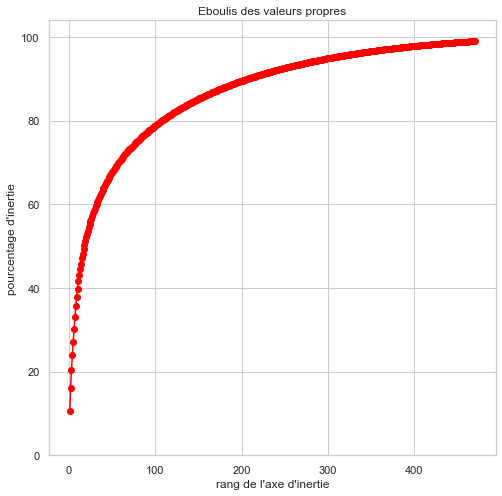

In [480]:
# Eboulis des valeurs propres
scree = pca_image.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

In [481]:
# On transforme histogrammes_scaled en projetant sur les premières directions
reduced_histo = pd.DataFrame(pca_image.transform(histogrammes))
reduced_histo.shape

(1050, 470)

#### Clustering non supervisé

In [482]:
ARI, X_tsne, labels, time2 = ARI_fct(reduced_histo, nb_clusters, categories_num, 30, 500)

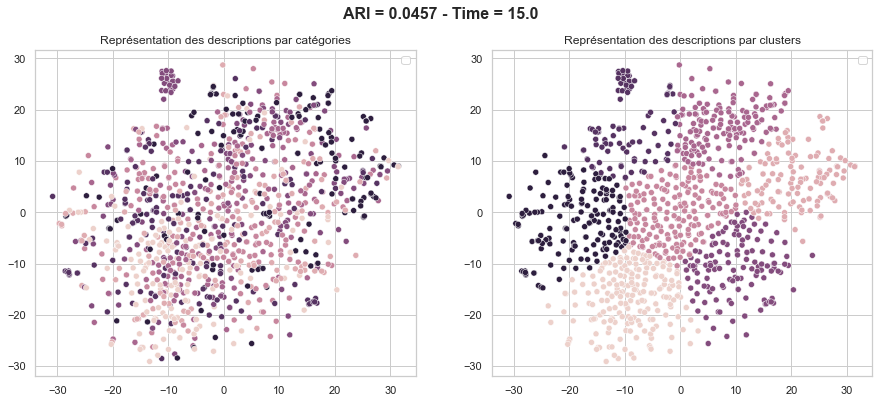

In [483]:
TSNE_visu_fct(ARI, X_tsne, labels, time2, categories_num)

### SIFT - 500 features sans floutage

In [688]:
time1 = time.time()
kp02, des02 = extract_sift(0, nfeatures=500, blur=cv.blur, equalize=True, max_length=480, interpolation=cv.INTER_AREA, ksize=(1, 1))
features2 = des02
descriptors2 = [features2]
for i in range(1, len(images_directories)):
#for i in range(1, 20):
    kp2, des2 = extract_sift(i, nfeatures=500, blur=cv.blur, equalize=True, max_length=480, interpolation=cv.INTER_AREA, ksize=(1, 1))
    descriptors2 += [des2]
    features2 = np.concatenate((features2, des2))
time2 = time.time() - time1
time2

224.90630197525024

In [689]:
features2.shape

(464411, 128)

In [690]:
len(descriptors2)

1050

#### Bag of Visual words

In [691]:
# Création du bag of visual words avec un nombre de mots choisis = n_words
n_words=int(round(np.sqrt(features2.shape[0]),0))
model_clust2 = cluster.MiniBatchKMeans(n_clusters=n_words, init_size=3*n_words, random_state=42)
model_clust2.fit_transform(features2)
BOVW2 = model_clust2.cluster_centers_

In [692]:
BOVW2.shape

(681, 128)

In [693]:
histogrammes2 = pd.DataFrame(descriptors_to_histogram(descriptors2[0], model_clust2)).transpose()
for i in range(1, len(images_directories)):
    histogrammes2 = pd.concat((histogrammes2, pd.DataFrame(descriptors_to_histogram(descriptors2[i], model_clust2)).transpose()), axis=0, ignore_index=True)

#### PCA

In [694]:
pca_image2 = PCA(n_components=0.99, svd_solver='full')
pca_image2.fit(histogrammes2)

PCA(n_components=0.99, svd_solver='full')

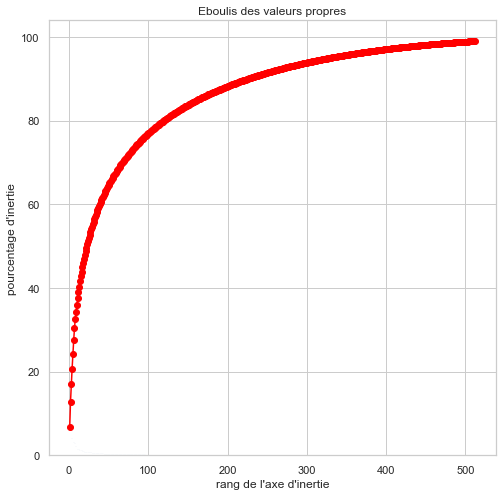

In [695]:
# Eboulis des valeurs propres
scree = pca_image2.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

In [696]:
# On transforme histogrammes_scaled en projetant sur les premières directions
reduced_histo2 = pd.DataFrame(pca_image2.transform(histogrammes2))
reduced_histo2.shape

(1050, 512)

#### Clustering non supervisé

In [697]:
ARI, X_tsne, labels, time2 = ARI_fct(reduced_histo2, nb_clusters, categories_num, 30, 1000)

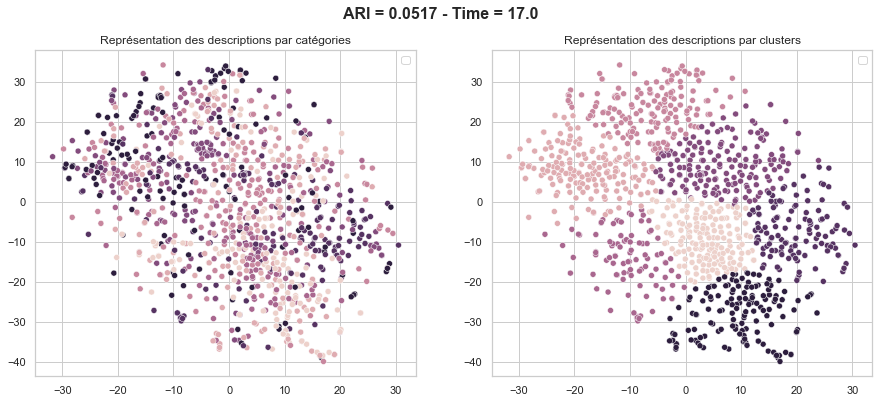

In [698]:
TSNE_visu_fct(ARI, X_tsne, labels, time2, categories_num)

### SIFT - 500 features - GaussianBlur

In [699]:
time1 = time.time()
kp03, des03 = extract_sift(0, nfeatures=500, blur=cv.GaussianBlur, equalize=True, max_length=480, interpolation=cv.INTER_AREA, ksize=(9, 9), sigmaX=2)
features3 = des03
descriptors3 = [features3]
for i in range(1, len(images_directories)):
#for i in range(1, 20):
    kp3, des3 = extract_sift(i, nfeatures=500, blur=cv.GaussianBlur, equalize=True, max_length=480, interpolation=cv.INTER_AREA, ksize=(9, 9), sigmaX=2)
    descriptors3 += [des3]
    features3 = np.concatenate((features3, des3))
time2 = time.time() - time1
time2

136.73664808273315

In [700]:
i

1049

In [701]:
features3.shape

(229445, 128)

In [702]:
len(descriptors3)

1050

#### Bag of Visual words

In [703]:
# Création du bag of visual words avec un nombre de mots choisis = n_words
n_words=int(round(np.sqrt(features3.shape[0]),0))
model_clust3 = cluster.MiniBatchKMeans(n_clusters=n_words, init_size=3*n_words, random_state=42)
model_clust3.fit_transform(features3)
BOVW3 = model_clust3.cluster_centers_

In [704]:
BOVW3.shape

(479, 128)

In [705]:
def descriptors_to_histogram(descriptor, model):
    return np.histogram(model.predict(descriptor), bins=range(n_words+1), density=True)[0]

In [706]:
histogrammes3 = pd.DataFrame(descriptors_to_histogram(descriptors3[0], model_clust3)).transpose()
for i in range(1, len(images_directories)):
    histogrammes3 = pd.concat((histogrammes3, pd.DataFrame(descriptors_to_histogram(descriptors3[i], model_clust3)).transpose()), axis=0, ignore_index=True)

#### PCA

In [707]:
pca_image3 = PCA(n_components=0.99, svd_solver='full')
pca_image3.fit(histogrammes3)

PCA(n_components=0.99, svd_solver='full')

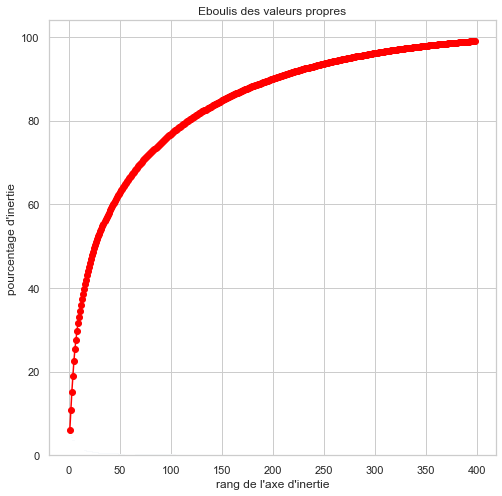

In [708]:
# Eboulis des valeurs propres
scree = pca_image3.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

In [709]:
# On transforme histogrammes_scaled en projetant sur les premières directions
reduced_histo3 = pd.DataFrame(pca_image3.transform(histogrammes3))
reduced_histo3.shape

(1050, 398)

#### Clustering non supervisé

In [710]:
ARI, X_tsne, labels, time2 = ARI_fct(reduced_histo3, nb_clusters, categories_num, 30, 800)

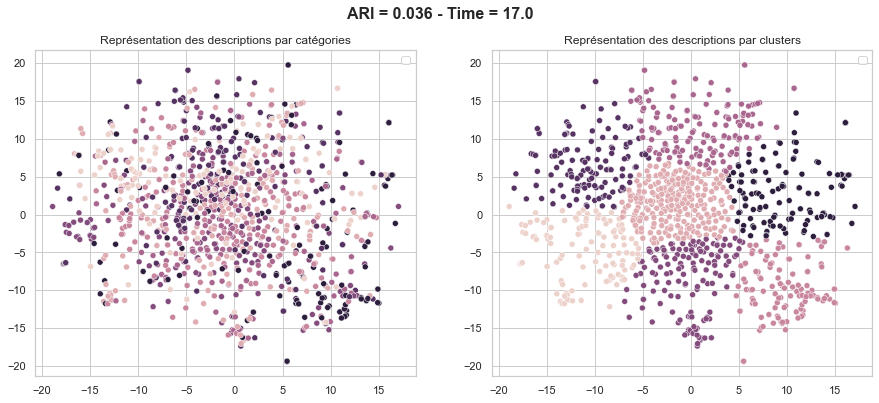

In [711]:
TSNE_visu_fct(ARI, X_tsne, labels, time2, categories_num)

### SIFT - 500 features - grandes images

In [712]:
time1 = time.time()
kp04, des04 = extract_sift(0, nfeatures=500, blur=cv.medianBlur, equalize=True, max_length=800, interpolation=cv.INTER_AREA, ksize=5)
features4 = des04
descriptors4 = [features4]
for i in range(1, len(images_directories)):
#for i in range(1, 20):
    kp4, des4 = extract_sift(i, nfeatures=500, blur=cv.medianBlur, equalize=True, max_length=800, interpolation=cv.INTER_AREA, ksize=5)
    descriptors4 += [des4]
    features4 = np.concatenate((features4, des4))
time2 = time.time() - time1
time2

273.6658790111542

In [713]:
features4.shape

(487776, 128)

In [714]:
len(descriptors4)

1050

#### Bag of Visual words

In [715]:
# Création du bag of visual words avec un nombre de mots choisis = n_words
n_words=int(round(np.sqrt(features4.shape[0]),0))
model_clust4= cluster.MiniBatchKMeans(n_clusters=n_words, init_size=3*n_words, random_state=42)
model_clust4.fit_transform(features4)
BOVW4 = model_clust4.cluster_centers_

In [716]:
BOVW4.shape

(698, 128)

In [717]:
histogrammes4 = pd.DataFrame(descriptors_to_histogram(descriptors4[0], model_clust4)).transpose()
for i in range(1, len(images_directories)):
    histogrammes4 = pd.concat((histogrammes4, pd.DataFrame(descriptors_to_histogram(descriptors4[i], model_clust4)).transpose()), axis=0, ignore_index=True)

#### PCA

In [718]:
pca_image4 = PCA(n_components=0.99, svd_solver='full')
pca_image4.fit(histogrammes4)

PCA(n_components=0.99, svd_solver='full')

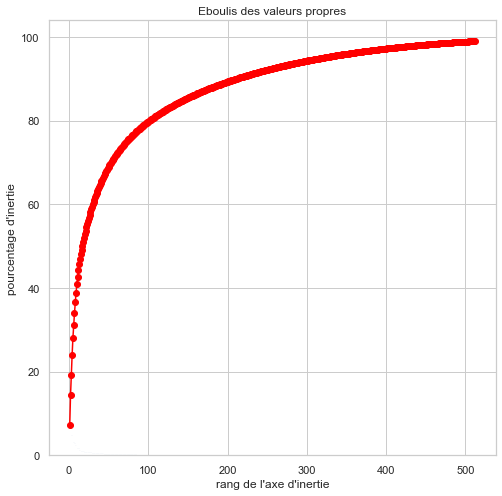

In [719]:
# Eboulis des valeurs propres
scree = pca_image4.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

In [720]:
# On transforme histogrammes_scaled en projetant sur les premières directions
reduced_histo4 = pd.DataFrame(pca_image4.transform(histogrammes4))
reduced_histo4.shape

(1050, 512)

#### Clustering non supervisé

In [721]:
ARI, X_tsne, labels, time2 = ARI_fct(reduced_histo4, nb_clusters, categories_num, 30, 1000)

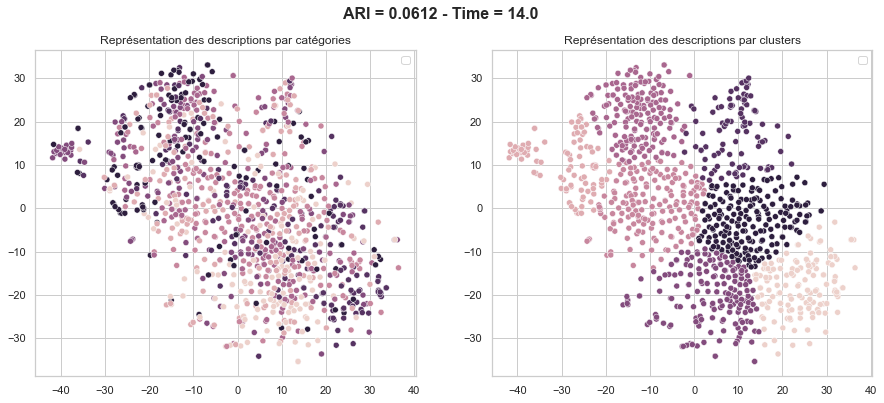

In [722]:
TSNE_visu_fct(ARI, X_tsne, labels, time2, categories_num)

#### Clustering supervisé

In [723]:
X_train_image, y_train_predict_X_train_image, y_train_X_train_image, ARI_train_X_train_image, X_test_X_train_image, y_test_predict_X_train_image, y_test_X_train_image, ARI_test_X_train_image = supervised_classification(reduced_histo4, 
                                                                                                                                            categories_num, 
                                                                                                                                            LogisticRegression(dual=False))

score_train : 0.47619047619047616
score_test : 0.40476190476190477


In [724]:
categories_name_number

,number,category
0,0,home furnishing
1,1,baby care
2,2,watches
3,3,home decor festive needs
4,4,kitchen dining
5,5,beauty and personal care
6,6,computers


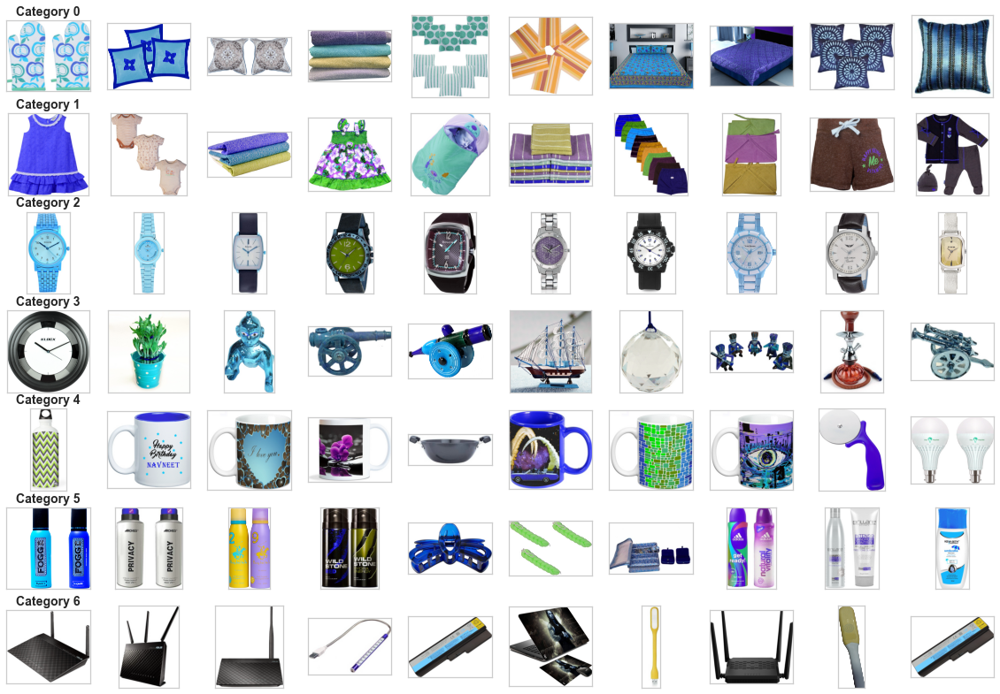

In [725]:
random_images_per_category(10)

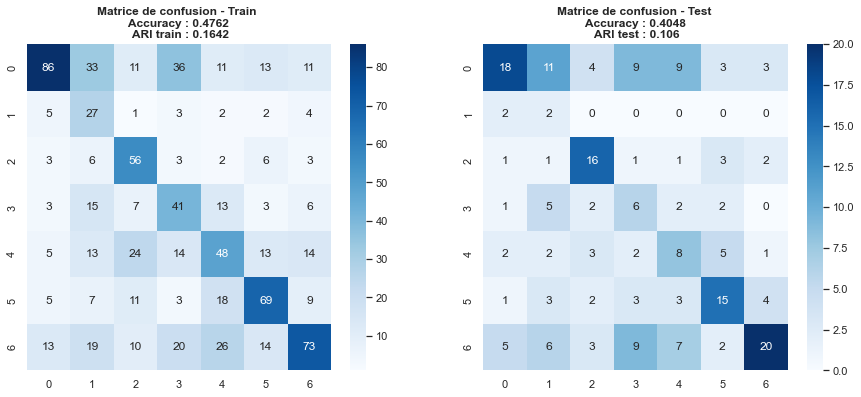

In [726]:
supervised_classification_confusion_matrice(reduced_histo4, 
                                         X_train_image, 
                                         y_train_predict_X_train_image, 
                                         y_train_X_train_image, 
                                         ARI_train_X_train_image, 
                                         X_test_X_train_image, 
                                         y_test_predict_X_train_image, 
                                         y_test_X_train_image, 
                                         ARI_test_X_train_image)

In [727]:
# Fait un peu mieux que par hasard....

In [728]:
from sklearn.dummy import DummyClassifier
X_train_image_dum, y_train_predict_X_train_image_dum, y_train_X_train_image_dum, ARI_train_X_train_image_dum, X_test_X_train_image_dum, y_test_predict_X_train_image_dum, y_test_X_train_image_dum, ARI_test_X_train_image_dum = supervised_classification(reduced_histo4, 
                                                                                                                                            categories_num, 
                                                                                                                                            DummyClassifier(strategy='uniform'))

score_train : 0.13452380952380952
score_test : 0.05714285714285714


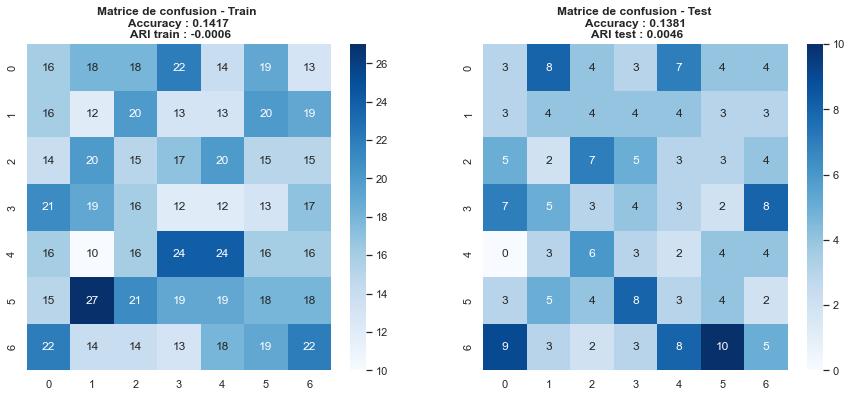

In [729]:
supervised_classification_confusion_matrice(reduced_histo4, 
                                         X_train_image_dum, y_train_predict_X_train_image_dum, y_train_X_train_image_dum, ARI_train_X_train_image_dum, X_test_X_train_image_dum, y_test_predict_X_train_image_dum, y_test_X_train_image_dum, ARI_test_X_train_image_dum)

### SIFT - 300 features - taille originale

In [952]:
time1 = time.time()
kp05, des05 = extract_sift_no_resize(0, nfeatures=300, blur=cv.blur, equalize=True, ksize=(5, 5))
features5 = des05
descriptors5 = [features5]
for i in range(1, len(images_directories)):
#for i in range(1, 20):
    kp5, des5 = extract_sift_no_resize(i, nfeatures=300, blur=cv.blur, equalize=True, ksize=(5, 5))
    descriptors5 += [des5]
    features5 = np.concatenate((features5, des5))
time2 = time.time() - time1
time2

1052.2161629199982

In [953]:
features5.shape

(305018, 128)

In [954]:
len(descriptors5)

1050

#### Bag of Visual words

In [955]:
# Création du bag of visual words avec un nombre de mots choisis = n_words
n_words=int(round(np.sqrt(features5.shape[0]),0))
model_clust5= cluster.MiniBatchKMeans(n_clusters=n_words, init_size=3*n_words, random_state=42)
model_clust5.fit_transform(features5)
BOVW5 = model_clust5.cluster_centers_

In [956]:
BOVW5.shape

(552, 128)

In [957]:
histogrammes5 = pd.DataFrame(descriptors_to_histogram(descriptors5[0], model_clust5)).transpose()
for i in range(1, len(images_directories)):
    histogrammes5 = pd.concat((histogrammes5, pd.DataFrame(descriptors_to_histogram(descriptors5[i], model_clust5)).transpose()), axis=0, ignore_index=True)

#### PCA

In [958]:
pca_image5 = PCA(n_components=0.99, svd_solver='full')
pca_image5.fit(histogrammes5)

PCA(n_components=0.99, svd_solver='full')

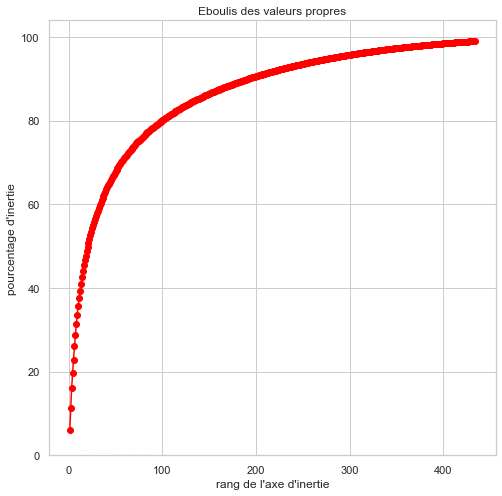

In [959]:
# Eboulis des valeurs propres
scree = pca_image5.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

In [960]:
# On transforme histogrammes_scaled en projetant sur les 100 premières directions
reduced_histo5 = pd.DataFrame(pca_image5.transform(histogrammes5))
reduced_histo5.shape

(1050, 434)

#### Clustering non supervisé

In [963]:
ARI, X_tsne, labels, time2 = ARI_fct(reduced_histo5, nb_clusters, categories_num, 30, 1500)

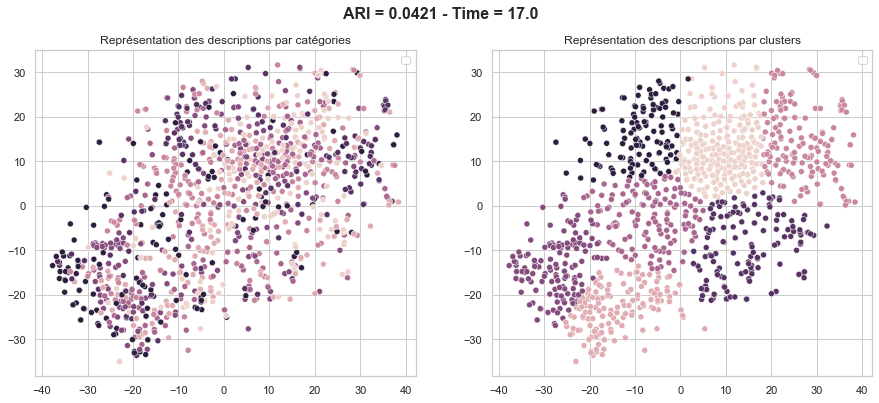

In [964]:
TSNE_visu_fct(ARI, X_tsne, labels, time2, categories_num)

### ORB

In [741]:
time1 = time.time()
kp06, des06 = extract_ORB(0, nfeatures=500, blur=cv.blur, equalize=True, max_length=800, interpolation=cv.INTER_AREA, ksize=(1, 1))
features6 = des06
descriptors6 = [features6]
for i in range(1, len(images_directories)):
#for i in range(1, 20):
    kp6, des6 = extract_ORB(i, nfeatures=500, blur=cv.blur, equalize=True, max_length=800, interpolation=cv.INTER_AREA, ksize=(1, 1))
    descriptors6 += [des6]
    features6 = np.concatenate((features6, des6))
time2 = time.time() - time1
time2

63.7686231136322

In [742]:
i

1049

#### Bag of Visual words

In [743]:
from sklearn import cluster
# Création du bag of visual words avec un nombre de mots = n_words
n_words=int(round(np.sqrt(features1.shape[0]),0))
model_clust6 = cluster.MiniBatchKMeans(n_clusters=n_words, random_state=42)
model_clust6.fit_transform(features6)
BOVW6 = model_clust6.cluster_centers_

In [744]:
BOVW6.shape

(610, 32)

In [745]:
len(descriptors1)

1050

In [746]:
histogrammes6 = pd.DataFrame(descriptors_to_histogram(descriptors6[0], model_clust6)).transpose()
for i in range(1, len(images_directories)):
    histogrammes6 = pd.concat((histogrammes6, pd.DataFrame(descriptors_to_histogram(descriptors6[i], model_clust6)).transpose()), axis=0, ignore_index=True)

#### PCA

In [747]:
from sklearn.decomposition import PCA

In [748]:
histogrammes6.shape

(1050, 610)

In [749]:
# nombre de composantes à calculer
pca_image6 = PCA(n_components=0.99, svd_solver='full')
pca_image6.fit(histogrammes6)

PCA(n_components=0.99, svd_solver='full')

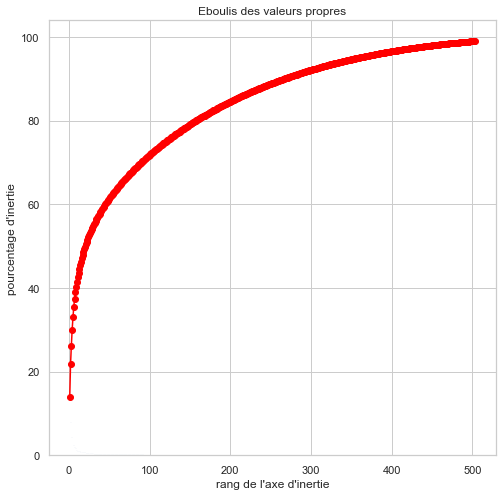

In [750]:
# Eboulis des valeurs propres
scree = pca_image6.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

In [751]:
# On transforme histogrammes_scaled en projetant sur les 100 premières directions
reduced_histo6 = pd.DataFrame(pca_image6.transform(histogrammes6))
reduced_histo6.shape

(1050, 503)

#### Clustering non supervisé

In [752]:
ARI, X_tsne, labels, time2 = ARI_fct(reduced_histo6, nb_clusters, categories_num, 30, 2000)

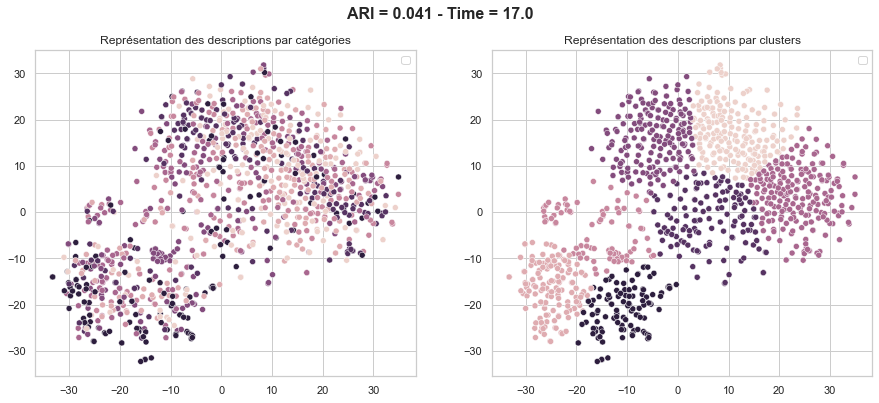

In [753]:
TSNE_visu_fct(ARI, X_tsne, labels, time2, categories_num)

## VGG16

In [754]:
from keras.utils import load_img, img_to_array
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import VGG16
from keras.layers import Dense, Flatten
from keras import Model

### VGG16 compris fully connected

In [755]:
# Charger VGG-16 pré-entraîné sur ImageNet et avec les couches fully-connected 
vgg16_cls = VGG16(weights="imagenet", include_top=True, input_shape=(224, 224, 3))
vgg16_cls.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [756]:
# Tester les prédictions de VGG16 sur produits random

In [757]:
from keras.applications.vgg16 import decode_predictions

In [758]:
img = load_img('Images/'+images_directories[90], target_size=(224, 224))
img = img_to_array(img)  
img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))  
img = preprocess_input(img) 
yhat = vgg16_cls.predict(img)

1/1 [==============================] - 1s 1s/step


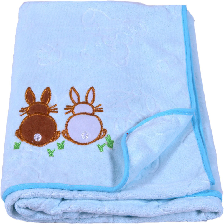

In [759]:
r = random.randint(0, len(images_directories))
img = load_img('Images/'+images_directories[r], target_size=(224, 224))
img

In [760]:
img = img_to_array(img)  
img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))  
img = preprocess_input(img) 
yhat = vgg16_cls.predict(img)
label = decode_predictions(yhat)
label

1/1 [==============================] - 0s 452ms/step


[[('n02808304', 'bath_towel', 0.84712726),
  ('n03485794', 'handkerchief', 0.13206777),
  ('n03188531', 'diaper', 0.008725064),
  ('n02834397', 'bib', 0.0077347565),
  ('n04548362', 'wallet', 0.00096470915)]]

In [761]:
img.shape

(1, 224, 224, 3)

### VGG16 sans couche fully connected

#### Train, validation and test set

In [762]:
train_image = images_directories[train_index].reset_index()
test_image = images_directories[test_index].reset_index()
y_train = categories_num[train_index]
y_test = categories_num[test_index]

In [763]:
# Copier les images dans des folders spécifiques à chaque catégorie

In [764]:
import glob
import shutil
import os

In [765]:
train_image

,index,image
0,535,b19c9174113c2b9288157e14c48a8250.jpg
1,13,189fa66a5fa6f08d2802a62ecf0be298.jpg
2,8,41384da51732c0b4df3de8f395714fbb.jpg
3,892,6858fd9265d348803b18667fe43cd054.jpg
4,917,27175ea71cc5f2879882c77b9931cf8b.jpg
...,...,...
835,861,ad08a6efe82576ab162a9336feff647f.jpg
836,668,3f025b9dc8065fe5a155573e5b21a70d.jpg
837,626,73901494efea71869576898c68b5eee4.jpg
838,426,70461caa9038cfa34d109ea056d57f5a.jpg


In [766]:
src_dir = 'Images/'+train_image['image'][0]
src_dir

'Images/b19c9174113c2b9288157e14c48a8250.jpg'

In [767]:
dst_dir = 'essai'
shutil.copy(src_dir, dst_dir)

'essai/b19c9174113c2b9288157e14c48a8250.jpg'

In [768]:
categories_name_number

,number,category
0,0,home furnishing
1,1,baby care
2,2,watches
3,3,home decor festive needs
4,4,kitchen dining
5,5,beauty and personal care
6,6,computers


In [769]:
images_directories.shape

(1050,)

In [770]:
for i, category in enumerate(categories_name_number['category']): 
    mask = categories['category1']== category
    images_directories_cat = images_directories[mask]
    mask1 = images_directories_cat.index.isin(train_index)
    images_directories_cat = images_directories_cat[mask1]

    for path in images_directories_cat:
        src_dir = 'Images/'+path
        dst_dir = 'train_set/'+str(i)+category
        shutil.copy(src_dir, dst_dir)

In [771]:
for i, category in enumerate(categories_name_number['category']): 
    mask = categories['category1']== category
    images_directories_cat = images_directories[mask]
    mask1 = images_directories_cat.index.isin(test_index)
    images_directories_cat = images_directories_cat[mask1]

    for path in images_directories_cat:
        src_dir = 'Images/'+path
        dst_dir = 'test_set/'+str(i)+category
        shutil.copy(src_dir, dst_dir)

In [772]:
# Créer un train set et validation set à partir des folders catégories

In [773]:
from keras.utils import image_dataset_from_directory
main_directory = 'train_set/'
main_directory_test = 'test_set/'

In [774]:
X_train = image_dataset_from_directory(main_directory, labels='inferred', label_mode='int', validation_split=0.2, subset='training', seed=0, batch_size=30, image_size=(224, 224), shuffle=True, crop_to_aspect_ratio=True)
X_validation = image_dataset_from_directory(main_directory, labels='inferred', label_mode='int', validation_split=0.2, subset='validation', seed=0, batch_size=30, image_size=(224, 224), shuffle=True, crop_to_aspect_ratio=True)
X_test = image_dataset_from_directory(main_directory_test, labels='inferred', label_mode='int', batch_size=30, image_size=(224, 224), crop_to_aspect_ratio=True, shuffle=False )

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Found 845 files belonging to 7 classes.
Using 676 files for training.
Found 845 files belonging to 7 classes.
Using 169 files for validation.
Found 210 files belonging to 7 classes.


In [775]:
class_labels = X_validation.class_names
class_labels

['0home furnishing',
 '1baby care',
 '2watches',
 '3home decor festive needs',
 '4kitchen dining',
 '5beauty and personal care',
 '6computers']

In [776]:
X_test

<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

#### Création model

In [777]:
model = VGG16(weights="imagenet", include_top=False, input_shape=(224, 224, 3))
x = model.output
xf=Flatten()(x)
predictions = Dense(7, activation='softmax')(xf)
new_model = Model(inputs=model.input, outputs=predictions)

In [778]:
 for layer in new_model.layers[:-2]:
    layer.trainable = False

In [779]:
new_model.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [780]:
import keras
from keras import optimizers

opt = optimizers.SGD(learning_rate=0.001, momentum=0.9)
new_model.compile(loss='SparseCategoricalCrossentropy', optimizer=opt, metrics=["accuracy"])

In [781]:
#epochs = 3 
#new_model.fit(x=X_train, validation_data=X_validation, epochs=epochs, verbose=2)

In [782]:
#new_model.save('my_VGG16_version1')

In [783]:
model_loaded = keras.models.load_model('my_VGG16_version1')


In [784]:
# Evaluation du modèle

In [785]:
y_train_predict_eval = model_loaded.evaluate(X_train)

23/23 [==============================] - 506s 22s/step - loss: 1.9141 - accuracy: 0.9882


In [786]:
y_test_predict_eval = model_loaded.evaluate(X_test)

7/7 [==============================] - 158s 22s/step - loss: 122.3325 - accuracy: 0.7857


In [787]:
y_val_predict_eval = model_loaded.evaluate(X_validation)

6/6 [==============================] - 141s 23s/step - loss: 104.1124 - accuracy: 0.7988


In [788]:
# matrices de confusion pour chaque set

In [789]:
X_test_unbatch = X_test.unbatch()
X_test_unbatch

<_UnbatchDataset element_spec=(TensorSpec(shape=(224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int32, name=None))>

In [790]:
labels_test = []
for x, y in X_test_unbatch:
    labels_test += [y.numpy()]
pd.DataFrame(labels_test).value_counts()

0    30
1    30
2    30
3    30
4    30
5    30
6    30
dtype: int64

In [791]:
y_test_predict = model_loaded.predict(X_test)
predictions_test = []
predictions_test = np.argmax(y_test_predict, axis=1).tolist()

7/7 [==============================] - 114s 16s/step


In [792]:
y_test_predict

array([[1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.]], dtype=float32)

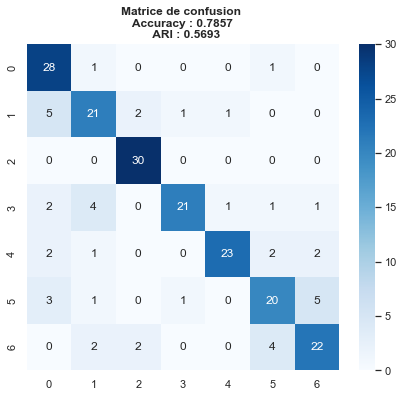

In [793]:
confusion_matrix_plot(labels_test, predictions_test)

In [794]:
# Matrice de confusion pour les images du train+validation set

In [795]:
train_images = image_dataset_from_directory(main_directory, labels='inferred', label_mode='int', 
                                       batch_size=30, image_size=(224, 224), shuffle=False, 
                                       crop_to_aspect_ratio=True)

Found 845 files belonging to 7 classes.


In [796]:
train_images_unbatch = train_images.unbatch()
labels_train = []
for x, y in train_images_unbatch:
    labels_train += [y.numpy()]
len(labels_train)

845

In [797]:
train_images_predict = model_loaded.predict(train_images)

29/29 [==============================] - 333s 11s/step


In [798]:
train_prediction = np.argmax(train_images_predict, axis=1)
len(train_prediction)

845

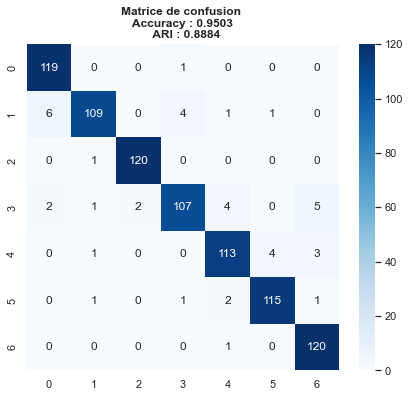

In [799]:
confusion_matrix_plot(labels_train, train_prediction)

#### Model complet avec text

In [800]:
test_texts

862     Techone+ Portable SE122103-WHITE USB Led Light...
335     Buy Tenda A5 only for Rs. 2250 from Flipkart.c...
1049    Buy Uberlyfe Large Vinyl Sticker for Rs.595 on...
238     Buy Metallino Hard Anodised Kadhai 1.2 L for R...
971     Key Features of Sparklings Cotton Geometric Do...
                              ...                        
289     Key Features of Services Junction Gold Plated ...
84      Specifications of @home Glass Vase (18 inch, G...
901     Key Features of @home Earthy Wine Net Ceramic ...
914     Specifications of 612 League Baby Boy's Checke...
19      Ridas Apl_led_black Apple Shape Digital Watch ...
Length: 210, dtype: object

In [801]:
test_images = images_directories[test_index]
test_images

862     832a66ce379b4c98fd3d748eebd7ae4c.jpg
335     353ddb2c8ab6920d8ad1055abee87dda.jpg
1049    f2f027ad6a6df617c9f125173da71e44.jpg
238     2e8df36b35d22cf219cf8bae6c2af752.jpg
971     0906fd9cc604fbba05a502e01d763cd9.jpg
                        ...                 
289     2aaa6083689193df5ab01fe37dea1b5e.jpg
84      374e63028d691c380bc43b0dc60e460d.jpg
901     5c0fe2919e49f30aff91d46800cdf149.jpg
914     762b6b22cccf91935e92446efe298fe3.jpg
19      33d97d63c037078cd3f08033966d6a88.jpg
Name: image, Length: 210, dtype: object

In [802]:
test_index

Int64Index([ 862,  335, 1049,  238,  971,  754,  555,  365,  791,  203,
            ...
             176,  653,  770,  687, 1030,  289,   84,  901,  914,   19],
           dtype='int64', length=210)

In [803]:
full_model_image = keras.models.load_model('my_VGG16_version1')
tokenizer_DistilBert = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
full_model_text = TFDistilBertForSequenceClassification.from_pretrained('clf')

Some layers from the model checkpoint at clf were not used when initializing TFDistilBertForSequenceClassification: ['dropout_176']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some layers of TFDistilBertForSequenceClassification were not initialized from the model checkpoint at clf and are newly initialized: ['dropout_133']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [804]:
image_and_text = np.empty((1, 14))
for index in test_index:
    image = load_img('images/'+test_images[index], target_size=(224, 224), interpolation="nearest", keep_aspect_ratio=False)
    image = img_to_array(image).reshape((1, 224, 224, 3))
    vect_image = full_model_image(image)
    texte = test_texts[index]
    text_token = tokenizer_DistilBert.encode(texte,truncation=True,padding=True,return_tensors="tf")
    vect_text = tf.math.softmax(full_model_text(text_token).logits, axis=1).numpy()
    vect = np.concatenate((vect_image, vect_text), axis=1)
    image_and_text = np.concatenate((image_and_text, vect))
image_and_text = image_and_text[1:]

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/PIL/Image.py:2896: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [805]:
image_and_text.shape

(210, 14)

In [806]:
image_and_text_best_proba = np.max((np.argmax(image_and_text[:, :7], axis=1), np.argmax(image_and_text[:, 7:], axis=1)), axis=0)

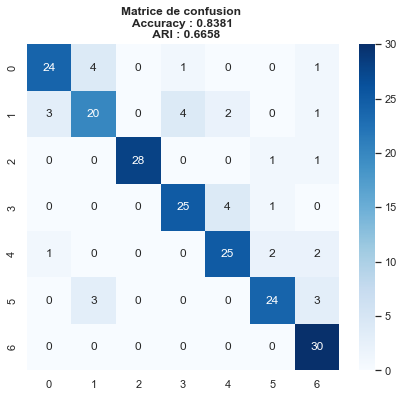

In [807]:
confusion_matrix_plot(categories_num[test_index], image_and_text_best_proba)

### VGG16 for features extraction

#### Extraction des features

In [808]:
from tensorflow.keras import datasets, layers, models

In [809]:
model = VGG16(weights='imagenet', include_top=True, input_shape=(224, 224, 3))

In [810]:
r = random.randint(0, len(images_directories))
image = load_img('Images/'+images_directories[r], target_size=(224, 224))
image = img_to_array(image)
image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
image = preprocess_input(image)
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)
features = model.predict(image)
features.shape

1/1 [==============================] - 1s 891ms/step


(1, 4096)

In [811]:
model.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [812]:
model = VGG16(weights='imagenet', include_top=True, input_shape=(224, 224, 3))
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)

In [813]:
vectors_image = np.empty((1, 4096))
for path in images_directories:
    image = load_img('images/'+path, target_size=(224, 224), interpolation="nearest", keep_aspect_ratio=False)
    image = img_to_array(image)
    image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
    image = preprocess_input(image)
    features = model(image, training=False)
    vectors_image = np.concatenate((vectors_image, features))
vectors_image = vectors_image[1:]
vectors_image.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/PIL/Image.py:2896: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


(1050, 4096)

#### Non supervisé

In [814]:
# nombre de composantes à calculer
pca_image = PCA(n_components=0.99, svd_solver='full')
pca_image.fit(vectors_image)

PCA(n_components=0.99, svd_solver='full')

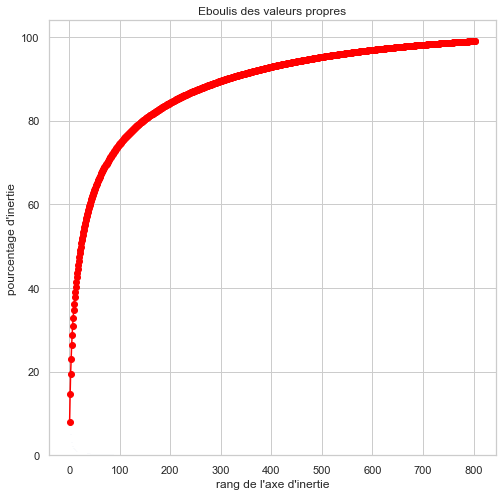

In [815]:
# Eboulis des valeurs propres
scree = pca_image.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

In [816]:
reduced_image = pd.DataFrame(pca_image.transform(vectors_image))
reduced_image.shape

(1050, 803)

In [817]:
ARI_score_images, Xtsne_images, labels_images, time_images = ARI_fct(reduced_image, 7, categories_num, 30, 2000)

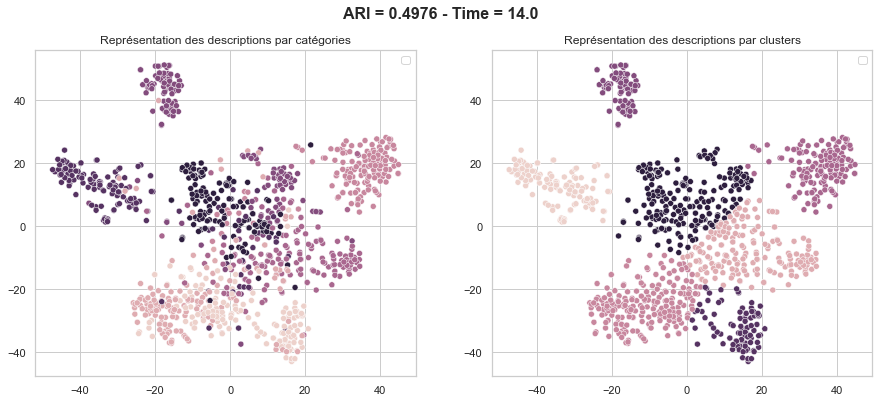

In [818]:
TSNE_visu_fct(ARI_score_images, Xtsne_images, labels_images, time_images, categories_num )

In [819]:
X_train_image, y_train_predict_image, y_train_image, ARI_train_image, X_test_image, y_test_predict_image, y_test_image, ARI_test_image = supervised_classification(pd.DataFrame(vectors_image), categories_num, LogisticRegression(dual=False))

score_train : 1.0
score_test : 0.8380952380952381


/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Precision : 0.838095238095238 
Recall : 0.8403633850062422


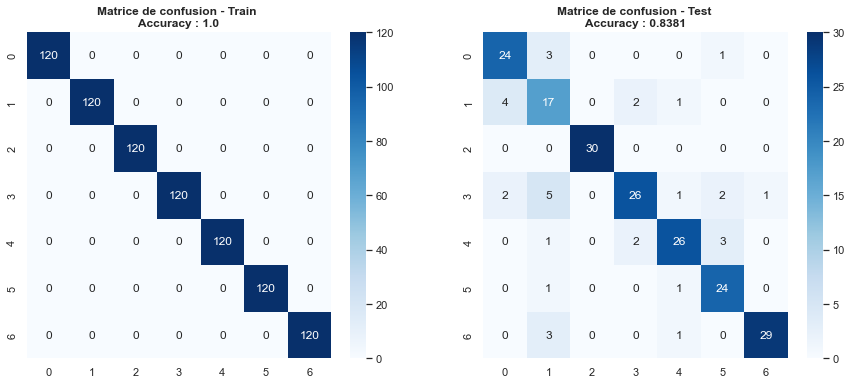

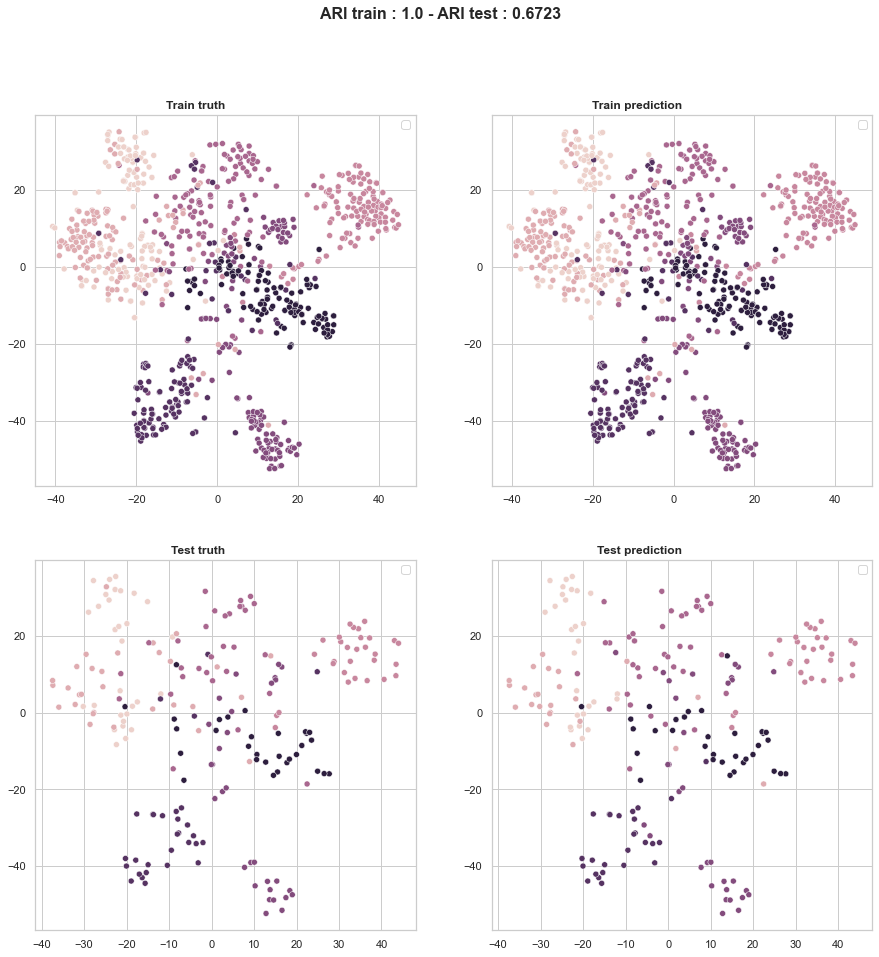

In [820]:
supervised_classification_visu_with_tsne(pd.DataFrame(vectors_image), X_train_image, y_train_predict_image, y_train_image, ARI_train_image, X_test_image, y_test_predict_image, y_test_image, ARI_test_image)

#### En ajoutant les bags of words Tfidf

In [821]:
vectors_image_df = pd.DataFrame(reduced_image)

In [822]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaler = scaler.fit(vectors_image_df)
scaler.transform(vectors_image_df)

array([[0.30153535, 0.66973898, 0.39843449, ..., 0.46844934, 0.68915076,
        0.62158622],
       [0.37056191, 0.80222698, 0.12716276, ..., 0.4338559 , 0.49677643,
        0.49278662],
       [0.31318997, 0.76946238, 0.29718912, ..., 0.37278673, 0.84041926,
        0.43608498],
       ...,
       [0.20421289, 0.61045495, 0.4118611 , ..., 0.460406  , 0.54753652,
        0.41508814],
       [0.23334054, 0.5604149 , 0.43000345, ..., 0.39602043, 0.59123551,
        0.43414851],
       [0.29153908, 0.62093607, 0.42502934, ..., 0.47948743, 0.51077681,
        0.48859861]])

In [823]:
vectors_image_text = np.concatenate((reduced_data.to_numpy(), vectors_image_df), axis=1)
vectors_image_text.shape

(1050, 1603)

In [824]:
# nombre de composantes à calculer
pca_image_text = PCA(n_components=0.99, svd_solver='full')
pca_image_text.fit(vectors_image_text)

PCA(n_components=0.99, svd_solver='full')

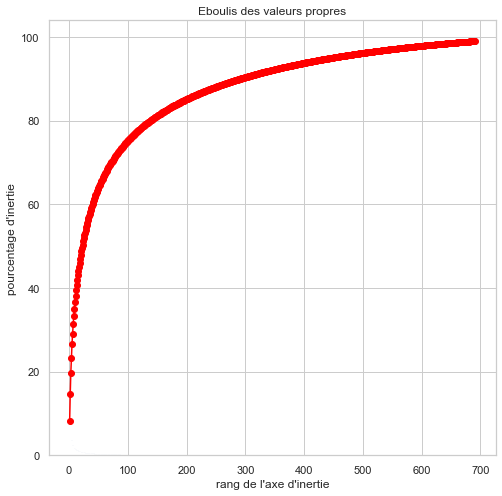

In [825]:
# Eboulis des valeurs propres
scree = pca_image_text.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

In [826]:
reduced_image_text = pd.DataFrame(pca_image_text.transform(vectors_image_text))
reduced_image_text.shape

(1050, 691)

In [827]:
ARI = []
for i in range(10):
    ARI_, Xtsne_, labels_, time_ = ARI_fct(pd.DataFrame(reduced_image_text), 7, categories_num, 30, 500+200*i)
    ARI += [ARI_]

<AxesSubplot:>

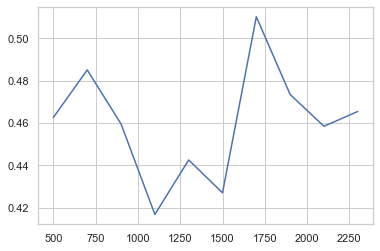

In [828]:
fig, ax = plt.subplots()
sns.lineplot(ax=ax, x=[500+200*i for i in range(10)], y=ARI)

In [829]:
ARI = []
for i in range(10):
    ARI_, Xtsne_, labels_, time_ = ARI_fct(pd.DataFrame(reduced_image_text), 7, categories_num, 20+2*i, 1700)
    ARI += [ARI_]

<AxesSubplot:>

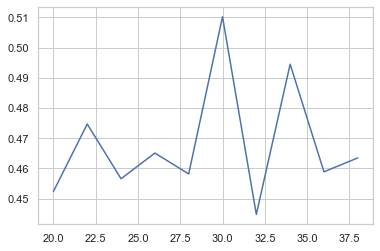

In [830]:
fig, ax = plt.subplots()
sns.lineplot(ax=ax, x=[20+2*i for i in range(10)], y=ARI)

In [831]:
ARI_score_image_text_reduced, Xtsne_image_text_reduced, labels_image_text_reduced, time_image_text_reduced = ARI_fct(reduced_image_text, 7, categories_num, 30, 1700)

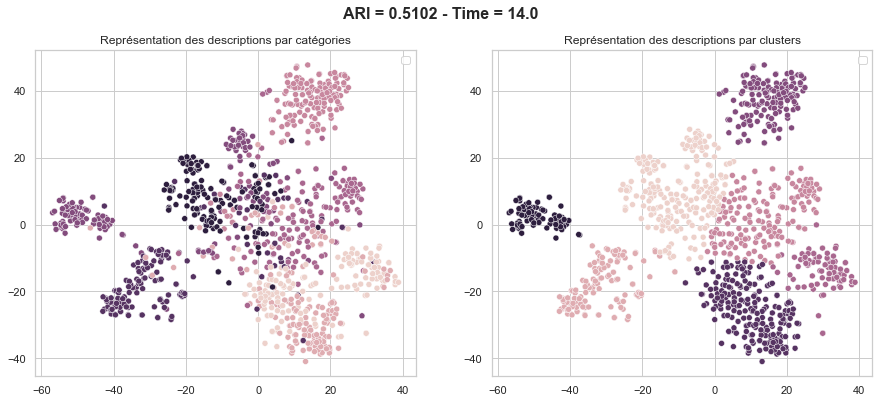

In [832]:
TSNE_visu_fct(ARI_score_image_text_reduced, Xtsne_image_text_reduced, labels_image_text_reduced, time_image_text_reduced, categories_num )

In [833]:
X_train_image_text, y_train_predict_image_text, y_train_image_text, ARI_train_image_text, \
X_test_image_text, y_test_predict_image_text, y_test_image_text, ARI_test_image_text = supervised_classification(pd.DataFrame(reduced_image_text), categories_num, LogisticRegression(dual=False))

score_train : 1.0
score_test : 0.8428571428571429


/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Precision : 0.8428571428571427 
Recall : 0.8459136564853443


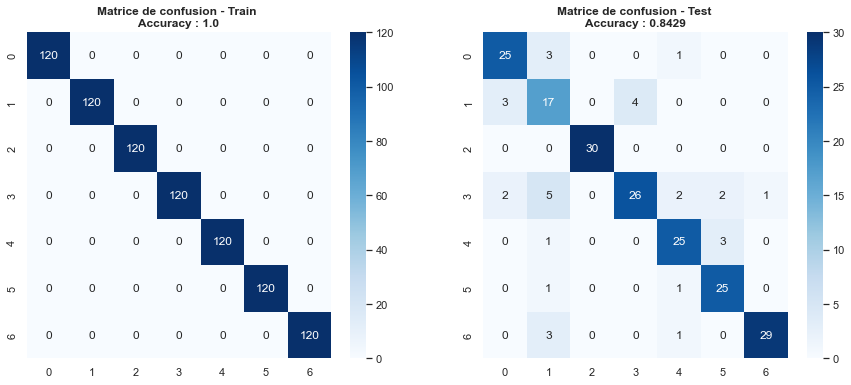

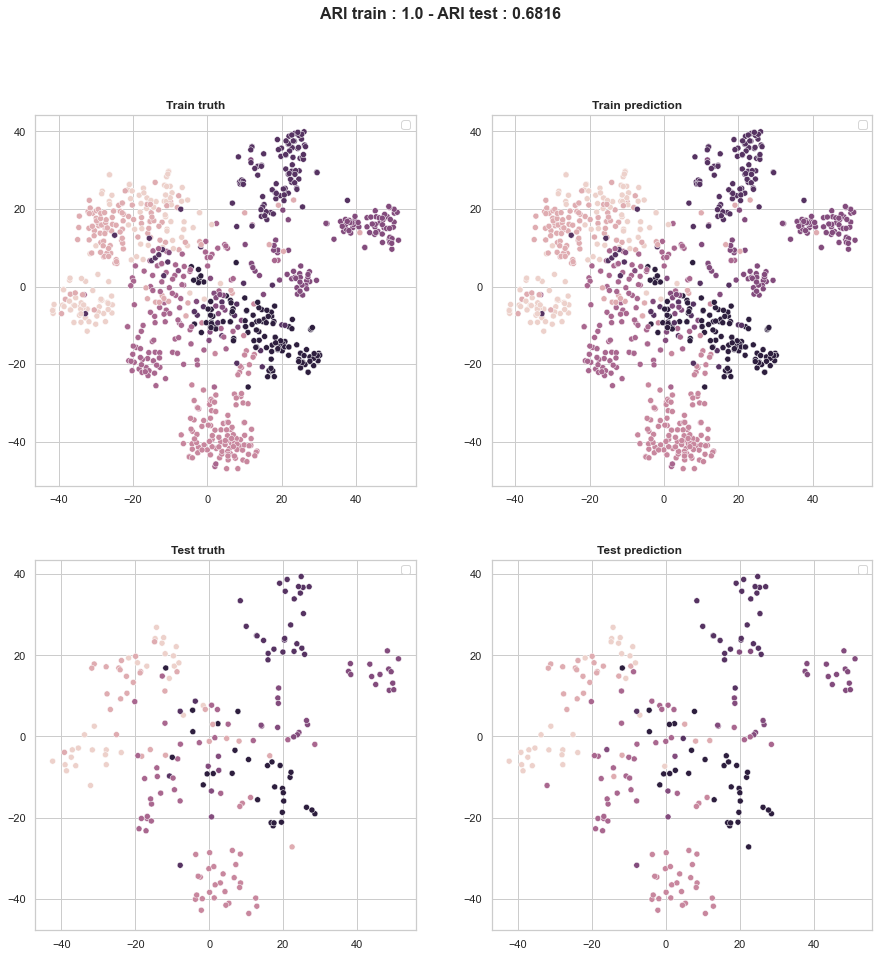

In [834]:
supervised_classification_visu_with_tsne(pd.DataFrame(reduced_image_text), X_train_image_text, y_train_predict_image_text, y_train_image_text, ARI_train_image_text,
X_test_image_text, y_test_predict_image_text, y_test_image_text, ARI_test_image_text)

## ResNetV2

In [835]:
from keras.applications import InceptionResNetV2
from keras.applications import inception_resnet_v2

In [836]:
model_ResNet = InceptionResNetV2(weights='imagenet', include_top=True)

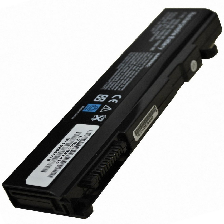

In [837]:
r = random.randint(0, len(images_directories))
img = load_img('Images/'+images_directories[r], target_size=(224, 224))
img

In [838]:
img = load_img('Images/'+images_directories[r], target_size=(299, 299))
img = img_to_array(img)  
img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))  
img = inception_resnet_v2.preprocess_input(img) 
yhat = model_ResNet.predict(img)
decode_predictions(yhat)

1/1 [==============================] - 6s 6s/step


[[('n03777754', 'modem', 0.50014466),
  ('n03492542', 'hard_disc', 0.36519095),
  ('n04041544', 'radio', 0.022836661),
  ('n02978881', 'cassette', 0.018497687),
  ('n03494278', 'harmonica', 0.01711778)]]

### Features extraction

In [839]:
model_ResNet = InceptionResNetV2(weights='imagenet', include_top=True)
model_ResNet = Model(inputs=model_ResNet.inputs, outputs=model_ResNet.layers[-2].output)

In [840]:
model_ResNet.output.shape

TensorShape([None, 1536])

In [841]:
vectors_image = np.empty((1, 1536))
for path in images_directories:
    image = load_img('images/'+path, target_size=(299, 299), interpolation="nearest", keep_aspect_ratio=False)
    image = img_to_array(image)
    image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
    image = inception_resnet_v2.preprocess_input(image) 
    features = model_ResNet(image, training=False)
    vectors_image = np.concatenate((vectors_image, features))
vectors_image = vectors_image[1:]
vectors_image.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/PIL/Image.py:2896: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


(1050, 1536)

In [842]:
# nombre de composantes à calculer
pca_image = PCA(n_components=0.99, svd_solver='full')
pca_image.fit(vectors_image)

PCA(n_components=0.99, svd_solver='full')

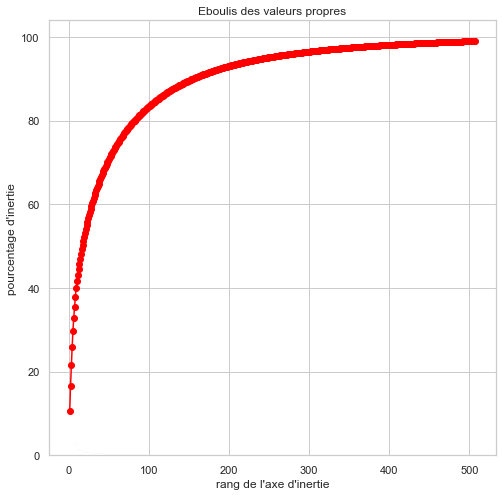

In [843]:
# Eboulis des valeurs propres
scree = pca_image.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

In [844]:
reduced_image = pd.DataFrame(pca_image.transform(vectors_image))
reduced_image.shape

(1050, 507)

In [845]:
ARI_score_images, Xtsne_images, labels_images, time_images = ARI_fct(reduced_image, 7, categories_num, 30, 800)

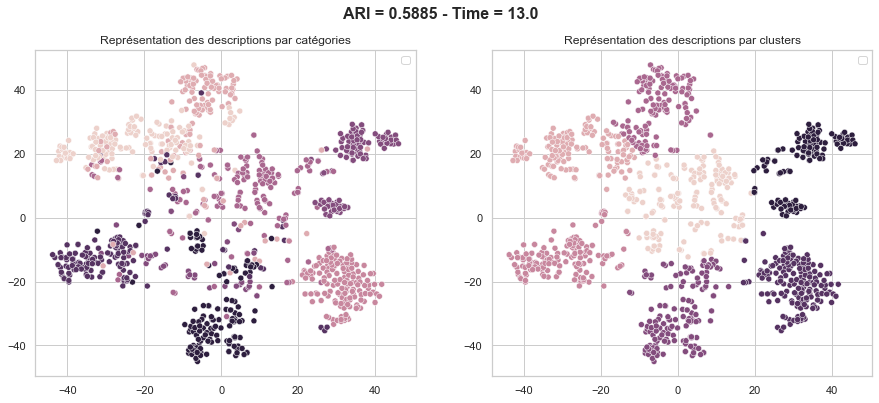

In [846]:
TSNE_visu_fct(ARI_score_images, Xtsne_images, labels_images, time_images, categories_num )

### En ajoutant les bags of Words Tfidf

In [847]:
vectors_image_df = pd.DataFrame(reduced_image)

In [848]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaler = scaler.fit(vectors_image_df)
scaler.transform(vectors_image_df)

array([[0.16278104, 0.44111257, 0.2807507 , ..., 0.26693255, 0.49818156,
        0.47246538],
       [0.15480738, 0.44242416, 0.33701687, ..., 0.62613848, 0.80800034,
        0.51256488],
       [0.25912871, 0.50967201, 0.2426208 , ..., 0.73364592, 0.59579303,
        0.51836771],
       ...,
       [0.2594101 , 0.45799868, 0.22238813, ..., 0.61296861, 0.53340488,
        0.62540015],
       [0.47438091, 0.5197196 , 0.28415578, ..., 0.32844023, 0.54053136,
        0.25853526],
       [0.38934175, 0.50150494, 0.36356536, ..., 0.54750051, 0.51262606,
        0.25167222]])

In [1045]:
pca = PCA(n_components=800, svd_solver='full')
pca.fit(tfidfvect_bis1)
reduced_data = pd.DataFrame(pca.transform(tfidfvect_bis1))
reduced_data.shape

(1050, 800)

In [1046]:
vectors_image_text = np.concatenate((reduced_data.to_numpy(), vectors_image_df), axis=1)
vectors_image_text.shape

(1050, 1307)

In [1047]:
# nombre de composantes à calculer
pca_image_text = PCA(n_components=0.99, svd_solver='full')
pca_image_text.fit(vectors_image_text)

PCA(n_components=0.99, svd_solver='full')

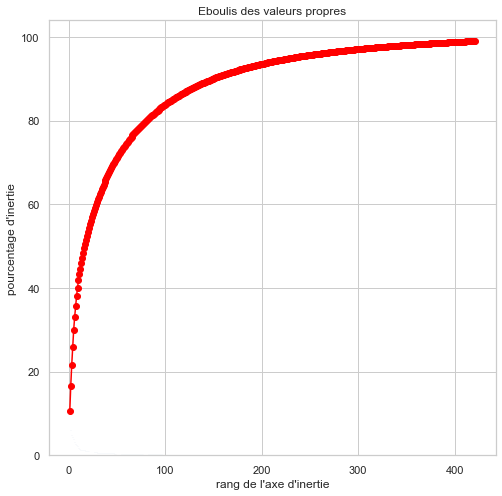

In [1048]:
# Eboulis des valeurs propres
scree = pca_image_text.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

In [1049]:
reduced_image_text = pd.DataFrame(pca_image_text.transform(vectors_image_text))
reduced_image_text.shape

(1050, 421)

In [854]:
ARI = []
for i in range(10):
    ARI_, Xtsne_, labels_, time_ = ARI_fct(pd.DataFrame(reduced_image_text), 7, categories_num, 30, 1100+200*i)
    ARI += [ARI_]

<AxesSubplot:>

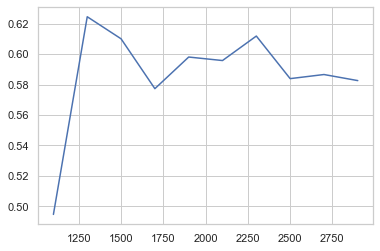

In [855]:
fig, ax = plt.subplots()
sns.lineplot(ax=ax, x=[1100+200*i for i in range(10)], y=ARI)

In [856]:
ARI = []
for i in range(10):
    ARI_, Xtsne_, labels_, time_ = ARI_fct(pd.DataFrame(reduced_image_text), 7, categories_num, 20+2*i, 1300)
    ARI += [ARI_]

<AxesSubplot:>

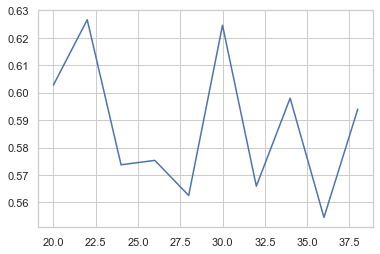

In [857]:
fig, ax = plt.subplots()
sns.lineplot(ax=ax, x=[20+2*i for i in range(10)], y=ARI)

In [1050]:
ARI_score_image_text_reduced, Xtsne_image_text_reduced, labels_image_text_reduced, time_image_text_reduced = ARI_fct(reduced_image_text, 7, categories_num, 22, 1300)

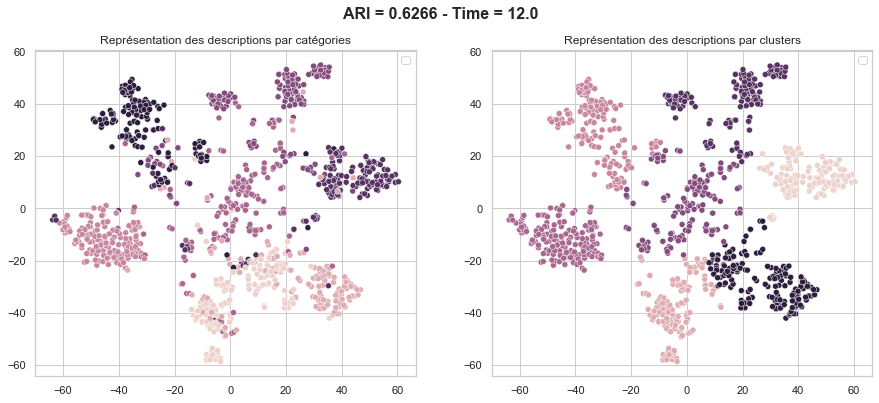

In [1051]:
TSNE_visu_fct(ARI_score_image_text_reduced, Xtsne_image_text_reduced, labels_image_text_reduced, time_image_text_reduced, categories_num )

In [1064]:
def change_label(x):
    if x == 0:
        x=1
    elif x == 1:
        x=6
    elif x == 2:
        x=3
    elif x == 3:
        x=4
    elif x == 4:
        x=5
    elif x == 5:
        x=0
    elif x == 6:
        x=2
    return x

In [1067]:
categories_num_changed = categories_num.apply(lambda x: change_label(x))

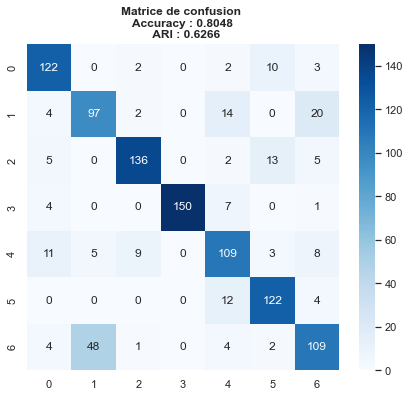

In [1066]:
confusion_matrix_plot(labels_image_text_reduced, categories_num_changed)

In [860]:
X_train_image_text, y_train_predict_image_text, y_train_image_text, ARI_train_image_text, \
X_test_image_text, y_test_predict_image_text, y_test_image_text, ARI_test_image_text = supervised_classification(pd.DataFrame(reduced_image_text), categories_num, LogisticRegression(dual=False))

score_train : 1.0
score_test : 0.8571428571428571


/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Precision : 0.8571428571428571 
Recall : 0.8598893406195637


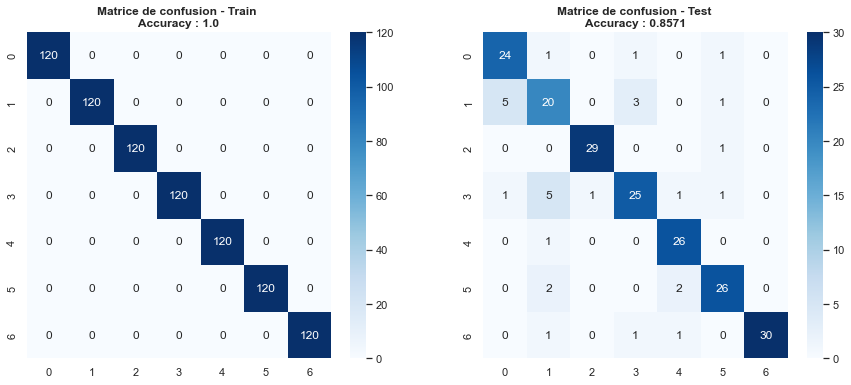

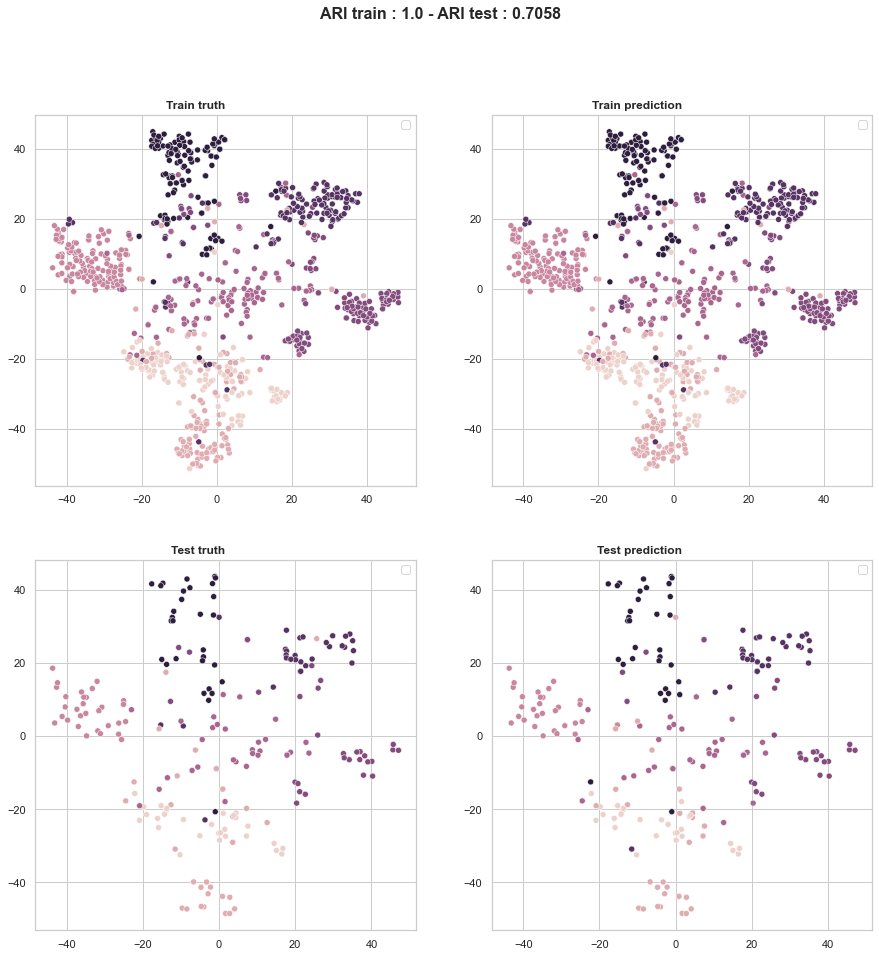

In [861]:
supervised_classification_visu_with_tsne(pd.DataFrame(reduced_image_text), X_train_image_text, y_train_predict_image_text, y_train_image_text, ARI_train_image_text,
X_test_image_text, y_test_predict_image_text, y_test_image_text, ARI_test_image_text)

# Images -  Pytorch

In [862]:
train_index = train_texts.index
test_index = test_texts.index
train_image_torch = images_directories[train_index].reset_index()
test_image_torch = images_directories[test_index].reset_index()
y_train_torch = categories_num[train_index]
y_test_torch = categories_num[test_index]

In [863]:
train_image_torch['label'] = y_train_torch.to_list()
train_image_torch = train_image_torch.loc[:, 'image':'label']
train_image_torch

,image,label
0,b19c9174113c2b9288157e14c48a8250.jpg,2
1,189fa66a5fa6f08d2802a62ecf0be298.jpg,2
2,41384da51732c0b4df3de8f395714fbb.jpg,2
3,6858fd9265d348803b18667fe43cd054.jpg,0
4,27175ea71cc5f2879882c77b9931cf8b.jpg,3
...,...,...
835,ad08a6efe82576ab162a9336feff647f.jpg,6
836,3f025b9dc8065fe5a155573e5b21a70d.jpg,4
837,73901494efea71869576898c68b5eee4.jpg,0
838,70461caa9038cfa34d109ea056d57f5a.jpg,1


In [864]:
train_image_torch.to_csv('train_torch_labels/train_annotations_file.csv', index=False)

In [865]:
import torch
import torchvision
from torch.utils.data import Dataset
from torchvision import datasets, transforms

In [866]:
data_transform = transforms.Compose([transforms.Resize(size=(299, 299)),  
                                     transforms.ToTensor()])

In [867]:
train_torch = datasets.ImageFolder(root='train_set/', transform=data_transform, target_transform=None)

In [868]:
test_torch = datasets.ImageFolder(root='test_set/', transform=data_transform, target_transform=None)

In [869]:
train_torch

Dataset ImageFolder
    Number of datapoints: 845
    Root location: train_set/
    StandardTransform
Transform: Compose(
               Resize(size=(299, 299), interpolation=bilinear, max_size=None, antialias=None)
               ToTensor()
           )

In [870]:
label_names = train_torch.classes
label_names

['0home furnishing',
 '1baby care',
 '2watches',
 '3home decor festive needs',
 '4kitchen dining',
 '5beauty and personal care',
 '6computers']

In [871]:
i = 241
img, label = train_torch[i][0], train_torch[i][1]
label

2

In [872]:
img.shape

torch.Size([3, 299, 299])

In [873]:
len(train_torch), len(train_torch.targets), len(test_torch), len(test_torch.targets)

(845, 845, 210, 210)

Original shape: torch.Size([3, 299, 299]) -> [color_channels, height, width]
Image permute shape: torch.Size([299, 299, 3]) -> [height, width, color_channels]


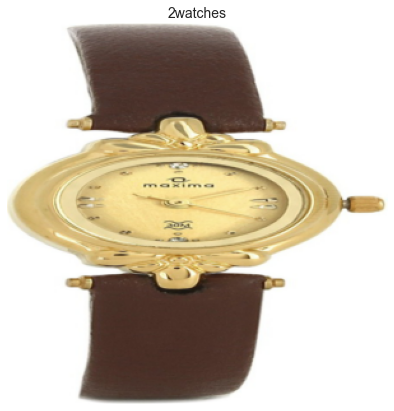

In [874]:
#Plot from tensor
img_permute = img.permute(1, 2, 0)

print(f"Original shape: {img.shape} -> [color_channels, height, width]")
print(f"Image permute shape: {img_permute.shape} -> [height, width, color_channels]")

plt.figure(figsize=(10, 7))
plt.imshow(img.permute(1, 2, 0))
plt.axis("off")
plt.title(label_names[label], fontsize=14);

In [875]:
from torch.utils.data import DataLoader

In [876]:
train_dataloader = DataLoader(dataset=train_torch, 
                              batch_size=30, 
                              num_workers=4, 
                              shuffle=True) 

In [877]:
test_dataloader = DataLoader(dataset=test_torch, 
                              batch_size=30, 
                              num_workers=4, 
                              shuffle=False) 

In [878]:
import os
os.environ["TOKENIZERS_PARALLELISM"] = "false"
train_features_batch, train_labels_batch = next(iter(train_dataloader))
train_features_batch.shape, train_labels_batch.shape

(torch.Size([30, 3, 299, 299]), torch.Size([30]))

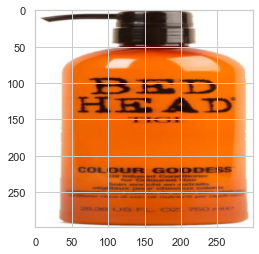

In [879]:
plt.imshow(train_features_batch[6].permute(1, 2, 0), cmap="gray")

In [880]:
from pathlib import Path
data_path_train = Path('train_set')
data_path_test = Path('test_set')

In [881]:
import glob
image_path_train_list = list(data_path_train.glob("*/*.jpg"))
image_path_test_list = list(data_path_test.glob("*/*.jpg"))

Random image path: test_set/6computers/146b0d570d5ab4e27629d48533b7680d.jpg
Image class: 6computers
Image height: 1092
Image width: 1100


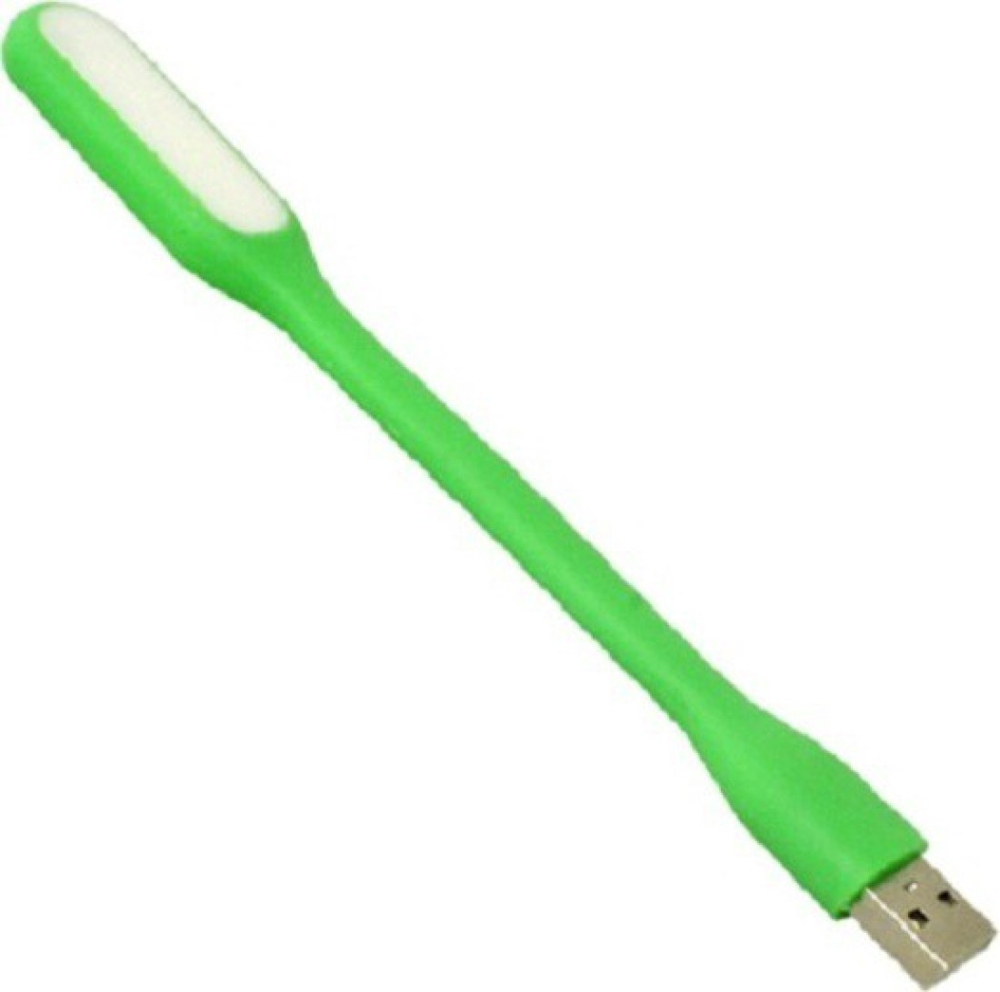

In [882]:
random_image_path = random.choice(image_path_test_list)
img = Image.open(random_image_path)
image_class = random_image_path.parent.stem
print(f"Random image path: {random_image_path}")
print(f"Image class: {image_class}")
print(f"Image height: {img.height}") 
print(f"Image width: {img.width}")
img

In [883]:
class_dict = train_torch.class_to_idx
class_dict

{'0home furnishing': 0,
 '1baby care': 1,
 '2watches': 2,
 '3home decor festive needs': 3,
 '4kitchen dining': 4,
 '5beauty and personal care': 5,
 '6computers': 6}

In [884]:
from torchinfo import summary

## EfficientNet_B0
### Couche fully connected modifiée

In [885]:
weights_effi = torchvision.models.EfficientNet_B0_Weights.DEFAULT 
model_effi = torchvision.models.efficientnet_b0(weights=weights_effi)

In [886]:
summary(model_effi, input_size=(32, 3, 224, 224))

Layer (type:depth-idx)                                  Output Shape              Param #
EfficientNet                                            [32, 1000]                --
├─Sequential: 1-1                                       [32, 1280, 7, 7]          --
│    └─Conv2dNormActivation: 2-1                        [32, 32, 112, 112]        --
│    │    └─Conv2d: 3-1                                 [32, 32, 112, 112]        864
│    │    └─BatchNorm2d: 3-2                            [32, 32, 112, 112]        64
│    │    └─SiLU: 3-3                                   [32, 32, 112, 112]        --
│    └─Sequential: 2-2                                  [32, 16, 112, 112]        --
│    │    └─MBConv: 3-4                                 [32, 16, 112, 112]        1,448
│    └─Sequential: 2-3                                  [32, 24, 56, 56]          --
│    │    └─MBConv: 3-5                                 [32, 24, 56, 56]          6,004
│    │    └─MBConv: 3-6                              

In [887]:
for param in model_effi.features.parameters():
    param.requires_grad = False

In [888]:
summary(model_effi, input_size=(32, 3, 224, 224))

Layer (type:depth-idx)                                  Output Shape              Param #
EfficientNet                                            [32, 1000]                --
├─Sequential: 1-1                                       [32, 1280, 7, 7]          --
│    └─Conv2dNormActivation: 2-1                        [32, 32, 112, 112]        --
│    │    └─Conv2d: 3-1                                 [32, 32, 112, 112]        (864)
│    │    └─BatchNorm2d: 3-2                            [32, 32, 112, 112]        (64)
│    │    └─SiLU: 3-3                                   [32, 32, 112, 112]        --
│    └─Sequential: 2-2                                  [32, 16, 112, 112]        --
│    │    └─MBConv: 3-4                                 [32, 16, 112, 112]        (1,448)
│    └─Sequential: 2-3                                  [32, 24, 56, 56]          --
│    │    └─MBConv: 3-5                                 [32, 24, 56, 56]          (6,004)
│    │    └─MBConv: 3-6                      

In [889]:
output_shape = 7
model_effi.classifier = torch.nn.Sequential(
    torch.nn.Dropout(p=0.2, inplace=True), 
    torch.nn.Linear(in_features=1280, 
                    out_features=output_shape, # same number of output units as our number of classes
                    bias=True))

In [890]:
summary(model_effi, input_size=(32, 3, 224, 224))

Layer (type:depth-idx)                                  Output Shape              Param #
EfficientNet                                            [32, 7]                   --
├─Sequential: 1-1                                       [32, 1280, 7, 7]          --
│    └─Conv2dNormActivation: 2-1                        [32, 32, 112, 112]        --
│    │    └─Conv2d: 3-1                                 [32, 32, 112, 112]        (864)
│    │    └─BatchNorm2d: 3-2                            [32, 32, 112, 112]        (64)
│    │    └─SiLU: 3-3                                   [32, 32, 112, 112]        --
│    └─Sequential: 2-2                                  [32, 16, 112, 112]        --
│    │    └─MBConv: 3-4                                 [32, 16, 112, 112]        (1,448)
│    └─Sequential: 2-3                                  [32, 24, 56, 56]          --
│    │    └─MBConv: 3-5                                 [32, 24, 56, 56]          (6,004)
│    │    └─MBConv: 3-6                      

In [891]:
loss_fn_effi = torch.nn.CrossEntropyLoss()
optimizer_effi = torch.optim.Adam(model_effi.parameters(), lr=0.001)

In [892]:
auto_transforms_effi = weights_effi.transforms()
auto_transforms_effi

ImageClassification(
    crop_size=[224]
    resize_size=[256]
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    interpolation=InterpolationMode.BICUBIC
)

In [893]:
train_torch_effi = datasets.ImageFolder(root='train_set/', transform=auto_transforms_effi, target_transform=None)
test_torch_effi = datasets.ImageFolder(root='test_set/', transform=auto_transforms_effi, target_transform=None)

In [894]:
label_names = test_torch_effi.classes
label_names

['0home furnishing',
 '1baby care',
 '2watches',
 '3home decor festive needs',
 '4kitchen dining',
 '5beauty and personal care',
 '6computers']

In [895]:
labels_dict = test_torch_effi.class_to_idx
labels_dict

{'0home furnishing': 0,
 '1baby care': 1,
 '2watches': 2,
 '3home decor festive needs': 3,
 '4kitchen dining': 4,
 '5beauty and personal care': 5,
 '6computers': 6}

In [896]:
train_dataloader_effi = DataLoader(dataset=train_torch_effi, 
                              batch_size=32, 
                              num_workers=4, 
                              shuffle=True) 

In [897]:
test_dataloader_effi = DataLoader(dataset=test_torch_effi, 
                              batch_size=32, 
                              num_workers=4, 
                              shuffle=False) 

In [898]:
def train_step(model: torch.nn.Module, 
               dataloader: torch.utils.data.DataLoader, 
               loss_fn: torch.nn.Module, 
               optimizer: torch.optim.Optimizer):
    model.train()
    train_loss, train_acc = 0, 0
    for batch, (X, y) in enumerate(dataloader):
        y_pred = model(X)
        loss = loss_fn(y_pred, y)
        train_loss += loss.item() 
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        y_pred_class = torch.argmax(torch.softmax(y_pred, dim=1), dim=1)
        train_acc += (y_pred_class == y).sum().item()/len(y_pred)

    train_loss = train_loss / len(dataloader)
    train_acc = train_acc / len(dataloader)
    return train_loss, train_acc

In [899]:
def test_step(model: torch.nn.Module, 
              dataloader: torch.utils.data.DataLoader, 
              loss_fn: torch.nn.Module):
    model.eval() 
    test_loss, test_acc = 0, 0
    with torch.inference_mode():
        for batch, (X, y) in enumerate(dataloader):
            test_pred_logits = model(X)
            loss = loss_fn(test_pred_logits, y)
            test_loss += loss.item()
            test_pred_labels = test_pred_logits.argmax(dim=1)
            test_acc += ((test_pred_labels == y).sum().item()/len(test_pred_labels))
    test_loss = test_loss / len(dataloader)
    test_acc = test_acc / len(dataloader)
    return test_loss, test_acc

In [900]:
from tqdm.auto import tqdm

def train(model: torch.nn.Module, 
          train_dataloader: torch.utils.data.DataLoader, 
          test_dataloader: torch.utils.data.DataLoader, 
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module = torch.nn.CrossEntropyLoss(),
          epochs: int = 5):
    
    results = {"train_loss": [],
               "train_acc": [],
               "test_loss": [],
               "test_acc": []}
    
    for epoch in tqdm(range(epochs)):
        train_loss, train_acc = train_step(model=model,
                                           dataloader=train_dataloader,
                                           loss_fn=loss_fn,
                                           optimizer=optimizer)
        test_loss, test_acc = test_step(model=model,
            dataloader=test_dataloader,
            loss_fn=loss_fn)
        
        print(
            f"Epoch: {epoch+1} | "
            f"train_loss: {train_loss:.4f} | "
            f"train_acc: {train_acc:.4f} | "
            f"test_loss: {test_loss:.4f} | "
            f"test_acc: {test_acc:.4f}")
        
        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)
        
    return results

In [901]:
#results = train(model=model_effi,
#                train_dataloader = train_dataloader_effi,
#                test_dataloader =  test_dataloader_effi, 
#                optimizer=optimizer_effi,
#                loss_fn=loss_fn_effi, 
#                epochs= 5)

In [902]:
#torch.save(obj=model_effi.state_dict(),f='my_EfficientNet_weights.pth')
#torch.save(model_effi, 'my_EfficientNet.pth')

In [903]:
#from helper_functions import plot_loss_curves
#plot_loss_curves(results)

In [904]:
from typing import List, Tuple

def pred_and_plot_image(model: torch.nn.Module,
                        image_path: str, 
                        class_names: List[str],
                        image_size: Tuple[int, int] = (224, 224),
                        transform: torchvision.transforms = None):
    
    img = Image.open(image_path)
    
    if transform is not None:
        image_transform = transform
    else:
        image_transform = transforms.Compose([
            transforms.Resize(image_size),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])])
    
    model.eval()
    with torch.inference_mode():
        transformed_image = image_transform(img).unsqueeze(dim=0)
        image_pred = model(transformed_image)
        image_pred_probs = torch.softmax(image_pred, dim=1)
        image_pred_label = torch.argmax(image_pred, dim=1)

    plt.figure()
    plt.imshow(img)
    plt.title(f"Pred: {class_names[image_pred_label]} | Prob: {image_pred_probs.max():.3f}")
    plt.axis(False);

In [905]:
#torch.save(obj=model_effi.state_dict(),f='my_EfficientNet_weights.pth')
#torch.save(model_effi, 'my_EfficientNet.pth')

In [906]:
loaded_model_image = torch.load('my_EfficientNet.pth')
loaded_model_image.eval()
summary(loaded_model_image, input_size=(32, 3, 224, 224))

Layer (type:depth-idx)                                  Output Shape              Param #
EfficientNet                                            [32, 7]                   --
├─Sequential: 1-1                                       [32, 1280, 7, 7]          --
│    └─Conv2dNormActivation: 2-1                        [32, 32, 112, 112]        --
│    │    └─Conv2d: 3-1                                 [32, 32, 112, 112]        (864)
│    │    └─BatchNorm2d: 3-2                            [32, 32, 112, 112]        (64)
│    │    └─SiLU: 3-3                                   [32, 32, 112, 112]        --
│    └─Sequential: 2-2                                  [32, 16, 112, 112]        --
│    │    └─MBConv: 3-4                                 [32, 16, 112, 112]        (1,448)
│    └─Sequential: 2-3                                  [32, 24, 56, 56]          --
│    │    └─MBConv: 3-5                                 [32, 24, 56, 56]          (6,004)
│    │    └─MBConv: 3-6                      

In [907]:
import glob
image_path_train_list = list(data_path_train.glob("*/*.jpg"))
image_path_test_list = list(data_path_test.glob("*/*.jpg"))

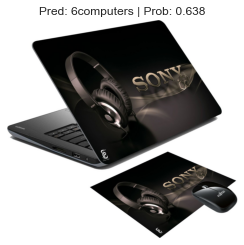

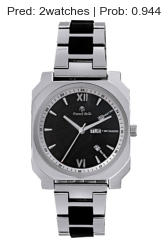

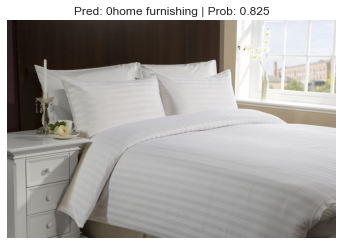

In [908]:
import random
num_images_to_plot = 3
image_path_test_sample = random.sample(population=image_path_test_list, k=num_images_to_plot) 

for image_path in image_path_test_sample:
    pred_and_plot_image(model=loaded_model_image, 
                        image_path=image_path,
                        class_names=label_names,
                        image_size=(224, 224))

In [909]:
test_class_dict = test_torch_effi.find_classes('test_set/')

In [910]:
def predict(model: torch.nn.Module,
                        image_path: str, 
                        class_names: List[str],
                        image_size: Tuple[int, int] = (224, 224),
                        transform: torchvision.transforms = None):
    
    img = Image.open(image_path)
    
    if transform is not None:
        image_transform = transform
    else:
        image_transform = transforms.Compose([
            transforms.Resize(image_size),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])])
    
    model.eval()
    with torch.inference_mode():
        transformed_image = image_transform(img).unsqueeze(dim=0)
        image_pred = model(transformed_image)
        image_pred_probs = torch.softmax(image_pred, dim=1)
        image_pred_label = torch.argmax(image_pred, dim=1)

    return class_names[image_pred_label], image_path.parent.stem

In [911]:
class_pred, class_true = predict(model=loaded_model_image,
           image_path=image_path_test_list[99],
           class_names=label_names,
           image_size=(224, 224))

In [912]:
class_pred, class_true

('5beauty and personal care', '5beauty and personal care')

In [913]:
def confusion_matrix_plot2(model: torch.nn.Module,
                        root: str, 
                        class_names: List[str],
                        image_size: Tuple[int, int] = (224, 224),
                        transform: torchvision.transforms = None):
    from sklearn.metrics import confusion_matrix
    image_path = list(Path(root).glob("*/*.jpg"))
    
    class_pred = []
    class_true = []
    for path in image_path:
        pred, truth = predict(model=model,
                        image_path=path, 
                        class_names=class_names,
                        image_size=image_size,
                        transform=transform)
        class_pred += [pred]
        class_true += [truth]
    fig, ax = plt.subplots(1, 1, figsize=(7,6))
    sns.heatmap(ax=ax, data=confusion_matrix(y_pred=class_pred, y_true=class_true, labels=label_names), annot=True, cmap='Blues')
    ax.set_title(f"Matrice de confusion  \n Precision : {precision_score (class_pred, class_true, average='macro')}", fontsize=12, weight='bold')
    return class_pred, class_true
    

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/PIL/Image.py:2896: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


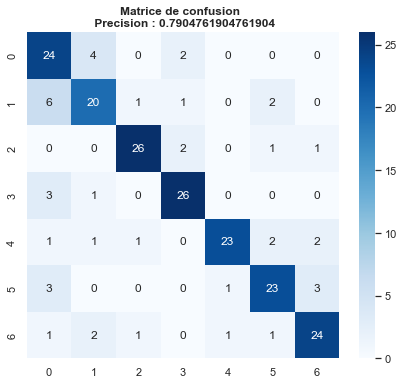

In [914]:
class_pred, class_true = confusion_matrix_plot2(model=loaded_model_image, 
                        root='test_set/',
                        class_names=label_names,
                        image_size=(224, 224))

In [915]:
text0 = pd.read_csv('flipkart_com-ecommerce_sample_1050.csv')

In [916]:
tokenizer_DistilBert = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
full_model_text = TFDistilBertForSequenceClassification.from_pretrained('clf')

Some layers from the model checkpoint at clf were not used when initializing TFDistilBertForSequenceClassification: ['dropout_176']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFDistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some layers of TFDistilBertForSequenceClassification were not initialized from the model checkpoint at clf and are newly initialized: ['dropout_153']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [917]:
def proba_predict(model: torch.nn.Module,
                        image_path: str, 
                        image_size: Tuple[int, int] = (224, 224),
                        transform: torchvision.transforms = None):
    
    img = Image.open(image_path)
    
    if transform is not None:
        image_transform = transform
    else:
        image_transform = transforms.Compose([
            transforms.Resize(image_size),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])])
    
    model.eval()
    with torch.inference_mode():
        transformed_image = image_transform(img).unsqueeze(dim=0)
        image_pred = model(transformed_image)
        image_pred_probs = torch.softmax(image_pred, dim=1)

    return image_pred_probs

In [918]:
def matrix_proba_predict(model: torch.nn.Module,
                        root: str, 
                        image_size: Tuple[int, int] = (224, 224),
                        transform: torchvision.transforms = None):
    image_path = list(Path(root).glob("*/*.jpg"))
    image_and_text = np.empty((1, 14))
    for path in image_path:
        proba = proba_predict(model=model,
                        image_path=path, 
                        image_size=image_size,
                        transform=transform).numpy()
        texte = ((text.loc[text['image']==path.name, 'description']).values[0] + ' ' +  (text.loc[text['image']==path.name, 'product_name']).values[0])
        text_token = tokenizer_DistilBert(texte,truncation=True,padding=True,return_tensors="tf")
        vect_text = tf.math.softmax(full_model_text(text_token).logits, axis=1).numpy()
        vect = np.concatenate((vect_text, proba), axis=1)
        image_and_text = np.concatenate((image_and_text, vect))
    return image_and_text[1:]

In [919]:
proba_pred = matrix_proba_predict(model=loaded_model_image, 
                        root='test_set/',
                        image_size=(224, 224))

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/PIL/Image.py:2896: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [920]:
image_path = list(Path('test_set').glob("*/*.jpg"))
images_categorie = pd.concat([categories_num, images_directories], axis=1)
list_categories = []
for path in image_path:
    cat = images_categorie.loc[images_categorie['image']==path.name, 'category1'].values[0]
    list_categories += [cat]
len(list_categories)

210

''

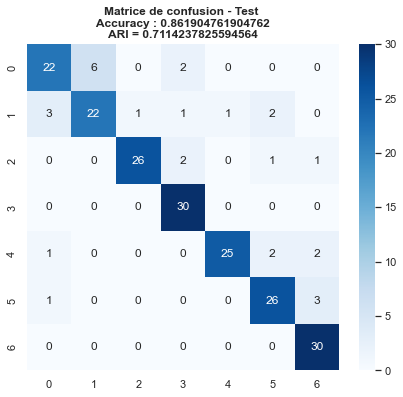

In [921]:
image_and_text_best_proba = np.max((np.argmax(proba_pred[:, :7], axis=1), np.argmax(proba_pred[:, 7:], axis=1)), axis=0)

fig, ax = plt.subplots(1, 1, figsize=(7,6))
sns.heatmap(ax=ax,  data=confusion_matrix(list_categories, image_and_text_best_proba), annot=True, cmap='Blues')

ax.set_title(f"Matrice de confusion - Test \n Accuracy : {accuracy_score(list_categories, image_and_text_best_proba)} \nARI = {adjusted_rand_score(list_categories, image_and_text_best_proba)}", fontsize=12, weight='bold')
;

### EfficientNet_BO as feature extractor

In [922]:
weights_effi2 = torchvision.models.EfficientNet_B0_Weights.DEFAULT 
model_effi2 = torchvision.models.efficientnet_b0(weights=weights_effi2)

In [923]:
for param in model_effi2.parameters():
    param.requires_grad = False

In [924]:
summary(model_effi2, input_size=(32, 3, 224, 224))

Layer (type:depth-idx)                                  Output Shape              Param #
EfficientNet                                            [32, 1000]                --
├─Sequential: 1-1                                       [32, 1280, 7, 7]          --
│    └─Conv2dNormActivation: 2-1                        [32, 32, 112, 112]        --
│    │    └─Conv2d: 3-1                                 [32, 32, 112, 112]        (864)
│    │    └─BatchNorm2d: 3-2                            [32, 32, 112, 112]        (64)
│    │    └─SiLU: 3-3                                   [32, 32, 112, 112]        --
│    └─Sequential: 2-2                                  [32, 16, 112, 112]        --
│    │    └─MBConv: 3-4                                 [32, 16, 112, 112]        (1,448)
│    └─Sequential: 2-3                                  [32, 24, 56, 56]          --
│    │    └─MBConv: 3-5                                 [32, 24, 56, 56]          (6,004)
│    │    └─MBConv: 3-6                      

In [925]:
def features_extract(model: torch.nn.Module,
                        image_path: str, 
                        image_size: Tuple[int, int] = (224, 224),
                        transform: torchvision.transforms = None):
    
    img = Image.open(image_path)
    
    if transform is not None:
        image_transform = transform
    else:
        image_transform = transforms.Compose([
            transforms.Resize(image_size),
            transforms.ToTensor()])
    
    model.eval()
    with torch.inference_mode():
        transformed_image = image_transform(img).unsqueeze(dim=0)
        image_pred = model(transformed_image)

    return image_pred

In [926]:
def bag_of_visual_words(model: torch.nn.Module,
                        root: str, 
                        image_size: Tuple[int, int] = (224, 224),
                        transform: torchvision.transforms = None):
    image_path = list(Path(root).glob("*.jpg"))
    
    BOVWs = []
    for path in image_path:
        BOVW = features_extract(model=model,
                                image_path=path,
                                image_size=image_size,
                                transform=transform)
        BOVWs += [BOVW]
    return BOVWs

In [927]:
import glob
image_path_train_list = list(data_path_train.glob("*/*.jpg"))
image_path_test_list = list(data_path_test.glob("*/*.jpg"))
image_path_list = list(Path('Images').glob("*.jpg"))
image_path_list[0].name

'aa68675f50a0551b8dadb954017a50a1.jpg'

In [928]:
transform_effi2 = weights_effi2.transforms()

In [929]:
BOVW = bag_of_visual_words(model=model_effi2, 
                           root='Images/',
                           image_size=(224, 224),
                          transform=transform_effi2)

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/PIL/Image.py:2896: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [930]:
max([BOVW[i].max() for i in range(1050)])

tensor(14.8914)

In [931]:
tfidfvect_bis.shape

(1050, 347)

In [932]:
tfidfvect_bis.max().max()

0.9089814400889487

In [933]:
data_BOVW = [BOVW[i].numpy().flatten() for i in range(1050)]

In [934]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaler = scaler.fit(data_BOVW)
data_BOVW_scaled = scaler.transform(data_BOVW)
data_BOVW_scaled

array([[0.49944283, 0.41193459, 0.3861729 , ..., 0.87204207, 0.61998352,
        0.33503548],
       [0.46130759, 0.29403305, 0.93133494, ..., 0.61839451, 0.32638734,
        0.38572101],
       [0.4897049 , 0.5161128 , 0.64031708, ..., 0.33557368, 0.37785904,
        0.45583478],
       ...,
       [0.56738163, 0.39501845, 0.52583254, ..., 0.24116178, 0.23047793,
        0.33728239],
       [0.56701622, 0.26555945, 0.54555699, ..., 0.47184272, 0.31075189,
        0.52042181],
       [0.32458143, 0.82081241, 0.80415874, ..., 0.23840971, 0.33799012,
        0.31414172]])

In [935]:
BOVW_df = pd.DataFrame(index=[image_path_list[i].name for i in range(1050)], data=data_BOVW_scaled)

In [936]:
BOVW_df

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
aa68675f50a0551b8dadb954017a50a1.jpg,0.499443,0.411935,0.386173,0.335629,0.381625,0.617004,0.468642,0.567621,0.423560,0.561393,...,0.276639,0.569314,0.343522,0.514952,0.403877,0.644711,0.313315,0.872042,0.619984,0.335035
037c2402fee39fbc80433935711d1383.jpg,0.461308,0.294033,0.931335,0.654892,0.641730,0.625396,0.477704,0.539888,0.465722,0.163158,...,0.483593,0.504724,0.322907,0.473143,0.473516,0.714295,0.242210,0.618395,0.326387,0.385721
42643c1c9403f67921a18654bcf45ead.jpg,0.489705,0.516113,0.640317,0.540799,0.419522,0.606735,0.337977,0.443132,0.529968,0.515409,...,0.304533,0.322322,0.197085,0.477547,0.218828,0.481947,0.211324,0.335574,0.377859,0.455835
53f4bc7d7321f5c41de6b86e41f13e80.jpg,0.483000,0.153100,0.355109,0.230991,0.274368,0.477145,0.604519,0.423617,0.487828,0.521156,...,0.520262,0.397290,0.230700,0.310897,0.231003,0.293466,0.403623,0.178611,0.260385,0.168527
b144a363c107c7bdd91f32d6e28ba6f2.jpg,0.554969,0.453032,0.568295,0.414300,0.572543,0.479194,0.381270,0.380429,0.550146,0.433029,...,0.360665,0.491636,0.481031,0.595500,0.550047,0.713173,0.348591,0.699159,0.220856,0.217394
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4e5ebfc871992e7e22365c0c036a1b89.jpg,0.605270,0.352152,0.471694,0.487285,0.600052,0.793946,0.594017,0.480373,0.426922,0.429981,...,0.466475,0.198456,0.581676,0.499517,0.357106,0.245795,0.320229,0.687112,0.332732,0.430402
82fbc93cd45ab747e7e606f2c52c7335.jpg,0.506463,0.256511,0.389007,0.328065,0.506836,0.727986,0.521577,0.508787,0.406583,0.413211,...,0.284153,0.268134,0.224032,0.391334,0.435222,0.273566,0.255687,0.479779,0.258890,0.272414
216c6c3527984be3d7ad9023d5cd9bd1.jpg,0.567382,0.395018,0.525833,0.386271,0.346286,0.509452,0.365920,0.732480,0.548387,0.827214,...,0.469079,0.396437,0.216474,0.154479,0.408042,0.724830,0.193279,0.241162,0.230478,0.337282
f54d0c5cbd8e2270742293edf9075cb1.jpg,0.567016,0.265559,0.545557,0.441528,0.352683,0.699144,0.685702,0.483103,0.646848,0.529052,...,0.240949,0.347810,0.216864,0.633519,0.298020,0.344688,0.344371,0.471843,0.310752,0.520422


In [937]:
BOW = tfidfvect_bis.copy()
BOW.index = text['image']

In [938]:
BOW

,abstract,adapt,adida,akup,almond,analog,anim,antiqu,appl,archi,...,window,wireless,women,wood,wooden,work,wrap,yardley,year,yellow
image,,,,,,,,,,,,,,,,,,,,,
55b85ea15a1536d46b7190ad6fff8ce7.jpg,0.201836,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0000,0.000000
7b72c92c2f6c40268628ec5f14c6d590.jpg,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.063680,0.0,0.0,0.0,0.0,0.0,0.0000,0.186572
64d5d4a258243731dc7bbb1eef49ad74.jpg,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.032586,0.0,0.0,0.0,0.0,0.0,0.0602,0.000000
d4684dcdc759dd9cdf41504698d737d8.jpg,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0000,0.000000
6325b6870c54cd47be6ebfbffa620ec7.jpg,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
958f54f4c46b53c8a0a9b8167d9140bc.jpg,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0000,0.000000
fd6cbcc22efb6b761bd564c28928483c.jpg,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0000,0.000000
5912e037d12774bb73a2048f35a00009.jpg,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0000,0.000000


In [939]:
bag_of_features = BOW.merge(BOVW_df, left_index=True, right_index=True)

In [940]:
bag_of_features.shape

(1050, 1347)

In [941]:
pca = PCA(n_components=0.99, svd_solver='full')
pca.fit(bag_of_features)

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


PCA(n_components=0.99, svd_solver='full')

In [942]:
# On transforme tfidfvect_bis en projetant sur les 800 premières directions
reduced_data = pd.DataFrame(pca.transform(bag_of_features))
reduced_data.shape

/opt/anaconda3/envs/text_image/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


(1050, 579)

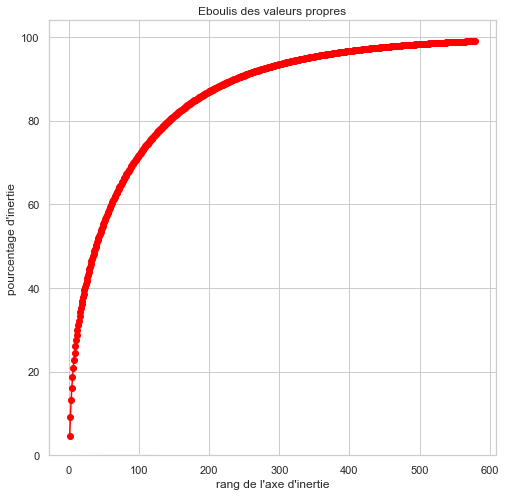

In [943]:
# Eboulis des valeurs propres
scree = pca.explained_variance_ratio_*100
fig, ax = plt.subplots(figsize=(8, 8))
ax = plt.bar(np.arange(len(scree))+1, scree)
ax = plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
ax = plt.xlabel("rang de l'axe d'inertie")
ax = plt.ylabel("pourcentage d'inertie")
ax = plt.title("Eboulis des valeurs propres")

<AxesSubplot:xlabel='0', ylabel='1'>

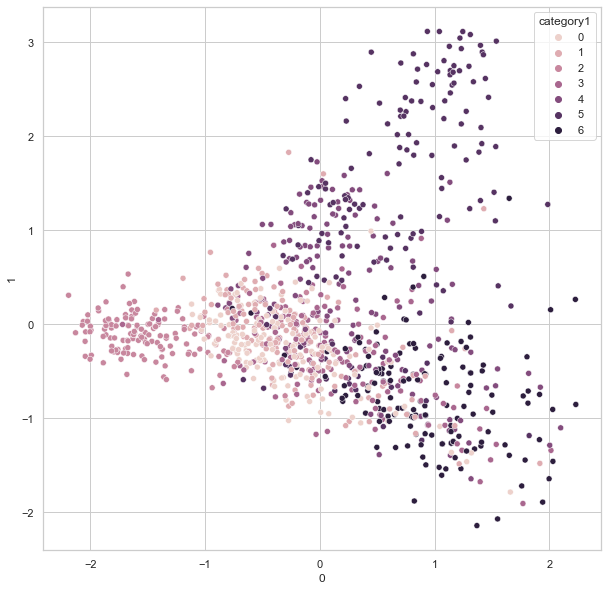

In [944]:
fig, ax = plt.subplots(figsize=(10, 10))
sns.scatterplot(x=reduced_data[0], y=reduced_data[1], hue=categories_num)

In [945]:
ARI_score_image_text, Xtsne_image_text, labels_image_text, time_image_text = ARI_fct(reduced_data, 
                                                                                     nb_clusters, 
                                                                                     categories_num, 30, 2500)

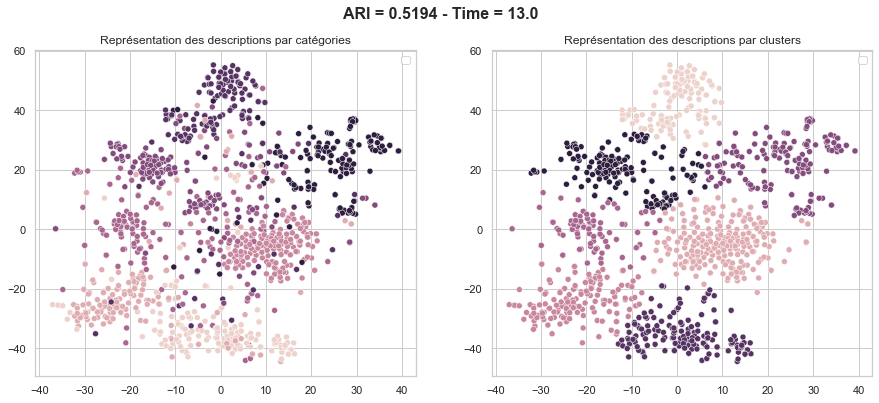

In [946]:
TSNE_visu_fct(ARI_score_image_text, Xtsne_image_text, labels_image_text, time_image_text, categories_num )

In [947]:
X_train_text_image_effi, y_train_predict_text_image_effi, y_train_text_image_effi, ARI_train_text_image_effi, X_test_text_image_effi, y_test_predict_text_image_effi, y_test_text_image_effi, ARI_test_text_image_effi = supervised_classification(reduced_data, 
                                                                                                                                            categories_num, 
                                                                                                                                            LogisticRegression(dual=False))

score_train : 0.9976190476190476
score_test : 0.8333333333333334


Precision : 0.8333333333333334 
Recall : 0.8408281166637656


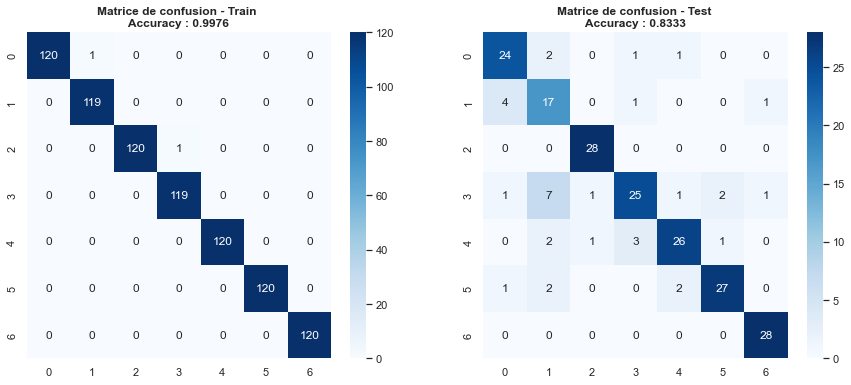

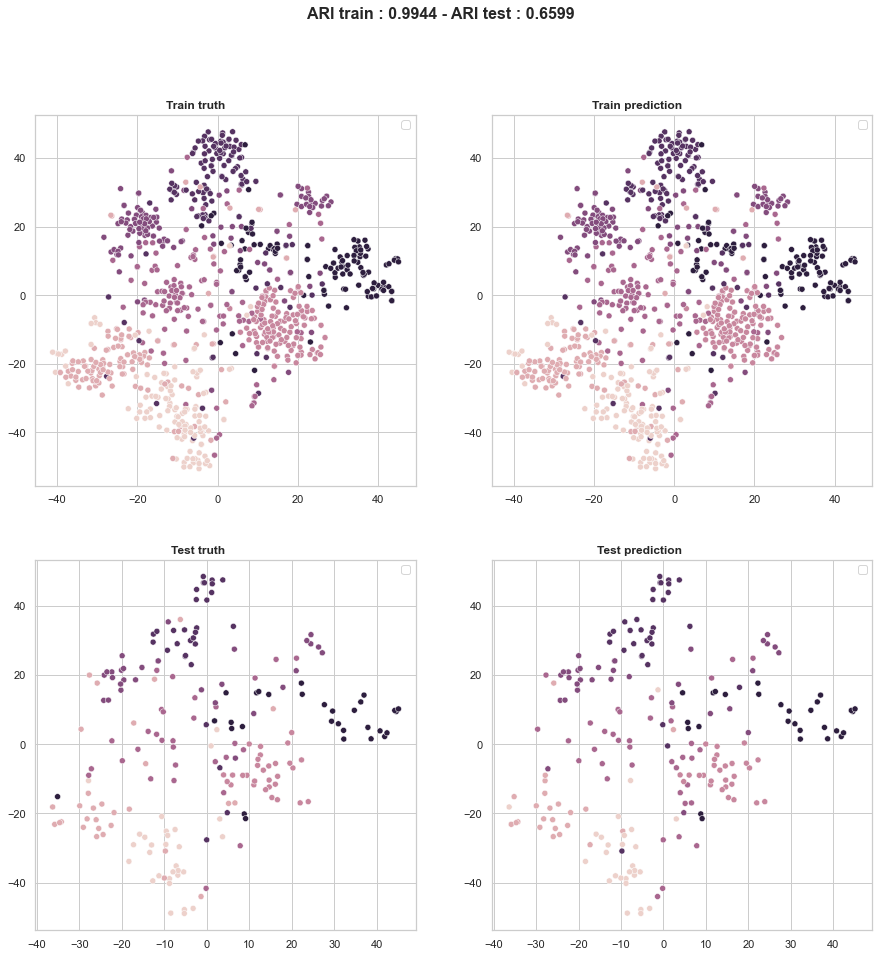

In [948]:
supervised_classification_visu_with_tsne(reduced_data, 
                                         X_train_text_image_effi, 
                                         y_train_predict_text_image_effi, 
                                         y_train_text_image_effi, 
                                         ARI_train_text_image_effi, 
                                         X_test_text_image_effi, 
                                         y_test_predict_text_image_effi, 
                                         y_test_text_image_effi, 
                                         ARI_test_text_image_effi)